# Object Detection and Analysis - License Plates of Algeria Dataset

## Description
Briefly analyze and explore the License Plates of Algeria dataset to extract key insights and prepare for object detection.

## Table of Contents
1. [Abstract](#abstract)
2. [Introduction & Background](#introduction-and-background)
3. [Imports](#imports)
4. [Data to Explore](#data-to-explore)
5. [Analysis Cells](#analysis-cells)
6. [Conclusion](#conclusion)
7. [References](#references)

## Abstract
Provide a concise summary of the exploration results and highlight key conclusions.

## Introduction & Background
Put the task into context, discuss the significance, and provide relevant information about the dataset and its purpose.

## Import Libraries

In [419]:
import os                     # Operating system dependent functionality
import cv2                    # OpenCV library for computer vision tasks
import csv                    # CSV file handling
import random                 # Random number generation and operations
import shutil                 # File operations (copy, move, remove)
import pytesseract            # Python wrapper for Tesseract OCR engine
import numpy as np            # Numerical operations with arrays and matrices
import pandas as pd           # Data manipulation and analysis library
from math import ceil        # Math module providing mathematical functions
from PIL import Image        # Python Imaging Library for image processing
import seaborn as sns         # Statistical data visualization based on matplotlib
from pytesseract import Output  # Additional constants for pytesseract
from scipy.stats import zscore   # Z-score normalization from SciPy library
import matplotlib.pyplot as plt  # Plotting library for data visualization
import matplotlib.image as mpimg  # Handling image data for matplotlib
import xml.etree.ElementTree as ET  # XML parsing and manipulation
import matplotlib.patches as patches  # Drawing shapes and patches in matplotlib
from pyod.models.iforest import IForest  # Implementation of Isolation Forest algorithm
from sklearn.ensemble import IsolationForest  # Implementation of Isolation Forest algorithm from scikit-learn
from sklearn.neighbors import NearestNeighbors  # Implementation of k-nearest neighbors algorithm
from PIL import Image, ImageEnhance, ImageFilter  # Additional image processing functionality from PIL
from sklearn.neighbors import LocalOutlierFactor  # Implementation of Local Outlier Factor algorithm

## Data Exploration

### Load and Display Sample Images

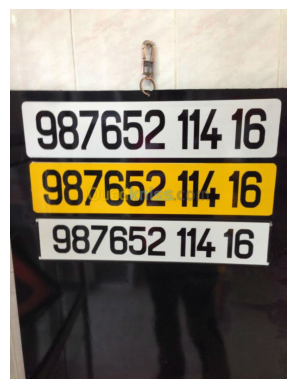

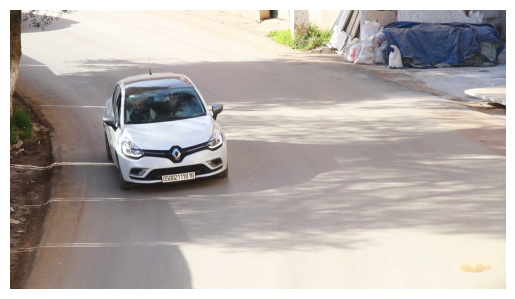

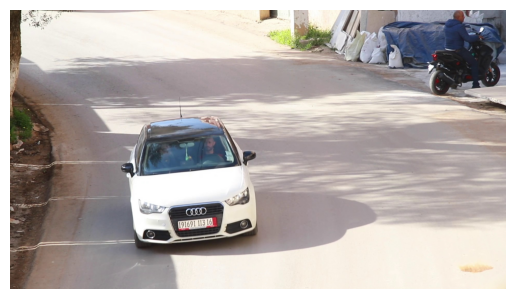

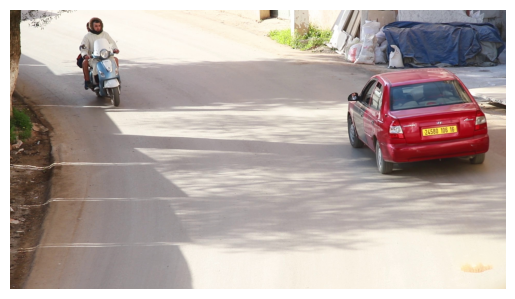

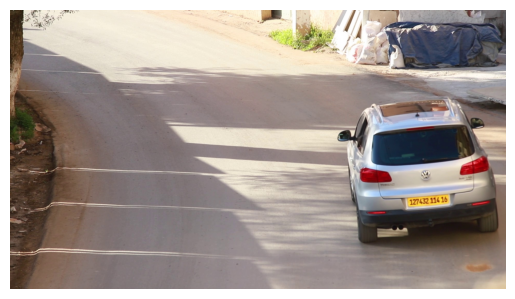

In [209]:
images_folder =  "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# Display sample images
def display_samples(folder_path, num_samples=5):
    images = os.listdir(folder_path)[:num_samples]

    for img in images:
        img_path = os.path.join(folder_path, img)
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        plt.imshow(image)
        plt.axis("off")
        plt.show()

# Display samples from the dataset
display_samples(images_folder)

### Explore Annotations 

In [210]:
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# Display content of an annotation file
sample_annotation_file = os.path.join(labels_folder, os.listdir(labels_folder)[0])

with open(sample_annotation_file, 'r') as f:
    content = f.read()

print(content)


3
26 217 662 367
41 368 654 509
62 509 644 632



### Convert the annotations from .txt files to csv file

In [211]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# List of all image files in the directory
image_files = [file for file in os.listdir(images_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

# Build the complete list of image paths
image_paths = [os.path.join(images_folder, file) for file in image_files]

# Load the images
images = [cv2.imread(path) for path in image_paths]

# Full path to the directory containing the label files
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# List of all label files in the directory
label_files = [file for file in os.listdir(labels_folder) if file.lower().endswith('.txt')]

# Create a CSV file
csv_filename = "imageslabels.csv"
csv_path = os.path.join(images_folder, csv_filename)

# Write information to the CSV file
with open(csv_path, 'w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["image name", "xmin", "ymin", "xmax", "ymax", "class label"])

    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as label_file_content:
            lines = label_file_content.readlines()

        # Check if there are enough lines for both class label and coordinates
        if len(lines) >= 2:
            class_label = lines[0].strip()
            for coordinates in lines[1:]:
                coords = coordinates.strip().split()

                # Check if there are enough values for coordinates
                if len(coords) == 4:
                    xmin, ymin, xmax, ymax = map(int, coords)
                    csv_writer.writerow([label_file.replace('.txt', '.jpg'), xmin, ymin, xmax, ymax, class_label])

print(f"Coordinates and class labels have been saved to: {csv_path}")

Coordinates and class labels have been saved to: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003\imageslabels.csv


### Read csv file

In [212]:

csv_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003/imageslabels.csv"

df = pd.read_csv(csv_path)

df

,image name,xmin,ymin,xmax,ymax,class label
0,0.jpg,26,217,662,367,3
1,0.jpg,41,368,654,509,3
2,0.jpg,62,509,644,632,3
3,0220.jpg,586,624,719,670,1
4,0297.jpg,645,799,806,854,1
...,...,...,...,...,...,...
2436,sqqqqqqqqqqqq.jpg,552,372,769,439,1
2437,ssdsdsfffff.jpg,3,35,1200,311,1
2438,swdwfsdf.jpg,341,493,633,569,1
2439,tyyyty.jpg,478,279,564,305,1


### Add additional columns

In [213]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# List of all image files in the directory
image_files = [file for file in os.listdir(images_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

# Build the complete list of image paths
image_paths = [os.path.join(images_folder, file) for file in image_files]

# Load the images
images = [cv2.imread(path) for path in image_paths]

# Full path to the directory containing the label files
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# List of all label files in the directory
label_files = [file for file in os.listdir(labels_folder) if file.lower().endswith('.txt')]

# Create a CSV file
csv_filename = "imageslabels_additional.csv"
csv_path = os.path.join(images_folder, csv_filename)

# Write information to the CSV file
with open(csv_path, 'w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["image name", "image path", "image size", "image height", "image width", "xmin", "ymin", "xmax", "ymax", "class label",
                         "object size ", "object area", "bounding box area", "bounding box aspect ratio", "object type", "subcategory", "image format"])

    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as label_file_content:
            lines = label_file_content.readlines()

        # Check if there are enough lines for both class label and coordinates
        if len(lines) >= 2:
            class_label = lines[0].strip()
            for coordinates in lines[1:]:
                coords = coordinates.strip().split()

                # Check if there are enough values for coordinates
                if len(coords) == 4:
                    xmin, ymin, xmax, ymax = map(int, coords)

                    # Replace placeholders with actual values
                    image_name = label_file.replace('.txt', '.jpg')
                    image_path = os.path.join(images_folder, image_name)
                    image_size = os.path.getsize(image_path)
                    image_height, image_width = images[image_files.index(image_name)].shape[:2]

                    # Calculate additional attributes
                    object_size_pixels = (xmax - xmin) * (ymax - ymin)
                    object_area = object_size_pixels / (image_height * image_width)
                    bounding_box_area = (xmax - xmin) * (ymax - ymin)
                    bounding_box_aspect_ratio = (xmax - xmin) / (ymax - ymin)
                    # Placeholder values for object type and subcategory (replace with actual values)
                    object_type = "car"  
                    subcategory = "number_plate" 
                    
                    # Placeholder value for image format (replace with actual value)
                    image_format = image_name.split('.')[-1].lower()  # Extract image format from the file name
                    
                    # Write to CSV
                    csv_writer.writerow([image_name, image_path, image_size, image_height, image_width, xmin, ymin, xmax, ymax, class_label,
                                     object_size_pixels, object_area, bounding_box_area, bounding_box_aspect_ratio, object_type, subcategory, image_format])

print(f"Coordinates and additional attributes have been saved to: {csv_path}")

Coordinates and additional attributes have been saved to: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003\imageslabels_additional.csv


### Read csv file

In [214]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "imageslabels_additional.csv")

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Display the DataFrame
df

,image name,image path,image size,image height,image width,xmin,ymin,xmax,ymax,class label,object size,object area,bounding box area,bounding box aspect ratio,object type,subcategory,image format
0,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,26,217,662,367,3,95400,0.156457,95400,4.240000,car,number_plate,jpg
1,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,41,368,654,509,3,86433,0.141751,86433,4.347518,car,number_plate,jpg
2,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,62,509,644,632,3,71586,0.117402,71586,4.731707,car,number_plate,jpg
3,0220.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,441714,1080,1920,586,624,719,670,1,6118,0.002950,6118,2.891304,car,number_plate,jpg
4,0297.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,414237,1080,1920,645,799,806,854,1,8855,0.004270,8855,2.927273,car,number_plate,jpg
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2436,sqqqqqqqqqqqq.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,166821,674,1200,552,372,769,439,1,14539,0.017976,14539,3.238806,car,number_plate,jpg
2437,ssdsdsfffff.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,121300,673,1200,3,35,1200,311,1,330372,0.409079,330372,4.336957,car,number_plate,jpg
2438,swdwfsdf.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,115489,674,1200,341,493,633,569,1,22192,0.027438,22192,3.842105,car,number_plate,jpg
2439,tyyyty.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,36004,450,800,478,279,564,305,1,2236,0.006211,2236,3.307692,car,number_plate,jpg


### Verify some annotations with their corresponding car images

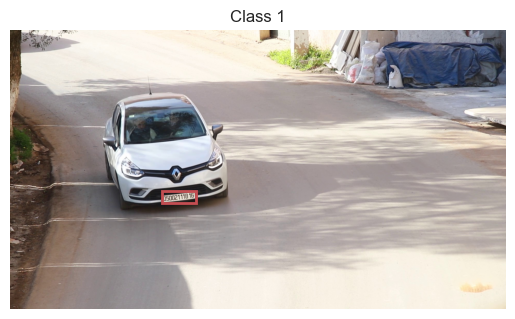

In [215]:
def visualize_bounding_box(image_path, xmin, ymin, xmax, ymax, class_label):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Create a figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    # Create a Rectangle patch
    rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none', label=f'Class {class_label}')

    # Add the rectangle to the Axes
    ax.add_patch(rect)

    # Set axis properties
    ax.axis('off')
    ax.set_title(f'Class {class_label}')

    # Show the plot
    plt.show()

# Example usage:
image_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003/0220.jpg"
xmin, ymin, xmax, ymax = 586, 624, 719, 670  
class_label = 1 

visualize_bounding_box(image_path, xmin, ymin, xmax, ymax, class_label)

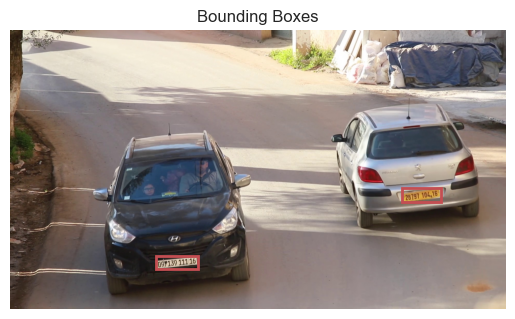

In [216]:
def visualize_bounding_boxes(image_path, boxes):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Create a figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    for box in boxes:
        xmin, ymin, xmax, ymax, class_label = box

        # Create a Rectangle patch
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none', label=f'Class {class_label}')

        # Add the rectangle to the Axes
        ax.add_patch(rect)

        # Set axis properties
        ax.axis('off')
        ax.set_title(f'Bounding Boxes')

    # Show the plot
    plt.show()

# Example usage:
image_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/012/0981.jpg"
boxes = [(1517, 612, 1666, 664, 1), (564, 875, 729, 925, 2)]  

visualize_bounding_boxes(image_path, boxes)

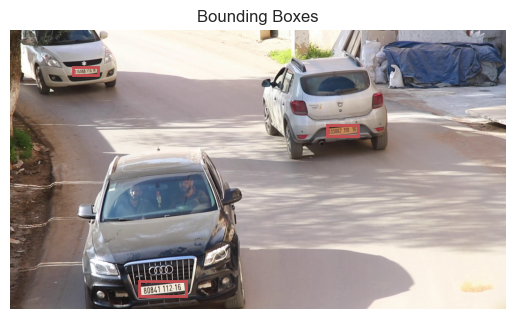

In [217]:
def visualize_bounding_boxes(image_path, boxes):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Create a figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    for box in boxes:
        xmin, ymin, xmax, ymax, class_label = box

        # Create a Rectangle patch
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none', label=f'Class {class_label}')

        # Add the rectangle to the Axes
        ax.add_patch(rect)

        # Set axis properties
        ax.axis('off')
        ax.set_title(f'Bounding Boxes')

    # Show the plot
    plt.show()

# Example usage:
image_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/012/12531.jpg"
boxes = [(1225, 369, 1346, 411, 1), (500, 971, 681, 1029 , 2), (244, 142, 340, 175, 3)]  


visualize_bounding_boxes(image_path, boxes)

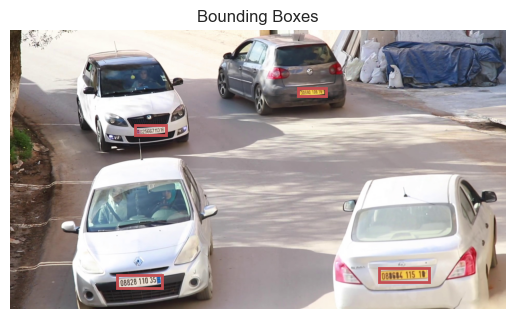

In [218]:
def visualize_bounding_boxes(image_path, boxes):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Create a figure and axes
    fig, ax = plt.subplots(1)

    # Display the image
    ax.imshow(image)

    for box in boxes:
        xmin, ymin, xmax, ymax, class_label = box

        # Create a Rectangle patch
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none', label=f'Class {class_label}')

        # Add the rectangle to the Axes
        ax.add_patch(rect)

        # Set axis properties
        ax.axis('off')
        ax.set_title(f'Bounding Boxes')

    # Show the plot
    plt.show()

# Example usage:
image_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/012/1365.jpg"
boxes = [(1429,	922, 1622, 974, 1), (414, 946, 588,	999 , 2), (484,	367, 605, 407, 3), (1113, 224, 1221, 256, 4)]  


visualize_bounding_boxes(image_path, boxes)

### Crop and save the car number plates images in new folder

In [219]:
# Define the function to crop and save the number plates
def crop_and_save_number_plate(image, coordinates, output_folder, image_name, plate_index):
    xmin, ymin, xmax, ymax = coordinates
    cropped_plate = image[ymin:ymax, xmin:xmax]

    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Save the cropped plate with the same name as the original image, along with the plate index
    output_path = os.path.join(output_folder, f"{image_name}_cropped_plate_{plate_index}.jpg")
    cv2.imwrite(output_path, cropped_plate)
    print(f"Number plate saved: {output_path}")

    return output_path  # Return the path of the cropped plate

# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# List of all image files in the directory
image_files = [file for file in os.listdir(images_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

# Build the complete list of image paths
image_paths = [os.path.join(images_folder, file) for file in image_files]

# Load the images
images = [cv2.imread(path) for path in image_paths]

# Full path to the directory containing the label files
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# Output folder for cropped number plates
output_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Create a CSV file
csv_filename = "imageslabelsadditionalfile.csv"
csv_path = os.path.join(images_folder, csv_filename)

# Write information to the CSV file
with open(csv_path, 'w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["image name", "image path", "image size", "image height", "image width", "xmin", "ymin", "xmax", "ymax", "class label",
                         "object size", "object area", "bounding box area", "bounding box aspect ratio", "object type", "subcategory", "image format", "cropped plate image"])

    # List of all label files in the directory
    label_files = [file for file in os.listdir(labels_folder) if file.lower().endswith('.txt')]

    # Loop through label files
    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as label_file_content:
            lines = label_file_content.readlines()

        # Check if there are enough lines for both class label and coordinates
        if len(lines) >= 2:
            class_label = lines[0].strip()
            for plate_index, coordinates in enumerate(lines[1:], start=1):  # Start index from 1
                coords = coordinates.strip().split()

                # Check if there are enough values for coordinates
                if len(coords) == 4:
                    xmin, ymin, xmax, ymax = map(int, coords)

                    # Replace placeholders with actual values
                    image_name = label_file.replace('.txt', '.jpg')
                    image_path = os.path.join(images_folder, image_name)
                    image_size = os.path.getsize(image_path)
                    image_height, image_width = images[image_files.index(image_name)].shape[:2]

                    # Calculate additional attributes
                    object_size_pixels = (xmax - xmin) * (ymax - ymin)
                    object_area = object_size_pixels / (image_height * image_width)
                    bounding_box_area = (xmax - xmin) * (ymax - ymin)
                    bounding_box_aspect_ratio = (xmax - xmin) / (ymax - ymin)
                    # Placeholder values for object type and subcategory (replace with actual values)
                    object_type = "car"
                    subcategory = "number_plate" 
                    
                    # Placeholder value for image format (replace with actual value)
                    image_format = image_name.split('.')[-1].lower()  # Extract image format from the file name

                    try:
                        # Crop and save the number plate
                        cropped_plate_path = crop_and_save_number_plate(images[image_files.index(image_name)], (xmin, ymin, xmax, ymax), output_folder, image_name, plate_index)

                        # Write to CSV
                        csv_writer.writerow([image_name, image_path, image_size, image_height, image_width, xmin, ymin, xmax, ymax, class_label,
                                             object_size_pixels, object_area, bounding_box_area, bounding_box_aspect_ratio, object_type, subcategory, image_format, cropped_plate_path])
                    except Exception as e:
                        print(f"Error processing image '{image_name}', plate {plate_index}: {e}")

print(f"Coordinates and additional attributes have been saved to: {csv_path}")

Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_2.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_3.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0220.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0297.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_P

### Check csv file

In [220]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "imageslabelsadditionalfile.csv")

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Display the DataFrame
df

,image name,image path,image size,image height,image width,xmin,ymin,xmax,ymax,class label,object size,object area,bounding box area,bounding box aspect ratio,object type,subcategory,image format,cropped plate image
0,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,26,217,662,367,3,95400,0.156457,95400,4.240000,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
1,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,41,368,654,509,3,86433,0.141751,86433,4.347518,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
2,0.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,82866,902,676,62,509,644,632,3,71586,0.117402,71586,4.731707,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
3,0220.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,441714,1080,1920,586,624,719,670,1,6118,0.002950,6118,2.891304,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
4,0297.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,414237,1080,1920,645,799,806,854,1,8855,0.004270,8855,2.927273,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2434,sqqqqqqqqqqqq.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,166821,674,1200,552,372,769,439,1,14539,0.017976,14539,3.238806,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
2435,ssdsdsfffff.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,121300,673,1200,3,35,1200,311,1,330372,0.409079,330372,4.336957,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
2436,swdwfsdf.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,115489,674,1200,341,493,633,569,1,22192,0.027438,22192,3.842105,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...
2437,tyyyty.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,36004,450,800,478,279,564,305,1,2236,0.006211,2236,3.307692,car,number_plate,jpg,C:/Users/User/Downloads/License_Plates_of_Alge...


### Create a new CSV file for cropped car number plates

In [221]:
# Define the function to crop and save the number plates
def crop_and_save_number_plate(image, coordinates, output_folder, image_name, plate_index):
    cropped_plate = image[coordinates[1]:coordinates[3], coordinates[0]:coordinates[2]]

    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Save the cropped plate with the same name as the original image, along with the plate index
    output_path = os.path.join(output_folder, f"{image_name}_cropped_plate_{plate_index}.jpg")
    cv2.imwrite(output_path, cropped_plate)
    print(f"Number plate saved: {output_path}")

    return output_path  # Return the path of the cropped plate

# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# List of all image files in the directory
image_files = [file for file in os.listdir(images_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

# Build the complete list of image paths
image_paths = [os.path.join(images_folder, file) for file in image_files]

# Load the images
images = [cv2.imread(path) for path in image_paths]

# Full path to the directory containing the label files
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# Output folder for cropped number plates
output_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Create a new CSV file for cropped plates
csv_filename = "cropped_plates_info.csv"
csv_path = os.path.join(output_folder, csv_filename)

# Write information to the CSV file
with open(csv_path, 'w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["cropped_plate_name", "cropped_plate_path", "plate_index"])

    # List of all label files in the directory
    label_files = [file for file in os.listdir(labels_folder) if file.lower().endswith('.txt')]

    # Loop through label files
    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as label_file_content:
            lines = label_file_content.readlines()

        # Check if there are enough lines for both class label and coordinates
        if len(lines) >= 2:
            for plate_index, coordinates in enumerate(lines[1:], start=1):  # Start index from 1
                coords = coordinates.strip().split()

                # Check if there are enough values for coordinates
                if len(coords) == 4:
                    # Replace placeholders with actual values
                    image_name = label_file.replace('.txt', '.jpg')
                    image_path = os.path.join(images_folder, image_name)

                    try:
                        # Crop and save the number plate
                        cropped_plate_path = crop_and_save_number_plate(images[image_files.index(image_name)], (int(coords[0]), int(coords[1]), int(coords[2]), int(coords[3])), output_folder, image_name, plate_index)

                        # Write to CSV
                        csv_writer.writerow([os.path.basename(cropped_plate_path), cropped_plate_path, plate_index])
                    except Exception as e:
                        print(f"Error processing image '{image_name}', plate {plate_index}: {e}")

print(f"Cropped plates information has been saved to: {csv_path}")

Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_2.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_3.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0220.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0297.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_P

In [222]:
### Read csv file

In [223]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "cropped_plates_info.csv")

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Display the DataFrame
df

,cropped_plate_name,cropped_plate_path,plate_index
0,0.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
1,0.jpg_cropped_plate_2.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,2
2,0.jpg_cropped_plate_3.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,3
3,0220.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
4,0297.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
...,...,...,...
2434,sqqqqqqqqqqqq.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
2435,ssdsdsfffff.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
2436,swdwfsdf.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1
2437,tyyyty.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1


### Add additional columns 

In [224]:
# Define the function to crop and save the number plates
def crop_and_save_number_plate(image, coordinates, output_folder, image_name, plate_index):
    cropped_plate = image[coordinates[1]:coordinates[3], coordinates[0]:coordinates[2]]

    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Save the cropped plate with the same name as the original image, along with the plate index
    output_path = os.path.join(output_folder, f"{image_name}_cropped_plate_{plate_index}.jpg")
    cv2.imwrite(output_path, cropped_plate)
    print(f"Number plate saved: {output_path}")

    return output_path  # Return the path of the cropped plate

# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/images/003"

# List of all image files in the directory
image_files = [file for file in os.listdir(images_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

# Build the complete list of image paths
image_paths = [os.path.join(images_folder, file) for file in image_files]

# Load the images
images = [cv2.imread(path) for path in image_paths]

# Full path to the directory containing the label files
labels_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/labels/003"

# Output folder for cropped number plates
output_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Create a new CSV file for cropped plates
csv_filename = "cropped_plates_additional_info.csv"
csv_path = os.path.join(output_folder, csv_filename)

# Write information to the CSV file
with open(csv_path, 'w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["cropped_plate_name", "cropped_plate_path", "plate_index", "size", "height", "width", "area", "aspect_ratio", "image_format", "object_type"])

    # List of all label files in the directory
    label_files = [file for file in os.listdir(labels_folder) if file.lower().endswith('.txt')]

    # Loop through label files
    for label_file in label_files:
        label_file_path = os.path.join(labels_folder, label_file)
        with open(label_file_path, 'r') as label_file_content:
            lines = label_file_content.readlines()

        # Check if there are enough lines for both class label and coordinates
        if len(lines) >= 2:
            for plate_index, coordinates in enumerate(lines[1:], start=1):  # Start index from 1
                coords = coordinates.strip().split()

                # Check if there are enough values for coordinates
                if len(coords) == 4:
                    # Replace placeholders with actual values
                    image_name = label_file.replace('.txt', '.jpg')
                    image_path = os.path.join(images_folder, image_name)

                    try:
                        # Crop and save the number plate
                        cropped_plate_path = crop_and_save_number_plate(images[image_files.index(image_name)], (int(coords[0]), int(coords[1]), int(coords[2]), int(coords[3])), output_folder, image_name, plate_index)

                        # Calculate additional attributes
                        image = cv2.imread(cropped_plate_path)
                        size = os.path.getsize(cropped_plate_path)
                        height, width = image.shape[:2]
                        area = width * height
                        aspect_ratio = width / height
                        image_format = image_name.split('.')[-1].lower()
                        object_type = "number_plate"

                        # Write to CSV
                        csv_writer.writerow([os.path.basename(cropped_plate_path), cropped_plate_path, plate_index, size, height, width, area, aspect_ratio, image_format, object_type])
                    except Exception as e:
                        print(f"Error processing image '{image_name}', plate {plate_index}: {e}")

print(f"Cropped plates information has been saved to: {csv_path}")

Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_2.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0.jpg_cropped_plate_3.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0220.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\0297.jpg_cropped_plate_1.jpg
Number plate saved: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_P

### Read csv file

In [225]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "cropped_plates_additional_info.csv")

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Display the DataFrame
df

,cropped_plate_name,cropped_plate_path,plate_index,size,height,width,area,aspect_ratio,image_format,object_type
0,0.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,33453,150,636,95400,4.240000,jpg,number_plate
1,0.jpg_cropped_plate_2.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,2,34949,141,613,86433,4.347518,jpg,number_plate
2,0.jpg_cropped_plate_3.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,3,26457,123,582,71586,4.731707,jpg,number_plate
3,0220.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,3827,46,133,6118,2.891304,jpg,number_plate
4,0297.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,4922,55,161,8855,2.927273,jpg,number_plate
...,...,...,...,...,...,...,...,...,...,...
2432,sqqqqqqqqqqqq.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,9611,67,217,14539,3.238806,jpg,number_plate
2433,ssdsdsfffff.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,92914,276,1197,330372,4.336957,jpg,number_plate
2434,swdwfsdf.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,11451,76,292,22192,3.842105,jpg,number_plate
2435,tyyyty.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,1747,26,86,2236,3.307692,jpg,number_plate


### More columns

In [226]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "cropped_plates_additional_info.csv")

# Output CSV file for additional information
output_csv_filename = "croppedplatesadditionalinfos.csv"
output_csv_path = os.path.join(images_folder, output_csv_filename)

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Function to read and resize images
def read_and_resize_image(image_path, target_size=(150, 50)):
    image = cv2.imread(image_path)
    resized_image = cv2.resize(image, target_size)
    return resized_image

# Add a new column 'image_array' to the DataFrame
df['image_array'] = df['cropped_plate_path'].apply(lambda x: read_and_resize_image(os.path.join(images_folder, x)))

# Add a new column 'image_mode' to the DataFrame
df['image_array_mode'] = df['cropped_plate_path'].apply(lambda x: cv2.imread(os.path.join(images_folder, x), cv2.IMREAD_COLOR).shape[2])

# Apply the function to the 'cropped_plate_path' column and create a new column 'image_pil'
df['image_pil'] = df['cropped_plate_path'].apply(lambda x: Image.open(os.path.join(images_folder, x)))

# Create a new column 'image_mode_pil' to store the mode of the image in PIL format
df['image_mode_pil'] = df['image_pil'].apply(lambda x: x.mode)

# Additional columns for image metrics
df['resolution'] = df['image_pil'].apply(lambda x: np.prod(x.size) if x is not None and isinstance(x.size, tuple) else np.nan).astype(float)
df['sharpness'] = df['image_array'].apply(lambda x: cv2.Laplacian(x, cv2.CV_64F).var() if x is not None else np.nan)
df['contrast'] = df['image_array'].apply(lambda x: np.max(cv2.calcHist([cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)], [0], None, [256], [0, 256])) / np.sum(cv2.calcHist([cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)], [0], None, [256], [0, 256])) if x is not None else np.nan)
df['noise'] = df['image_array'].apply(lambda x: 20 * np.log10(np.max(x) / cv2.meanStdDev(cv2.cvtColor(x, cv2.COLOR_BGR2GRAY))[1][0]) if x is not None else np.nan)
df['noise'] = pd.to_numeric(df['noise'].str[0], errors='coerce')
df['blur'] = df['image_array'].apply(lambda x: cv2.Laplacian(x, cv2.CV_64F).var() if x is not None else np.nan)


# Write information to the output CSV file
df.to_csv(output_csv_path, index=False)

print(f"Additional information (including image arrays and metrics) for cropped plates has been saved to: {output_csv_path}")

Additional information (including image arrays and metrics) for cropped plates has been saved to: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\croppedplatesadditionalinfos.csv


### Check csv file

In [227]:
# Full path to the directory containing the images
images_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Full path to the CSV file
csv_path = os.path.join(images_folder, "croppedplatesadditionalinfos.csv")

# Read CSV into a DataFrame
df = pd.read_csv(csv_path)

# Display the DataFrame
df

,cropped_plate_name,cropped_plate_path,plate_index,size,height,width,area,aspect_ratio,image_format,object_type,image_array,image_array_mode,image_pil,image_mode_pil,resolution,sharpness,contrast,noise,blur
0,0.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,33453,150,636,95400,4.240000,jpg,number_plate,[[[ 44 45 49]\n [ 42 44 45]\n [ 38 40 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,95400.0,12363.733367,0.030533,9.262492,12363.733367
1,0.jpg_cropped_plate_2.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,2,34949,141,613,86433,4.347518,jpg,number_plate,[[[ 21 24 26]\n [ 29 23 34]\n [ 34 36 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,86433.0,5966.694541,0.042533,11.404097,5966.694541
2,0.jpg_cropped_plate_3.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,3,26457,123,582,71586,4.731707,jpg,number_plate,[[[ 58 63 69]\n [ 66 78 79]\n [ 80 94 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,71586.0,8158.558072,0.052267,8.480532,8158.558072
3,0220.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,3827,46,133,6118,2.891304,jpg,number_plate,[[[26 21 22]\n [26 21 22]\n [27 22 23]\n .....,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,6118.0,925.620782,0.030933,10.095695,925.620782
4,0297.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,4922,55,161,8855,2.927273,jpg,number_plate,[[[54 52 52]\n [53 51 51]\n [53 51 51]\n .....,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,8855.0,741.012505,0.016000,10.526236,741.012505
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2432,sqqqqqqqqqqqq.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,9611,67,217,14539,3.238806,jpg,number_plate,[[[ 99 78 70]\n [ 98 77 69]\n [ 97 76 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,14539.0,2002.308104,0.034400,14.569598,2002.308104
2433,ssdsdsfffff.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,92914,276,1197,330372,4.336957,jpg,number_plate,[[[ 77 67 58]\n [ 76 65 59]\n [ 78 70 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,330372.0,6340.960252,0.031733,12.850157,6340.960252
2434,swdwfsdf.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,11451,76,292,22192,3.842105,jpg,number_plate,[[[91 89 85]\n [80 86 85]\n [78 82 85]\n .....,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,22192.0,2277.970708,0.033333,13.339568,2277.970708
2435,tyyyty.jpg_cropped_plate_1.jpg,C:/Users/User/Downloads/License_Plates_of_Alge...,1,1747,26,86,2236,3.307692,jpg,number_plate,[[[ 12 30 67]\n [ 12 30 67]\n [ 12 30 ...,3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,RGB,2236.0,76.747048,0.028667,15.226419,76.747048


### Verify csv file inputs

Size of the image: 3827 bytes
Height of the image: 46 pixels
Width of the image: 133 pixels
Calculated area: 6118 pixels
Calculated aspect ratio: 2.891304347826087
Extracted image format: .jpg
Object type: number_plate
Image array: [[[26 21 22]
  [26 21 22]
  [27 22 24]
  ...
  [37 39 49]
  [26 28 38]
  [43 42 52]]

 [[27 22 23]
  [27 22 23]
  [26 21 23]
  ...
  [32 36 47]
  [32 34 44]
  [34 34 46]]

 [[28 25 27]
  [27 24 26]
  [27 24 26]
  ...
  [21 27 40]
  [34 38 49]
  [35 36 50]]

 ...

 [[29 30 34]
  [28 29 33]
  [21 24 28]
  ...
  [25 28 36]
  [26 29 37]
  [26 29 37]]

 [[22 23 27]
  [22 23 27]
  [27 28 32]
  ...
  [26 28 38]
  [27 29 39]
  [27 29 39]]

 [[26 27 31]
  [26 27 31]
  [29 30 34]
  ...
  [28 30 40]
  [28 30 40]
  [29 31 41]]]
Image array shape: (46, 133, 3)
Image array mode: uint8
Image PIL mode: RGB
Image mode PIL: <PIL.Image.Image image mode=RGB size=133x46 at 0x20204F73610>
Resolution: 6118
Sharpness: 1779.3252537164888
Contrast: 0.03252696990966797
Noise: [9.96143

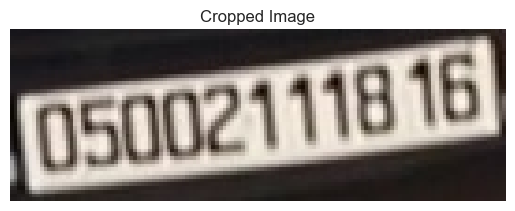

In [228]:
cropped_image_path = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates/0220.jpg_cropped_plate_1.jpg"

# Read the cropped image using OpenCV
cropped_image = cv2.imread(cropped_image_path)

# Check if the image is successfully loaded
if cropped_image is not None:
    # Get the size of the image
    size = os.path.getsize(cropped_image_path)

    # Get the height and width of the image
    height, width = cropped_image.shape[:2]

    # Calculate additional attributes
    area = width * height
    aspect_ratio = width / height
    image_format = os.path.splitext(cropped_image_path)[-1].lower()  # Extract image format from the file name

    # Placeholder values for features not explicitly calculated
    object_type = "number_plate"

    # Convert OpenCV image to PIL Image
    image_pil = Image.fromarray(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))

    # Image enhancements
    enhancer = ImageEnhance.Contrast(image_pil)
    contrast = enhancer.enhance(1.5)  

    # Image filters
    filtered_image = image_pil.filter(ImageFilter.GaussianBlur(radius=2))
    blur = 2.0  # Placeholder value, adjust as needed

    # Calculate image array and mode
    image_array = cropped_image
    image_array_mode = image_array.dtype  # Use dtype for array mode

    # Placeholder values for features not explicitly calculated
    resolution = height * width  # Basic representation of resolution based on pixel count
    sharpness = cv2.Laplacian(image_array, cv2.CV_64F).var()
    contrast = np.max(cv2.calcHist([cv2.cvtColor(image_array, cv2.COLOR_BGR2GRAY)], [0], None, [256], [0, 256])) / np.sum(cv2.calcHist([cv2.cvtColor(image_array, cv2.COLOR_BGR2GRAY)], [0], None, [256], [0, 256]))
    noise = 20 * np.log10(np.max(image_array) / cv2.meanStdDev(cv2.cvtColor(image_array, cv2.COLOR_BGR2GRAY))[1][0])
    blur = cv2.Laplacian(image_array, cv2.CV_64F).var()

    # Display the verification information
    print(f"Size of the image: {size} bytes")
    print(f"Height of the image: {height} pixels")
    print(f"Width of the image: {width} pixels")
    print(f"Calculated area: {area} pixels")
    print(f"Calculated aspect ratio: {aspect_ratio}")
    print(f"Extracted image format: {image_format}")
    print(f"Object type: {object_type}")
    print(f"Image array: {image_array}")
    print(f"Image array shape: {image_array.shape}")
    print(f"Image array mode: {image_array_mode}")
    print(f"Image PIL mode: {image_pil.mode}")
    print(f"Image mode PIL: {image_pil}")
    print(f"Resolution: {resolution}")
    print(f"Sharpness: {sharpness}")
    print(f"Contrast: {contrast}")
    print(f"Noise: {noise}")
    print(f"Blur: {blur}")

    # Display the image using matplotlib
    plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
    plt.title("Cropped Image")
    plt.axis("off")
    plt.show()

else:
    print("Error: Unable to read the cropped image.")

In [229]:
# Load DataFrame contains necessary informations for analysis about cropped car number plates images
df = pd.read_csv("C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates/croppedplatesadditionalinfos.csv")

In [230]:
# Print the column names of the DataFrame
df.columns

Index(['cropped_plate_name', 'cropped_plate_path', 'plate_index', 'size',
       'height', 'width', 'area', 'aspect_ratio', 'image_format',
       'object_type', 'image_array', 'image_array_mode', 'image_pil',
       'image_mode_pil', 'resolution', 'sharpness', 'contrast', 'noise',
       'blur'],
      dtype='object')

In [231]:
df.shape

(2437, 19)

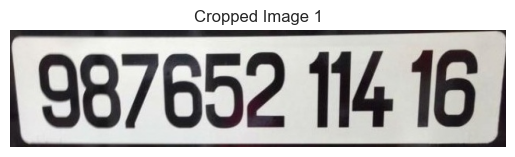

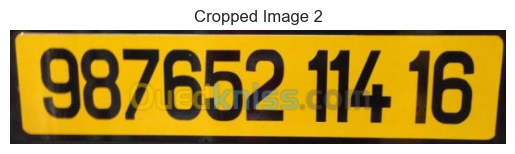

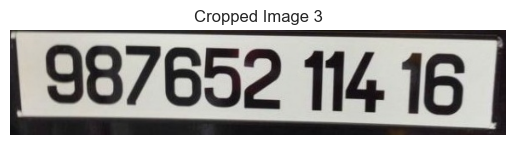

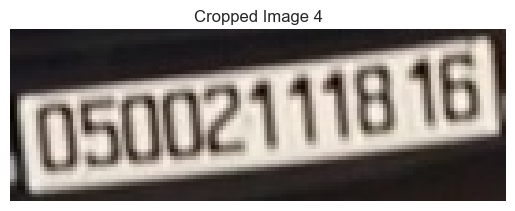

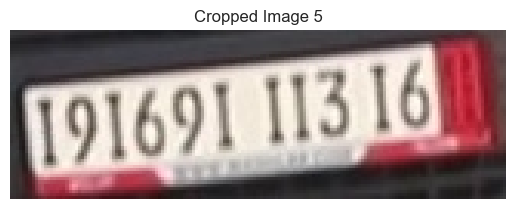

In [232]:
# Display the first five cropped images
for index, row in df.head(5).iterrows():
    cropped_image_path = row['cropped_plate_path']
    cropped_image = cv2.imread(cropped_image_path)

    if cropped_image is not None:
        # Display the image using matplotlib
        plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Cropped Image {index + 1}")
        plt.axis("off")
        plt.show()
    else:
        print(f"Error: Unable to read the cropped image at index {index}.")

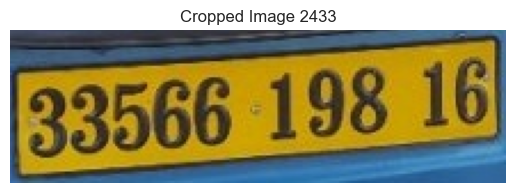

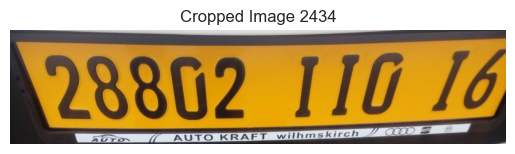

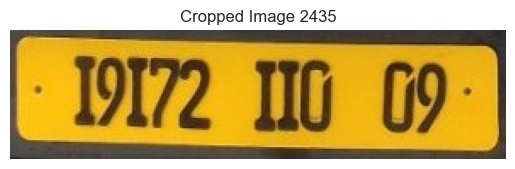

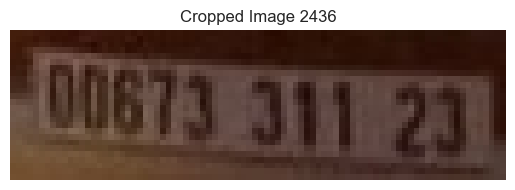

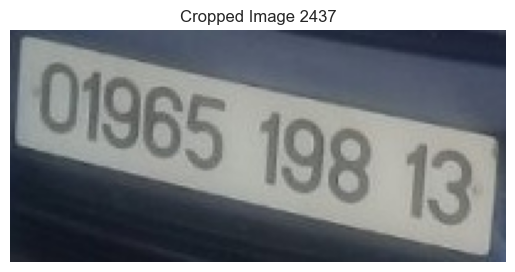

In [233]:
# Display the last five cropped images
for index, row in df.tail(5).iterrows():
    cropped_image_path = row['cropped_plate_path']
    cropped_image = cv2.imread(cropped_image_path)

    if cropped_image is not None:
        # Display the image using matplotlib
        plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Cropped Image {index + 1}")
        plt.axis("off")
        plt.show()
    else:
        print(f"Error: Unable to read the cropped image at index {index}.")

In [234]:
# Display information about the DataFrame
print("\nDataFrame information:")
df.info()


DataFrame information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2437 entries, 0 to 2436
Data columns (total 19 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   cropped_plate_name  2437 non-null   object 
 1   cropped_plate_path  2437 non-null   object 
 2   plate_index         2437 non-null   int64  
 3   size                2437 non-null   int64  
 4   height              2437 non-null   int64  
 5   width               2437 non-null   int64  
 6   area                2437 non-null   int64  
 7   aspect_ratio        2437 non-null   float64
 8   image_format        2437 non-null   object 
 9   object_type         2437 non-null   object 
 10  image_array         2437 non-null   object 
 11  image_array_mode    2437 non-null   int64  
 12  image_pil           2437 non-null   object 
 13  image_mode_pil      2437 non-null   object 
 14  resolution          2437 non-null   float64
 15  sharpness           2437 non-nu

In [235]:
# Display descriptive statistics
print("\nDescriptive statistics:")
df.describe()


Descriptive statistics:


,plate_index,size,height,width,area,aspect_ratio,image_array_mode,resolution,sharpness,contrast,noise,blur
count,2437.000000,2437.000000,2437.000000,2437.000000,2437.000000,2437.000000,2437.0,2437.000000,2437.000000,2437.000000,2437.000000,2437.000000
mean,1.041444,7915.691834,66.517850,195.532212,14123.196143,3.115306,3.0,14123.196143,2683.326869,0.033203,12.399691,2683.326869
std,0.298336,5985.764192,28.046236,88.014970,16715.916775,0.990999,0.0,16715.916775,2265.712103,0.025498,2.124534,2265.712103
min,1.000000,1080.000000,19.000000,1.000000,225.000000,0.004444,3.0,225.000000,18.893904,0.008800,7.352365,18.893904
25%,1.000000,5101.000000,49.000000,144.000000,7791.000000,2.414286,3.0,7791.000000,1081.597412,0.020000,10.797930,1081.597412
50%,1.000000,6820.000000,60.000000,184.000000,11336.000000,3.276316,3.0,11336.000000,2159.319635,0.026667,12.205878,2159.319635
75%,1.000000,9141.000000,76.000000,230.000000,16192.000000,3.781250,3.0,16192.000000,3588.706414,0.036933,13.649889,3588.706414
max,6.000000,96558.000000,375.000000,1197.000000,360873.000000,8.893939,3.0,360873.000000,24262.491259,0.523067,21.780152,24262.491259


## Data Visualisation 

### Visualize the color channels

Image 152: NumPy array has the shape (20, 66, 3)


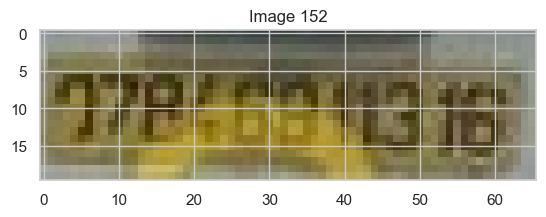

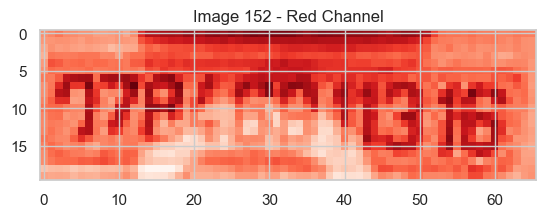

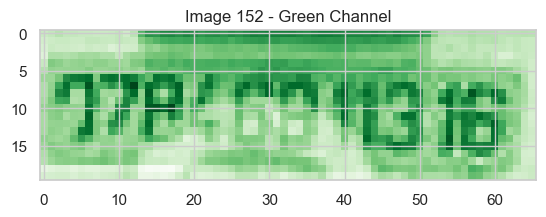

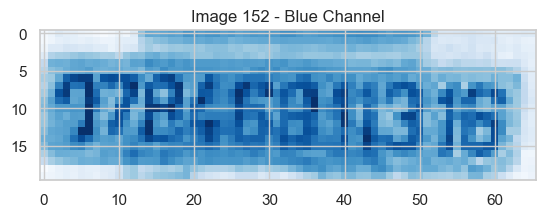

Image 1528: NumPy array has the shape (58, 232, 3)


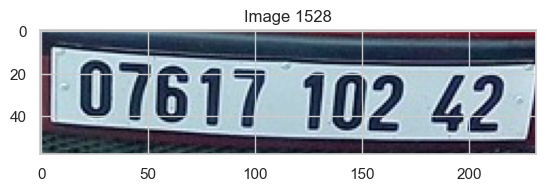

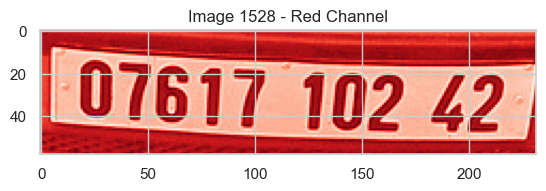

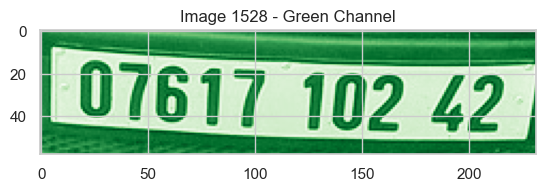

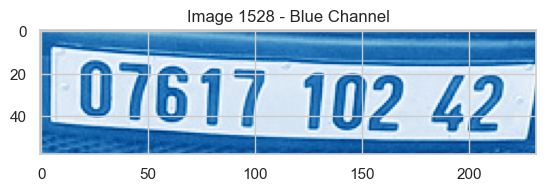

Image 2165: NumPy array has the shape (70, 140, 3)


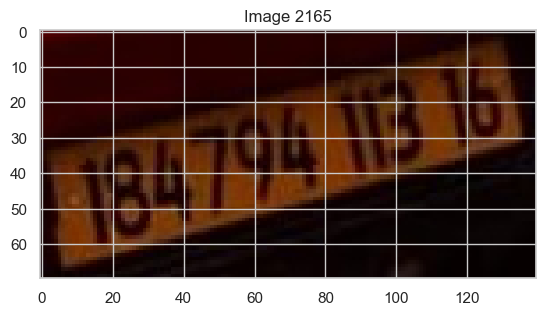

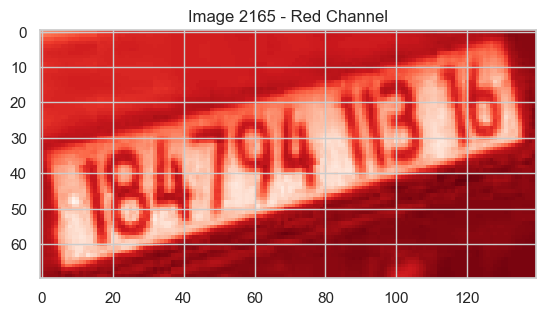

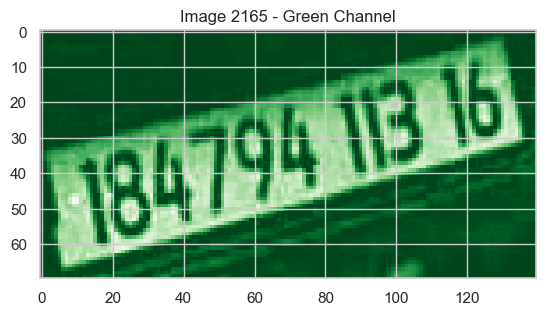

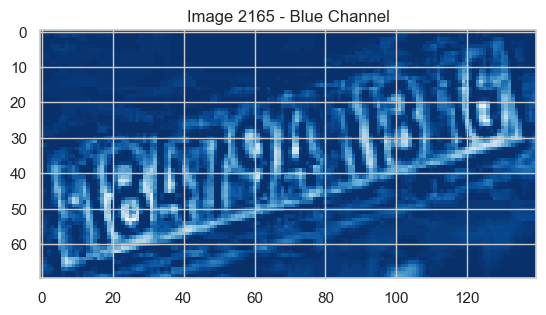

Image 1417: NumPy array has the shape (54, 293, 3)


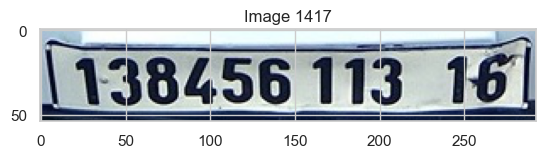

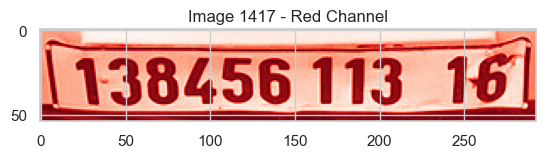

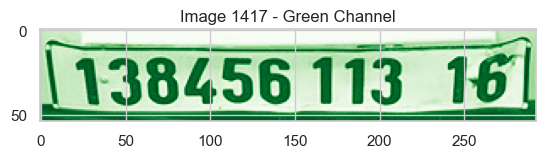

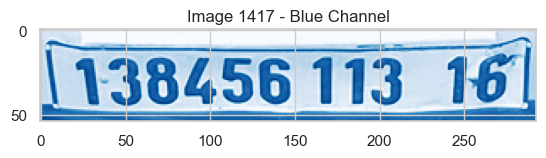

Image 155: NumPy array has the shape (56, 179, 3)


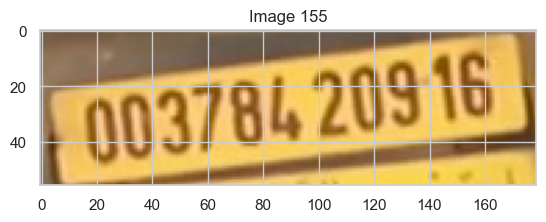

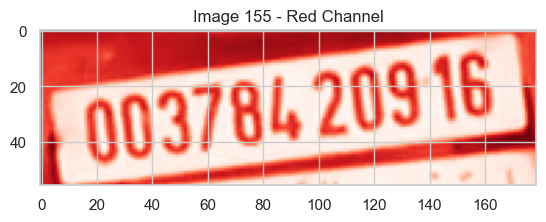

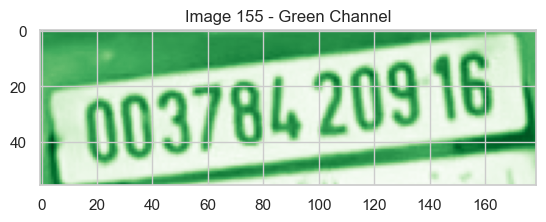

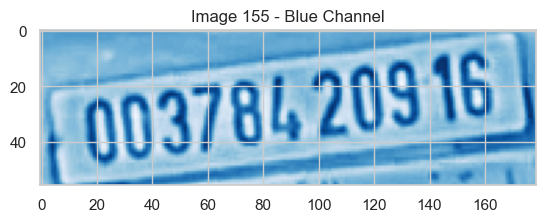

In [236]:
# Randomly select five rows from the DataFrame
selected_rows = df.sample(5)

# Loop through each selected row
for i, row in selected_rows.iterrows():
    # Get the image path from the row
    image_path = row['cropped_plate_path']

    # Load the image
    img = Image.open(image_path)

    # Convert the image to a NumPy array
    img_data = np.array(img)

    # Get the shape of the resulting array
    img_data_shape = img_data.shape

    # Display the shape of the NumPy array
    print(f"Image {i + 1}: NumPy array has the shape {img_data_shape}")

    # Plot the original image using `imshow`
    plt.imshow(img_data)
    plt.title(f"Image {i + 1}")
    plt.show()

    # Check if the image has more than three channels
    if img_data.shape[2] > 3:
        print(f"Image {i + 1} has more than 3 channels. Displaying the first three channels.")

        # Plot the first three channels
        plt.imshow(img_data[:, :, :3])
        plt.title(f"Image {i + 1} - First Three Channels")
        plt.show()

    else:
        # Plot the red, green, and blue channels
        plt.imshow(img_data[:, :, 0], cmap=plt.cm.Reds_r)
        plt.title(f"Image {i + 1} - Red Channel")
        plt.show()

        plt.imshow(img_data[:, :, 1], cmap=plt.cm.Greens_r)
        plt.title(f"Image {i + 1} - Green Channel")
        plt.show()

        plt.imshow(img_data[:, :, 2], cmap=plt.cm.Blues_r)
        plt.title(f"Image {i + 1} - Blue Channel")
        plt.show()

Image: NumPy array has the shape (49, 108, 3)


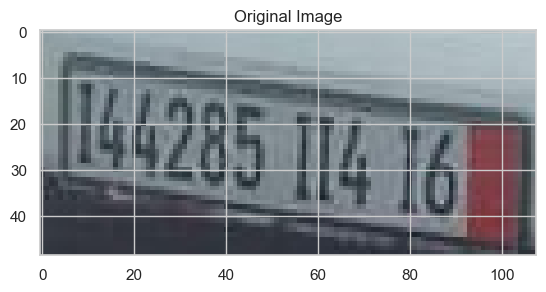

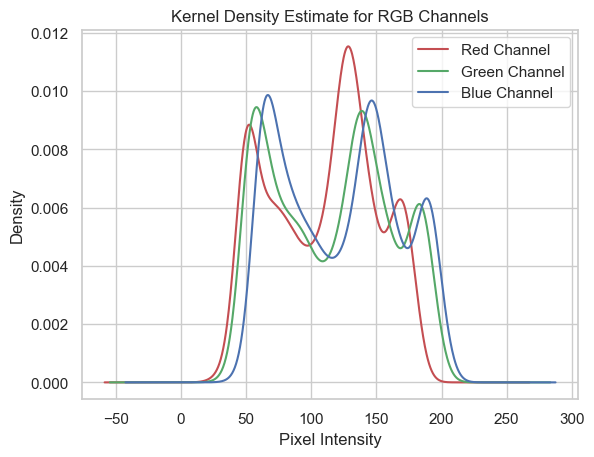

In [237]:
# Randomly select one row from the DataFrame
selected_row = df.sample(1).iloc[0]

# Get the image path from the row
image_path = selected_row['cropped_plate_path']

# Load the image
img = Image.open(image_path)

# Convert the image to a NumPy array
img_data = np.array(img)

# Get the shape of the resulting array
img_data_shape = img_data.shape

# Display the shape of the NumPy array
print(f"Image: NumPy array has the shape {img_data_shape}")

# Plot the original image using `imshow`
plt.imshow(img_data)
plt.title("Original Image")
plt.show()

def plot_kde(channel, color):
    """ Plots a kernel density estimate for the given data.
        
        `channel` must be a 2d array
        `color` must be a color string, e.g. 'r', 'g', or 'b'
    """
    data = channel.flatten()
    return pd.Series(data).plot.density(c=color)

def plot_rgb(image_data):
    # use enumerate to loop over colors and indexes
    for ix, color in enumerate(channels):
        plot_kde(image_data[:, :, ix], color)

    plt.title("Kernel Density Estimate for RGB Channels")
    plt.xlabel("Pixel Intensity")
    plt.ylabel("Density")
    plt.legend(['Red Channel', 'Green Channel', 'Blue Channel'])
    plt.show()

# create the list of channels
channels = ['r', 'g', 'b']

# Plot the kernel density estimate for the RGB channels
plot_rgb(img_data)

### Quantitative variable 

#### Box Plot

<Figure size 1500x1000 with 0 Axes>

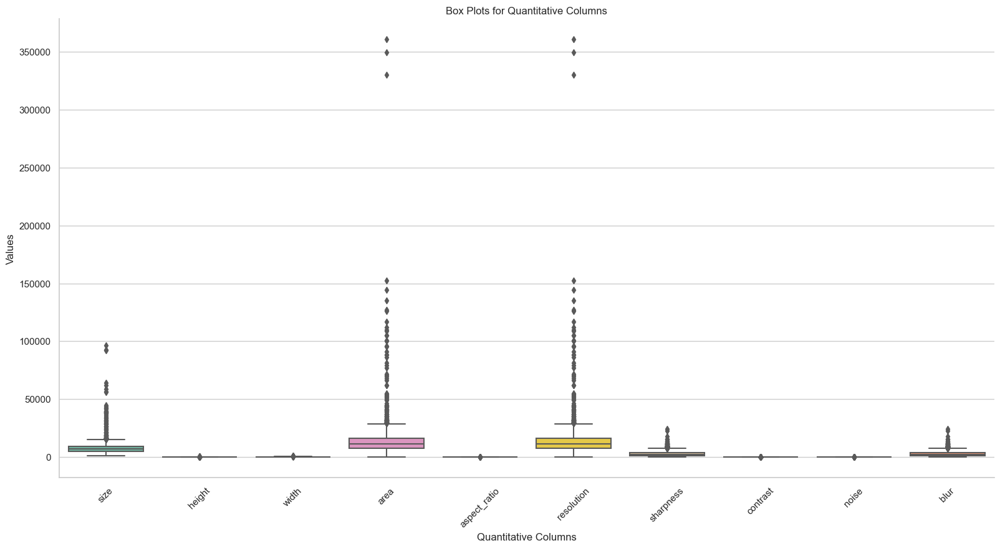

In [238]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select quantitative columns
quantitative_columns = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Create box plots with a larger figure size using seaborn.catplot
plt.figure(figsize=(15, 10))
sns.catplot(data=df[quantitative_columns], kind="box", height=8, aspect=2, palette='Set2')
plt.title('Box Plots for Quantitative Columns')
plt.xlabel('Quantitative Columns')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()

#### Violin Plot

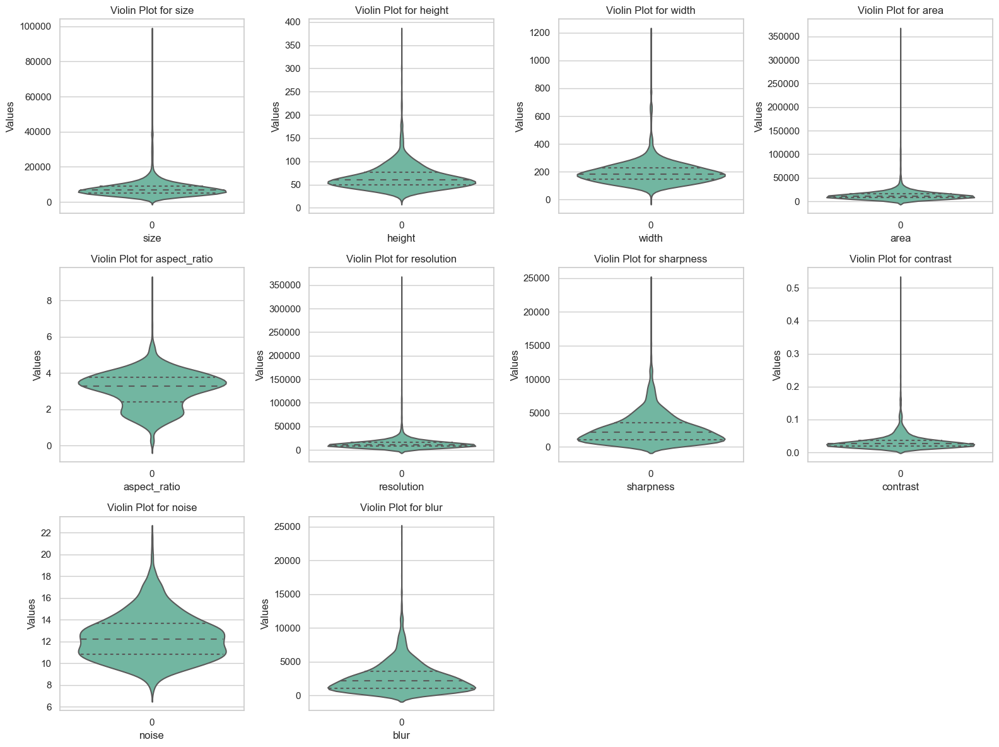

In [239]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select the columns for the violin plots
columns_for_violin = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Create a violin plot for each column
plt.figure(figsize=(16, 12))
for i, column in enumerate(columns_for_violin, 1):
    plt.subplot(3, 4, i)  # You can adjust the subplot layout based on your preference
    sns.violinplot(data=df[column], palette='Set2', inner='quartile')
    plt.title(f'Violin Plot for {column}')
    plt.xlabel(column)
    plt.ylabel('Values')

plt.tight_layout()
plt.show()

#### Histogram

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

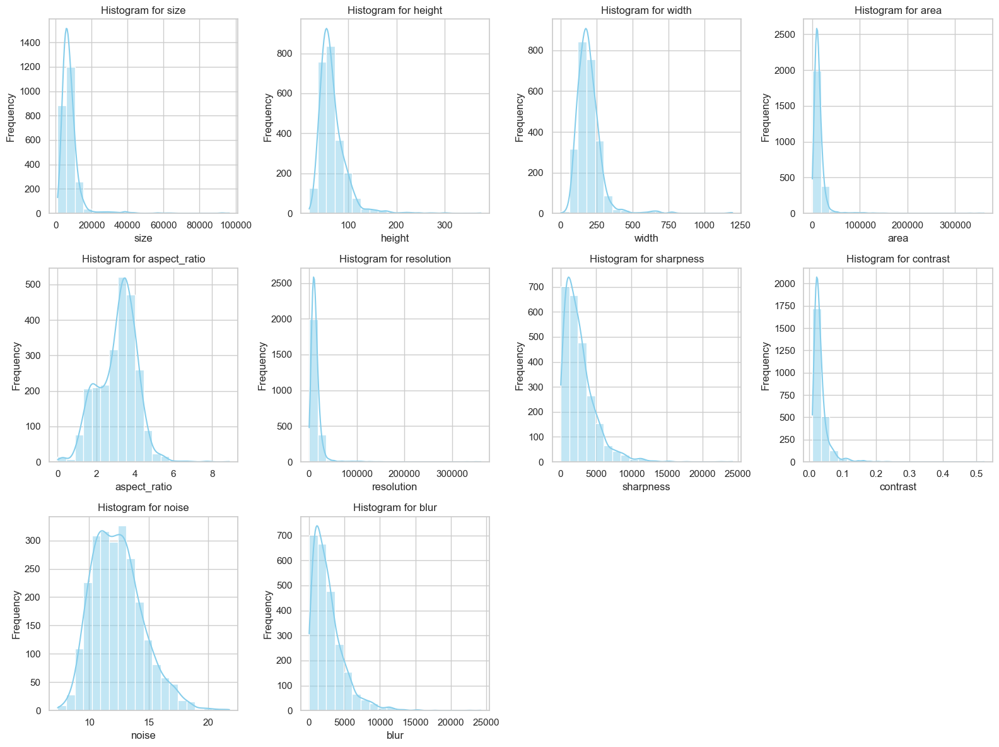

In [240]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select the columns for the histograms
columns_for_histogram = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Create histograms for each column
plt.figure(figsize=(16, 12))
for i, column in enumerate(columns_for_histogram, 1):
    plt.subplot(3, 4, i)  # Adjust the subplot layout based on your preference
    sns.histplot(df[column], bins=20, kde=True, color='skyblue')
    plt.title(f'Histogram for {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

### Categorical variable

#### Bar Plot

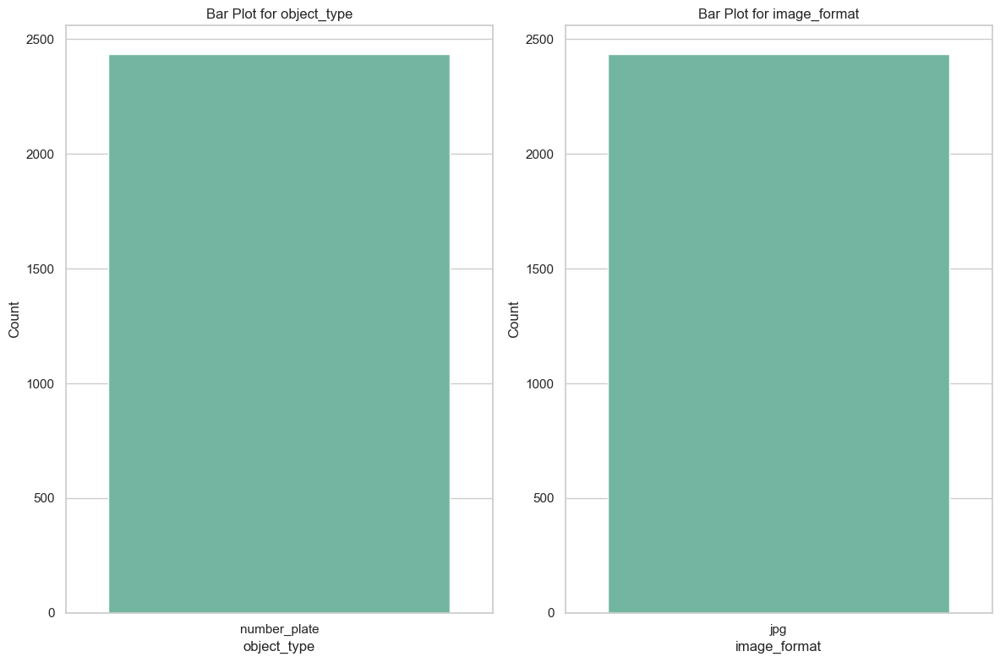

In [241]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select categorical columns for bar plots
categorical_columns = ['object_type', 'image_format']

# Create bar plots for each categorical column
plt.figure(figsize=(12, 8))
for i, column in enumerate(categorical_columns, 1):
    plt.subplot(1, 2, i)  # You can adjust the subplot layout based on your preference
    sns.countplot(data=df, x=column, palette='Set2')
    plt.title(f'Bar Plot for {column}')
    plt.xlabel(column)
    plt.ylabel('Count')

plt.tight_layout()
plt.show()

#### Pie Chart

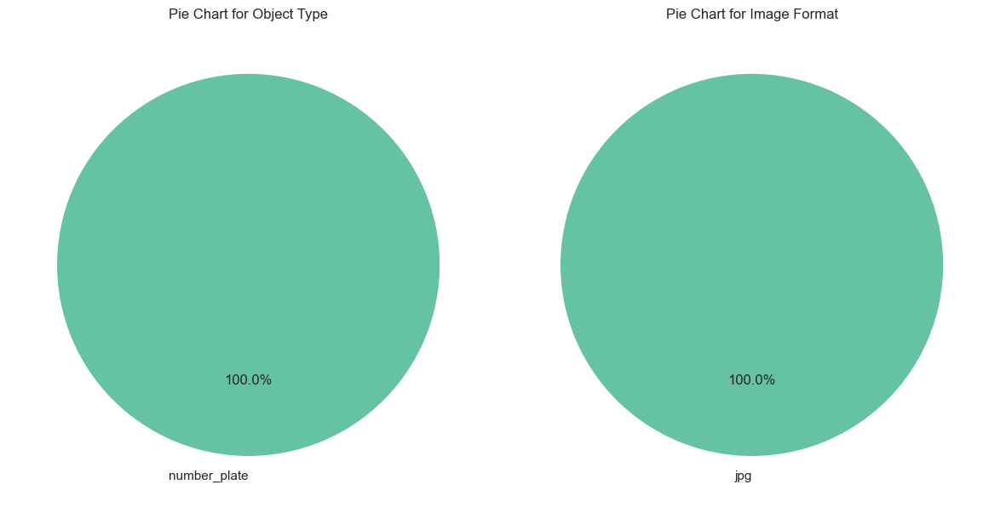

In [242]:
categorical_columns = ['object_type', 'image_format']

# Create a pie chart for each categorical column
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
object_type_counts = df['object_type'].value_counts()
plt.pie(object_type_counts, labels=object_type_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Set2.colors)
plt.title('Pie Chart for Object Type')

plt.subplot(1, 2, 2)
image_format_counts = df['image_format'].value_counts()
plt.pie(image_format_counts, labels=image_format_counts.index, autopct='%1.1f%%', startangle=90, colors=plt.cm.Set2.colors)
plt.title('Pie Chart for Image Format')

plt.tight_layout()
plt.show()

### One Quantitative and One Categorical 

#### Overlapping Histograms

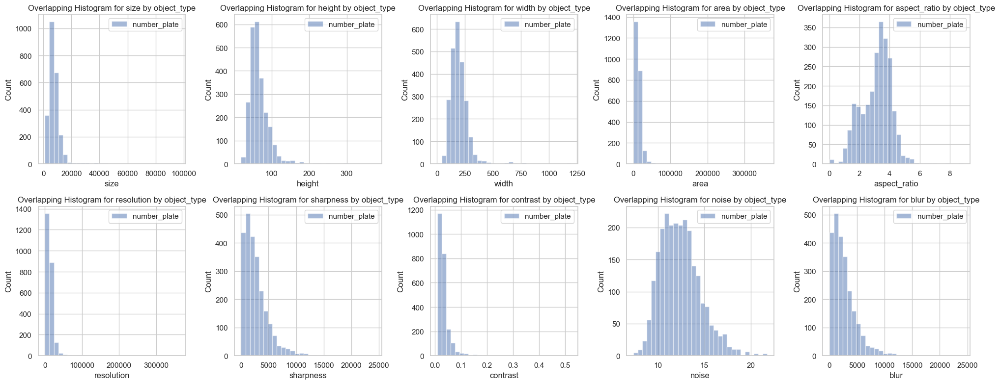

In [243]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select quantitative columns
quantitative_columns = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Select categorical column
categorical_column = 'object_type'

# Create subplots for each quantitative column
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Iterate over quantitative columns
for i, quantitative_column in enumerate(quantitative_columns):
    # Create overlapping histograms for each category in the categorical column
    for category in df[categorical_column].unique():
        axes[i].hist(df[df[categorical_column] == category][quantitative_column].dropna(), bins=30, alpha=0.5, label=category)

    axes[i].set_title(f'Overlapping Histogram for {quantitative_column} by {categorical_column}')
    axes[i].set_xlabel(quantitative_column)
    axes[i].set_ylabel('Count')
    axes[i].legend()

# Adjust layout
plt.tight_layout()
plt.show()

### Two Quantative Variables 

#### Scatter Plot

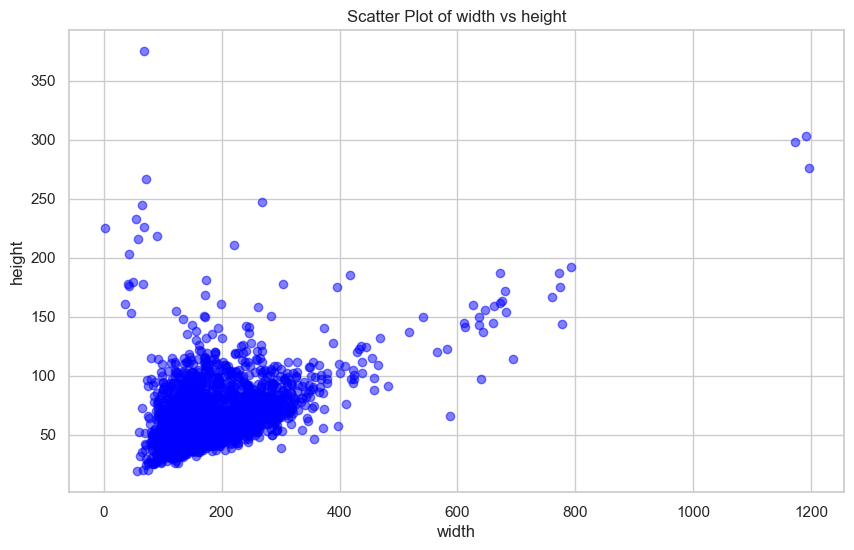

In [244]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select two quantitative columns for the scatter plot
x_variable = 'width'
y_variable = 'height'

# Create a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(df[x_variable], df[y_variable], alpha=0.5, color='blue')
plt.title(f'Scatter Plot of {x_variable} vs {y_variable}')
plt.xlabel(x_variable)
plt.ylabel(y_variable)
plt.show()

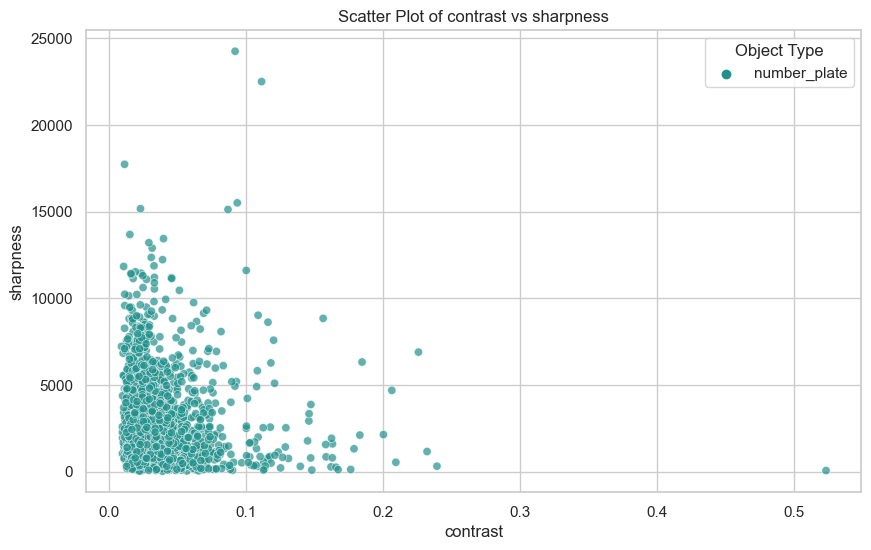

In [245]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Select two quantitative columns for the scatter plot
x_variable = 'contrast'
y_variable = 'sharpness'

# Create a scatter plot using Seaborn
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x=x_variable, y=y_variable, hue='object_type', palette='viridis', alpha=0.7)
plt.title(f'Scatter Plot of {x_variable} vs {y_variable}')
plt.xlabel(x_variable)
plt.ylabel(y_variable)
plt.legend(title='Object Type')
plt.show()

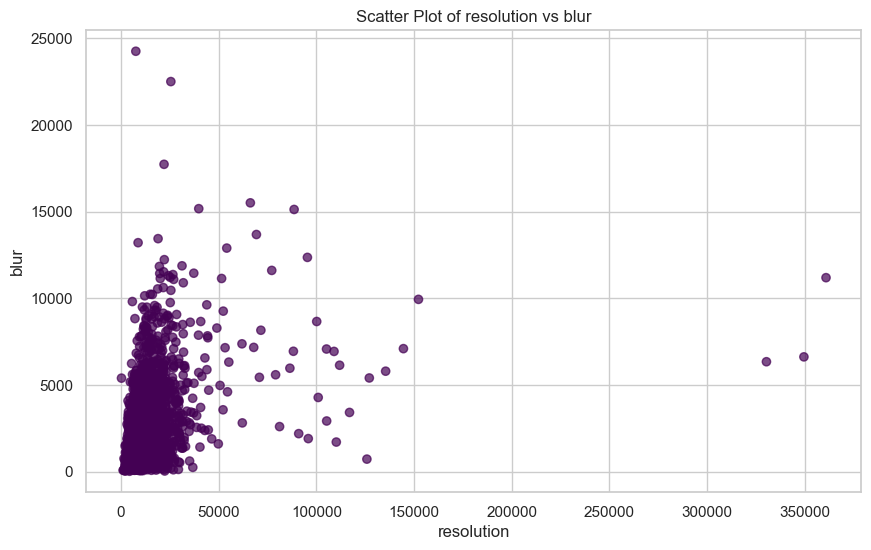

In [246]:
# Select two quantitative columns for the scatter plot
x_variable = 'resolution'
y_variable = 'blur'

# Create a scatter plot using Matplotlib
plt.figure(figsize=(10, 6))
plt.scatter(df[x_variable], df[y_variable], c=pd.factorize(df['object_type'])[0], cmap='viridis', alpha=0.7)
plt.title(f'Scatter Plot of {x_variable} vs {y_variable}')
plt.xlabel(x_variable)
plt.ylabel(y_variable)
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_1208\1805469105.py:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=df, x='area', y='aspect_ratio', palette='Set2', alpha=0.7)


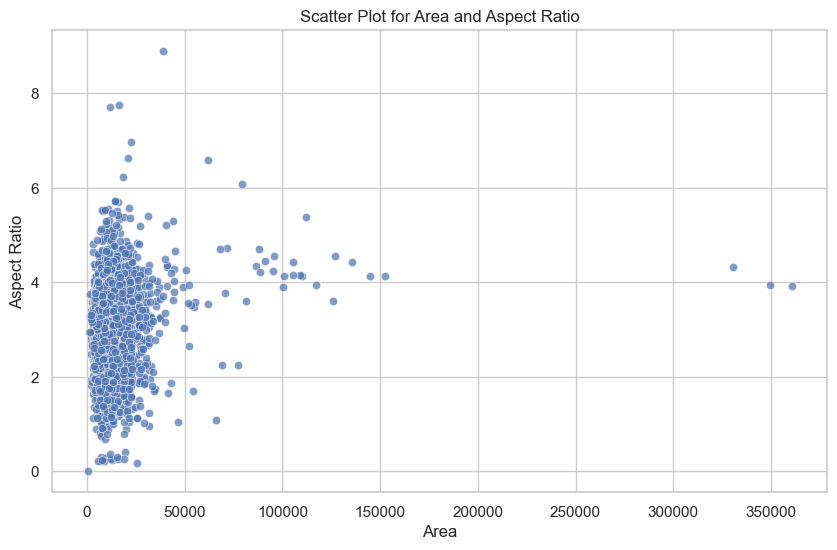

In [247]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Scatter plot for 'area' and 'aspect_ratio'
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='area', y='aspect_ratio', palette='Set2', alpha=0.7)
plt.title('Scatter Plot for Area and Aspect Ratio')
plt.xlabel('Area')
plt.ylabel('Aspect Ratio')
plt.show()

C:\Users\User\AppData\Local\Temp\ipykernel_1208\2626029016.py:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(data=df, x='size', y='noise', palette='Set2', alpha=0.7)


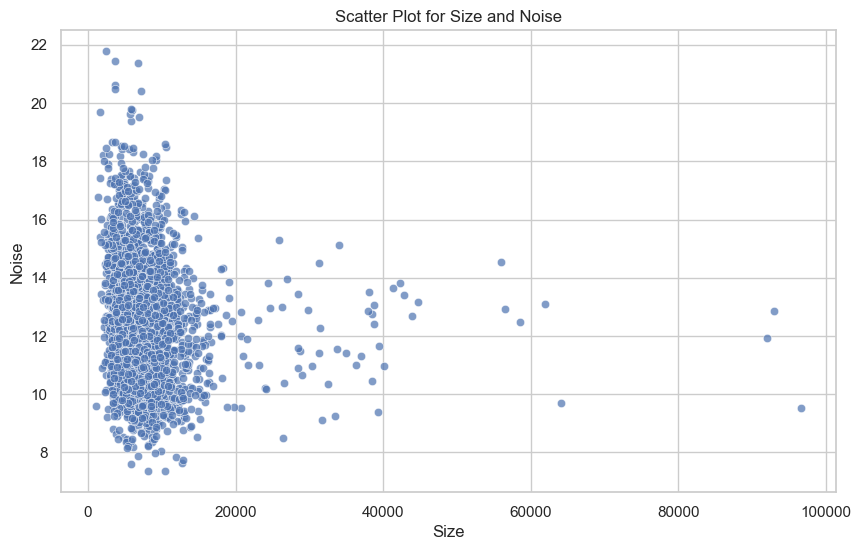

In [248]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Scatter plot for 'noise' and 'size'
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='size', y='noise', palette='Set2', alpha=0.7)
plt.title('Scatter Plot for Size and Noise')
plt.xlabel('Size')
plt.ylabel('Noise')
plt.show()

### Three or more variables 

#### Pair Plot

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

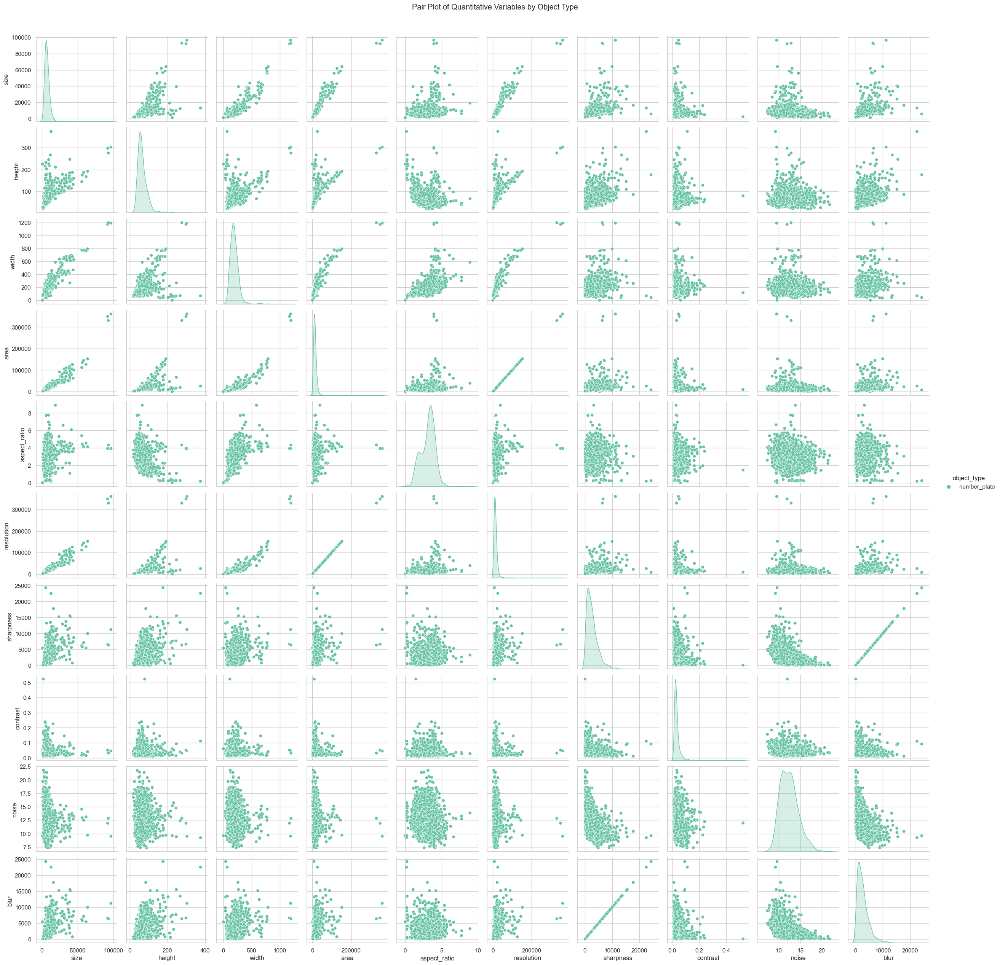

In [249]:
# Select quantitative columns for the pair plot
quantitative_columns = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Add 'object_type' for coloring
quantitative_columns_with_color = quantitative_columns + ['object_type']

# Create a pair plot
sns.pairplot(df[quantitative_columns_with_color], hue='object_type', palette='Set2', diag_kind='kde', height=2.5)
plt.suptitle('Pair Plot of Quantitative Variables by Object Type', y=1.02)
plt.show()

#### Correlation Matrix

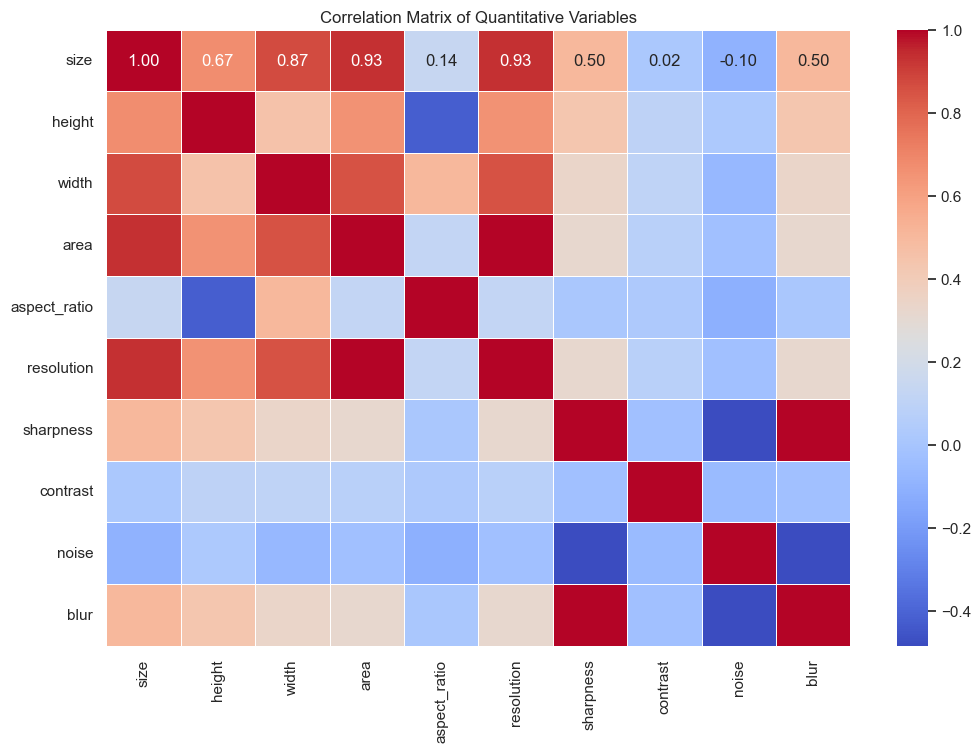

In [250]:
# Select quantitative columns for correlation matrix
quantitative_columns = ['size', 'height', 'width', 'area', 'aspect_ratio', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']

# Compute the correlation matrix
correlation_matrix = df[quantitative_columns].corr()

# Set up the matplotlib figure
plt.figure(figsize=(12, 8))

# Create a heatmap of the correlation matrix
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)

plt.title('Correlation Matrix of Quantitative Variables')
plt.show()

## Data Cleaning 

### Handling Missing Images

#### Check for Missing Images:

In [251]:
def check_missing_images(image_folder, csv_file):
    # Read CSV file with image information
    df = pd.read_csv(csv_file)

    # Create a list of valid image files
    valid_images = [file for file in os.listdir(image_folder) if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Check for missing images
    missing_images = set(df['cropped_plate_name']) - set(valid_images)
    
    if missing_images:
        print(f"Missing images: {missing_images}")
    else:
        print("No missing images found.")
        
image_folder = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"
csv_file = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates/croppedplatesadditionalinfos.csv"
check_missing_images(image_folder, csv_file)        

No missing images found.


#### Check for Missing Values Related to Images Metrics and Properties:

In [252]:
# Check for missing values in the DataFrame
missing_values = df.isnull().sum()

# Display the count of missing values for each column
print("Missing values in the DataFrame:")
print(missing_values)

# Check if there are any missing values in the DataFrame
if missing_values.sum() == 0:
    print("No missing values found.")
else:
    print("Missing values found.")

Missing values in the DataFrame:
cropped_plate_name    0
cropped_plate_path    0
plate_index           0
size                  0
height                0
width                 0
area                  0
aspect_ratio          0
image_format          0
object_type           0
image_array           0
image_array_mode      0
image_pil             0
image_mode_pil        0
resolution            0
sharpness             0
contrast              0
noise                 0
blur                  0
dtype: int64
No missing values found.


### Handling Images duplications

#### Check for Duplicate Images:

In [275]:
# Check for duplicate images based on 'cropped_plate_path'
duplicate_images = df[df.duplicated(subset=['cropped_plate_path'], keep=False)]

# Display duplicate images
if not duplicate_images.empty:
    print("Duplicate Images:")
    print(duplicate_images[['cropped_plate_name', 'cropped_plate_path']])
else:
    print("No duplicate images found.")

No duplicate images found.


In [285]:
# Function to compute perceptual hash for an image
def compute_hash(image_path):
    with Image.open(image_path) as img:
        return imagehash.phash(img)

# Apply the compute_hash function to the 'cropped_plate_path' column
df['image_hash'] = df['cropped_plate_path'].apply(compute_hash)

# Check for duplicate images based on perceptual hash
duplicate_images = df[df.duplicated(subset=['image_hash'], keep=False)]

# Display duplicate images
if not duplicate_images.empty:
    print("Duplicate Images based on Perceptual Hash:")
    print(duplicate_images[['cropped_plate_name', 'cropped_plate_path']])
else:
    print("No duplicate images found based on perceptual hash.")

No duplicate images found based on perceptual hash.


#### Check for Duplicate Values Related to Images Metrics and Properties:

In [286]:
# Check for duplicate rows in the entire DataFrame
duplicate_rows = df[df.duplicated(keep=False)]

# Display duplicate rows
if not duplicate_rows.empty:
    print("Duplicate Rows in the DataFrame:")
    print(duplicate_rows)
else:
    print("No duplicate rows found in the DataFrame.")

No duplicate rows found in the DataFrame.


### Handling Image Outliers

#### Detect outliers with Tukey's fences/ IQR Method:

Identified Outliers:
                                     cropped_plate_name  \
0                             0.jpg_cropped_plate_1.jpg   
1                             0.jpg_cropped_plate_2.jpg   
2                             0.jpg_cropped_plate_3.jpg   
10                            1.jpg_cropped_plate_1.jpg   
11                            1.jpg_cropped_plate_2.jpg   
...                                                 ...   
2416  location-voiture-mostaganem-ouedkniss-luxe-of-...   
2417             megane-limited.jpg_cropped_plate_1.jpg   
2422                     Photo4.jpg_cropped_plate_1.jpg   
2424                       qsqs.jpg_cropped_plate_1.jpg   
2433                ssdsdsfffff.jpg_cropped_plate_1.jpg   

                                     cropped_plate_path  plate_index   size  \
0     C:/Users/User/Downloads/License_Plates_of_Alge...            1  33453   
1     C:/Users/User/Downloads/License_Plates_of_Alge...            2  34949   
2     C:/Users/User/Downloads/Lic

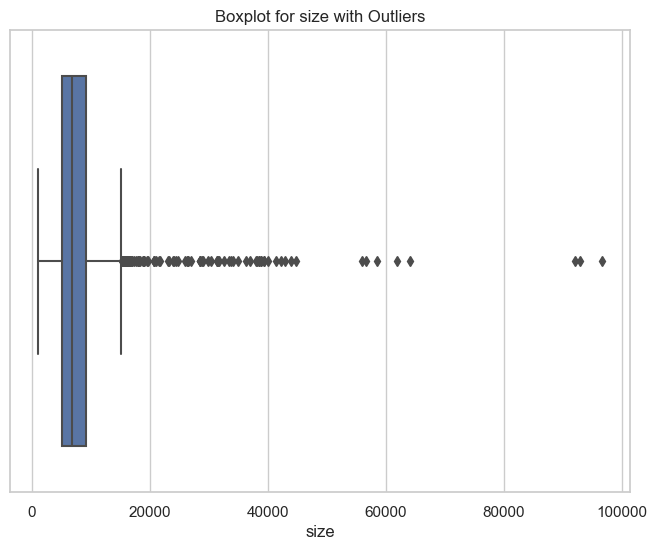

In [287]:
# Select the column for outlier detection 
column_for_outlier_detection = 'size'

# Calculate the first and third quartiles
Q1 = df[column_for_outlier_detection].quantile(0.25)
Q3 = df[column_for_outlier_detection].quantile(0.75)

# Calculate the IQR (Interquartile Range)
IQR = Q3 - Q1

# Define the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = df[(df[column_for_outlier_detection] < lower_bound) | (df[column_for_outlier_detection] > upper_bound)]

# Display the identified outliers
print("Identified Outliers:")
print(outliers)

# Visualize the distribution with boxplot
plt.figure(figsize=(8, 6))
sns.boxplot(x=df[column_for_outlier_detection])
plt.title(f'Boxplot for {column_for_outlier_detection} with Outliers')
plt.xlabel(column_for_outlier_detection)
plt.show()

#### Identify outliers using Z-scores (standard scores):

In [288]:
# Calculate Z-scores for the 'size' column
df['size_zscore'] = zscore(df['size'])

# Set a threshold for considering outliers 
threshold = 3

# Identify outliers
outliers = df[df['size_zscore'].abs() > threshold]

# Display the identified outliers
print("Identified Outliers:")
print(outliers[['cropped_plate_name', 'size', 'size_zscore']])

Identified Outliers:
                                     cropped_plate_name   size  size_zscore
0                             0.jpg_cropped_plate_1.jpg  33453     4.267216
1                             0.jpg_cropped_plate_2.jpg  34949     4.517194
2                             0.jpg_cropped_plate_3.jpg  26457     3.098203
10                            1.jpg_cropped_plate_1.jpg  34025     4.362796
11                            1.jpg_cropped_plate_2.jpg  38753     5.152832
15                          103.jpg_cropped_plate_1.jpg  42265     5.739678
26                          117.jpg_cropped_plate_1.jpg  38815     5.163192
35                           13.jpg_cropped_plate_2.jpg  55926     8.022394
36                           13.jpg_cropped_plate_3.jpg  41383     5.592298
37                           13.jpg_cropped_plate_4.jpg  29806     3.657812
100                           2.jpg_cropped_plate_1.jpg  96558    14.811893
175                          37.jpg_cropped_plate_1.jpg  38072     

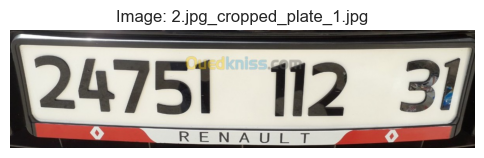

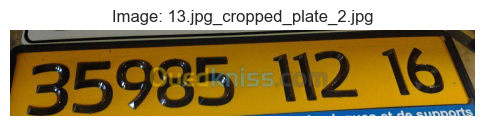

In [289]:
# Function to display specific images
def display_images(image_folder, image_names):
    for image_name in image_names:
        image_path = os.path.join(image_folder, image_name)
        image = mpimg.imread(image_path)

        plt.figure(figsize=(6, 6))
        plt.imshow(image)
        plt.title(f"Image: {image_name}")
        plt.axis('off')
        plt.show()

# List of specific image names to display
specific_images = ['2.jpg_cropped_plate_1.jpg', '13.jpg_cropped_plate_2.jpg']

# Display specific images
display_images(image_folder, specific_images)

#### Detect outliers with Kernel Density Estimation:

C:\Users\User\AppData\Local\Temp\ipykernel_1208\3082755041.py:6: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.kdeplot(data=df, x='size', fill=True, palette='viridis')
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


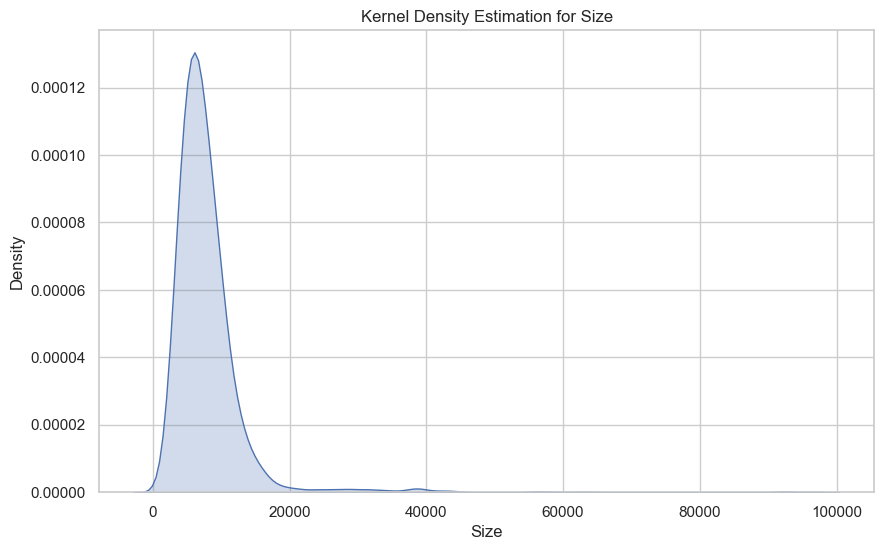

In [290]:
# Set a common style for Seaborn
sns.set(style="whitegrid")

# Create kernel density plot for 'size'
plt.figure(figsize=(10, 6))
sns.kdeplot(data=df, x='size', fill=True, palette='viridis')
plt.title('Kernel Density Estimation for Size')
plt.xlabel('Size')
plt.ylabel('Density')

plt.show()

#### Identify outliers with Isolation Forest:

C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


Identified Outliers (Isolation Forest):
                                     cropped_plate_name   size
1                             0.jpg_cropped_plate_2.jpg  34949
11                            1.jpg_cropped_plate_2.jpg  38753
15                          103.jpg_cropped_plate_1.jpg  42265
26                          117.jpg_cropped_plate_1.jpg  38815
35                           13.jpg_cropped_plate_2.jpg  55926
36                           13.jpg_cropped_plate_3.jpg  41383
100                           2.jpg_cropped_plate_1.jpg  96558
175                          37.jpg_cropped_plate_1.jpg  38072
181                           4.jpg_cropped_plate_2.jpg  38429
182                           4.jpg_cropped_plate_3.jpg  36319
193                   444444446.jpg_cropped_plate_1.jpg  38446
202                          47.jpg_cropped_plate_1.jpg  44703
203                          47.jpg_cropped_plate_2.jpg  40093
227                           5.jpg_cropped_plate_1.jpg  92081
2129  59626221_

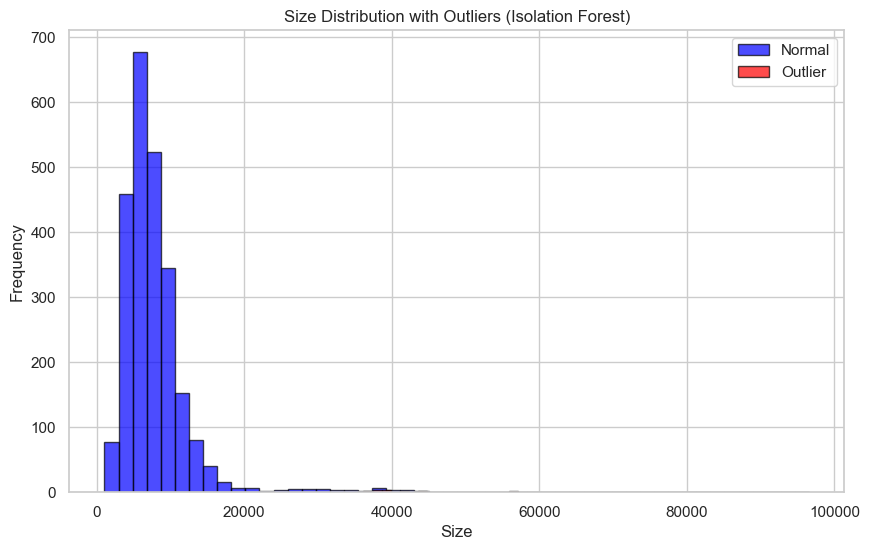

In [291]:
# Extract the 'size' feature for isolation forest
X = df[['size']]

# Initialize the Isolation Forest model
iso_forest = IsolationForest(contamination=0.01, random_state=42)  

# Fit the model to the data
iso_forest.fit(X)

# Predict outliers (anomalies)
outliers = iso_forest.predict(X)

# Add the outlier predictions to the DataFrame
df['is_outlier'] = outliers

# Display the identified outliers
print("Identified Outliers (Isolation Forest):")
print(df[df['is_outlier'] == -1][['cropped_plate_name', 'size']])

# Plot the size distribution with outliers highlighted
plt.figure(figsize=(10, 6))
plt.hist(X['size'], bins=50, color='blue', alpha=0.7, label='Normal', edgecolor='black')
plt.hist(X[df['is_outlier'] == -1]['size'], bins=50, color='red', alpha=0.7, label='Outlier', edgecolor='black')
plt.title('Size Distribution with Outliers (Isolation Forest)')
plt.xlabel('Size')
plt.ylabel('Frequency')
plt.legend()
plt.show()

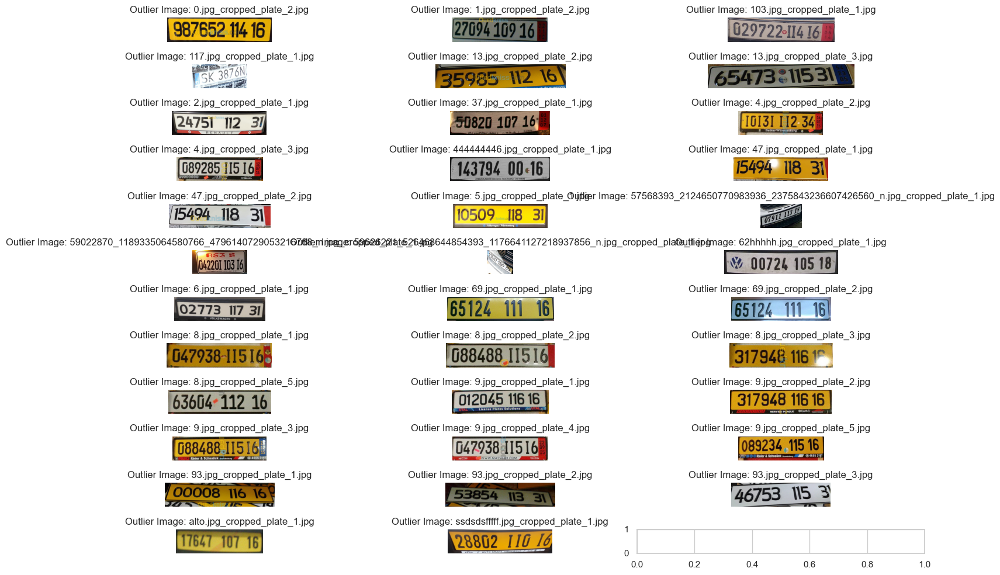

In [292]:

# Define the path to the directory containing the images
image_folder ="C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# List of identified outlier images
outlier_images = [
    "0.jpg_cropped_plate_2.jpg",
    "1.jpg_cropped_plate_2.jpg",
    "103.jpg_cropped_plate_1.jpg",
    "117.jpg_cropped_plate_1.jpg",
    "13.jpg_cropped_plate_2.jpg",
    "13.jpg_cropped_plate_3.jpg",
    "2.jpg_cropped_plate_1.jpg",
    "37.jpg_cropped_plate_1.jpg",
    "4.jpg_cropped_plate_2.jpg",
    "4.jpg_cropped_plate_3.jpg",
    "444444446.jpg_cropped_plate_1.jpg",
    "47.jpg_cropped_plate_1.jpg",
    "47.jpg_cropped_plate_2.jpg",
    "5.jpg_cropped_plate_1.jpg",
    "57568393_2124650770983936_2375843236607426560_n.jpg_cropped_plate_1.jpg",
    "59022870_1189335064580766_4796140729053216768_n.jpg_cropped_plate_1.jpg",
    "59626221_526468644854393_1176641127218937856_n.jpg_cropped_plate_1.jpg",
    "62hhhhh.jpg_cropped_plate_1.jpg",
    "6.jpg_cropped_plate_1.jpg",
    "69.jpg_cropped_plate_1.jpg",
    "69.jpg_cropped_plate_2.jpg",
    "8.jpg_cropped_plate_1.jpg",
    "8.jpg_cropped_plate_2.jpg",
    "8.jpg_cropped_plate_3.jpg",
    "8.jpg_cropped_plate_5.jpg",
    "9.jpg_cropped_plate_1.jpg",
    "9.jpg_cropped_plate_2.jpg",
    "9.jpg_cropped_plate_3.jpg",
    "9.jpg_cropped_plate_4.jpg",
    "9.jpg_cropped_plate_5.jpg",
    "93.jpg_cropped_plate_1.jpg",
    "93.jpg_cropped_plate_2.jpg",
    "93.jpg_cropped_plate_3.jpg",
    "alto.jpg_cropped_plate_1.jpg",
    "ssdsdsfffff.jpg_cropped_plate_1.jpg",
    ]

# Set the number of columns for subplot
num_columns = 3

# Display each outlier image
fig, axs = plt.subplots(len(outlier_images) // num_columns + 1, num_columns, figsize=(15, 10))

for i, image_name in enumerate(outlier_images):
    image_path = os.path.join(image_folder, image_name)
    image = Image.open(image_path)

    # Determine the subplot position
    row = i // num_columns
    col = i % num_columns

    # Display the image
    axs[row, col].imshow(image)
    axs[row, col].set_title(f"Outlier Image: {image_name}")
    axs[row, col].axis('off')

# Adjust layout for better visualization
plt.tight_layout()
plt.show()

#### Detect outliers using KNN (k-nearest neighbors) distance:

Identified Outliers using KNN:
                       cropped_plate_name   size
35             13.jpg_cropped_plate_2.jpg  55926
100             2.jpg_cropped_plate_1.jpg  96558
227             5.jpg_cropped_plate_1.jpg  92081
2367           93.jpg_cropped_plate_3.jpg  64038
2433  ssdsdsfffff.jpg_cropped_plate_1.jpg  92914


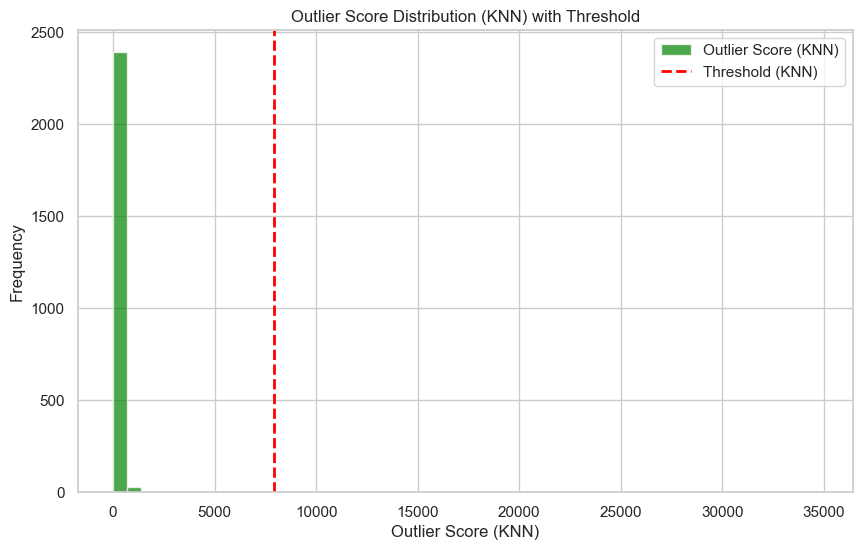

In [259]:
# Extract the 'size' feature for KNN
X_knn = df[['size']]

# Train the KNN model
knn_model = NearestNeighbors(n_neighbors=5)  
knn_model.fit(X_knn)

# Compute distances to k-nearest neighbors for each data point
distances, _ = knn_model.kneighbors(X_knn)

# Use the maximum distance as the outlier score
outlier_scores = distances.max(axis=1)

# Establish Threshold 
threshold_knn = 7915.691834	

# Identify outliers
df['is_outlier_knn'] = outlier_scores > threshold_knn

# Display Identified Outliers using KNN
identified_outliers_knn = df[df['is_outlier_knn']][['cropped_plate_name', 'size']]
print("Identified Outliers using KNN:")
print(identified_outliers_knn)

# Plot the distribution of outlier scores
plt.figure(figsize=(10, 6))
plt.hist(outlier_scores, bins=50, color='green', alpha=0.7, label='Outlier Score (KNN)')
plt.axvline(threshold_knn, color='red', linestyle='dashed', linewidth=2, label='Threshold (KNN)')
plt.title('Outlier Score Distribution (KNN) with Threshold')
plt.xlabel('Outlier Score (KNN)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

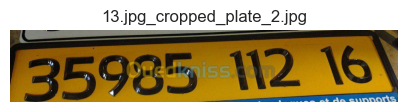

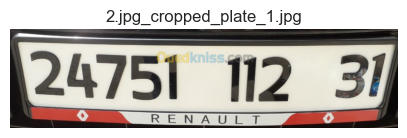

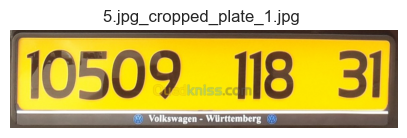

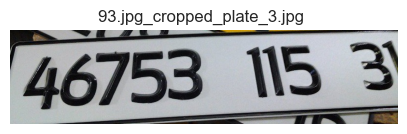

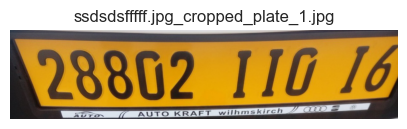

In [260]:
# List of identified outlier images
outlier_images = [
    "13.jpg_cropped_plate_2.jpg",
    "2.jpg_cropped_plate_1.jpg",
    "5.jpg_cropped_plate_1.jpg ",
    "93.jpg_cropped_plate_3.jpg ",
    "ssdsdsfffff.jpg_cropped_plate_1.jpg"
]

# Directory where the images are located
image_directory = "C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates"

# Display each identified outlier image
for image_name in outlier_images:
    image_path = os.path.join(image_directory, image_name)
    img = mpimg.imread(image_path)
    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title(image_name)
    plt.axis('off')
    plt.show()

### Detecting outliers using Local Outlier Factor (LOF) algorithm:

Identified Outliers using LOF:
                                     cropped_plate_name   size
28                           12.jpg_cropped_plate_2.jpg   1348
34                           13.jpg_cropped_plate_1.jpg   1080
35                           13.jpg_cropped_plate_2.jpg  55926
100                           2.jpg_cropped_plate_1.jpg  96558
111                       21921.jpg_cropped_plate_2.jpg   1741
151                          29.jpg_cropped_plate_1.jpg   1688
227                           5.jpg_cropped_plate_1.jpg  92081
239   51333475_393015128174431_3287617312684769280_n...  19050
367   56691301_2259816557410899_7335034393234243584_...  18117
422   57109821_1061989477325487_7960943524923310080_...   1904
428   57121009_444606543013578_5159273715644497920_n...   1632
662                          58.jpg_cropped_plate_1.jpg  18059
955   58543596_400883564087614_499721953150500864_n....  18319
1552  59219965_289107908691897_6565630451430457344_n...   1655
1677  59306072_771881119

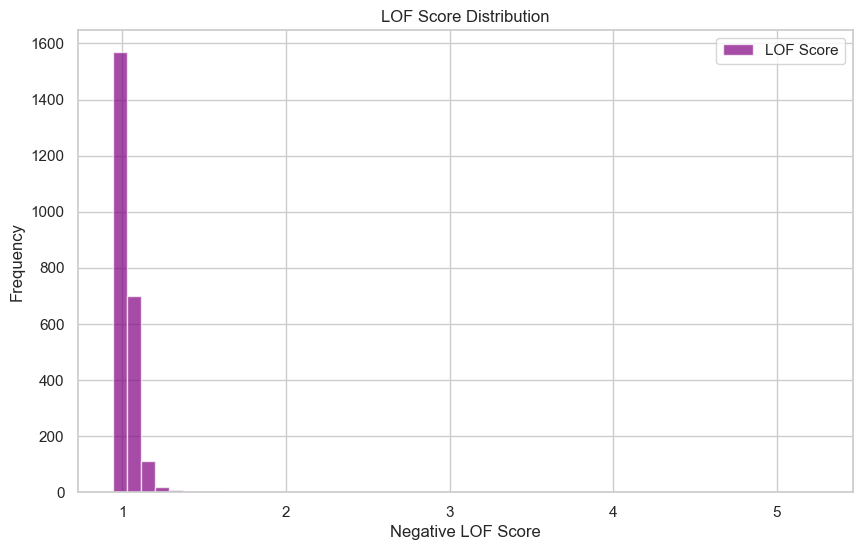

In [261]:
# Extract the 'size' feature for LOF
X_lof = df[['size']]

# Initialize the LOF model
lof_model = LocalOutlierFactor(contamination=0.01)

# Fit the model to the data
outlier_labels = lof_model.fit_predict(X_lof)

# Identify outliers (anomalies)
df['is_outlier_lof'] = outlier_labels == -1

# Display Identified Outliers using LOF with corrected 'size' values
identified_outliers_lof = df[df['is_outlier_lof']][['cropped_plate_name', 'size']]
print("Identified Outliers using LOF:")
print(identified_outliers_lof)

# Print LOF scores for identified outliers
outliers_lof_scores = -lof_model.negative_outlier_factor_[df['is_outlier_lof']]
print("LOF Scores for Identified Outliers:")
print(outliers_lof_scores)

# Sort identified outliers by LOF scores in descending order
sorted_outliers_lof = identified_outliers_lof.copy()
sorted_outliers_lof['lof_score'] = outliers_lof_scores
sorted_outliers_lof = sorted_outliers_lof.sort_values(by='lof_score', ascending=False)

# Display sorted outliers
print("Identified Outliers using LOF (Sorted by LOF Score):")
print(sorted_outliers_lof[['cropped_plate_name', 'size', 'lof_score']])

# Plot the LOF scores distribution
plt.figure(figsize=(10, 6))
plt.hist(-lof_model.negative_outlier_factor_, bins=50, color='purple', alpha=0.7, label='LOF Score')
plt.title('LOF Score Distribution')
plt.xlabel('Negative LOF Score')
plt.ylabel('Frequency')
plt.legend()
plt.show()

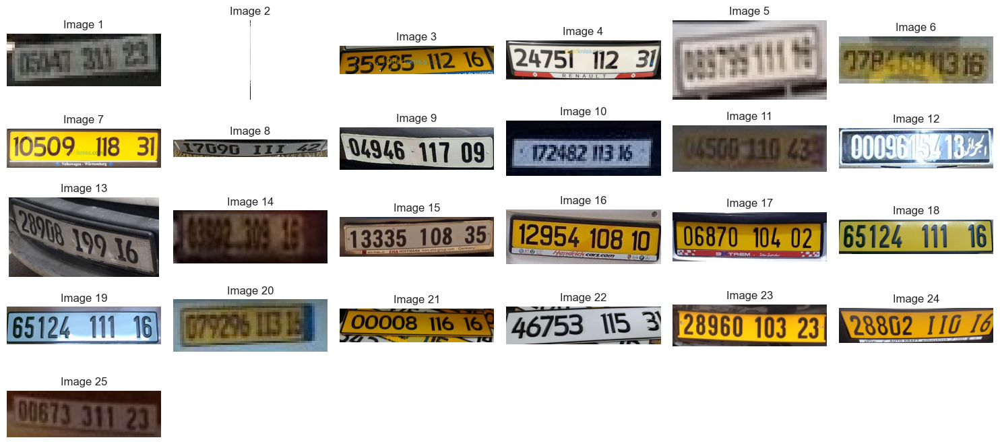

In [262]:
# Function to load and display images
def display_images(image_paths):
    num_images = len(image_paths)
    num_rows = ceil(num_images / 6)  # 6 images per row, adjust as needed
    plt.figure(figsize=(15, 7))
    
    for i, path in enumerate(image_paths, 1):
        plt.subplot(num_rows, 6, i)
        img = Image.open(path)
        plt.imshow(img)
        plt.title(f"Image {i}")
        plt.axis("off")
    
    plt.tight_layout()
    plt.show()

# Extract paths of identified outlier images
outlier_image_paths = df[df['is_outlier_lof']]['cropped_plate_path']

# Display identified outlier images
display_images(outlier_image_paths)

In [263]:
# Load DataFrame contains necessary informations for analysis about cropped car number plates images
df = pd.read_csv("C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates/croppedplatesadditionalinfos.csv")

### Handling Image Quality Issues

#### Check for images with low quality:

Low Quality Images:
                                     cropped_plate_name  resolution  \
158                         302.jpg_cropped_plate_1.jpg     15326.0   
587   57540102_872814479727604_7657336869499174912_n...      3570.0   
1619  59295527_159667578390685_8711076914837585920_n...      9520.0   
1628  59295691_748072842256481_8633737425853612032_n...      5538.0   
1675  59306034_1315968218560308_7744977532599926784_...      7663.0   
1676  59306045_506258839909163_2539013270430285824_n...      4585.0   

        sharpness  contrast      noise         blur  
158   1940.520211  0.009600  12.205878  1940.520211  
587   1039.239538  0.009467  11.287186  1039.239538  
1619  7224.468990  0.008800  10.774095  7224.468990  
1628  2272.998511  0.009467  12.384557  2272.998511  
1675  4376.028196  0.009600  11.508526  4376.028196  
1676  2587.610012  0.009467  11.519775  2587.610012  


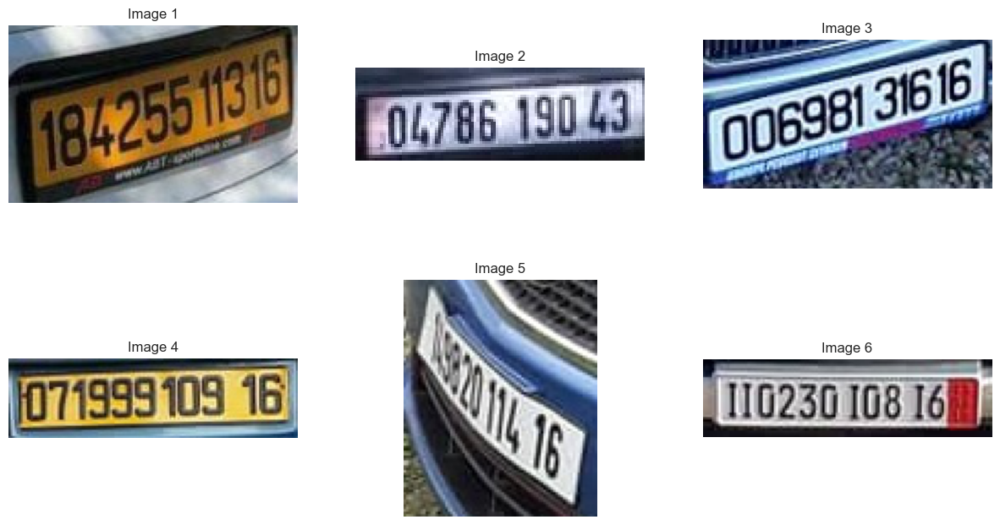

In [307]:
# Set threshold values for image quality metrics
threshold_resolution = 225 
threshold_sharpness = 18   
threshold_contrast = 0.01    


# Filter images with low quality based on threshold values
low_quality_images = df[
    (df['resolution'] < threshold_resolution) |
    (df['sharpness'] < threshold_sharpness) |
    (df['contrast'] < threshold_contrast)
]
	
# Display information about low-quality images
if not low_quality_images.empty:
    print("Low Quality Images:")
    print(low_quality_images[['cropped_plate_name', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']])

    # Get paths of low-quality images
    low_quality_image_paths = low_quality_images['cropped_plate_path'].tolist()[:6]  # Displaying up to 6 images

    # Display low-quality images
    display_images([os.path.join(images_folder, image_path) for image_path in low_quality_image_paths])
else:
    print("No low-quality images found.")

#### Dealing with images with low quality:

Enhancing and Displaying Low Quality Images:
                                     cropped_plate_name  resolution  \
158                         302.jpg_cropped_plate_1.jpg     15326.0   
587   57540102_872814479727604_7657336869499174912_n...      3570.0   
1619  59295527_159667578390685_8711076914837585920_n...      9520.0   
1628  59295691_748072842256481_8633737425853612032_n...      5538.0   
1675  59306034_1315968218560308_7744977532599926784_...      7663.0   
1676  59306045_506258839909163_2539013270430285824_n...      4585.0   

        sharpness  contrast      noise         blur  
158   1940.520211  0.009600  12.205878  1940.520211  
587   1039.239538  0.009467  11.287186  1039.239538  
1619  7224.468990  0.008800  10.774095  7224.468990  
1628  2272.998511  0.009467  12.384557  2272.998511  
1675  4376.028196  0.009600  11.508526  4376.028196  
1676  2587.610012  0.009467  11.519775  2587.610012  


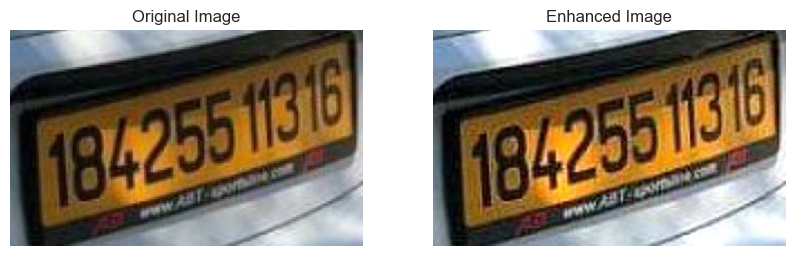

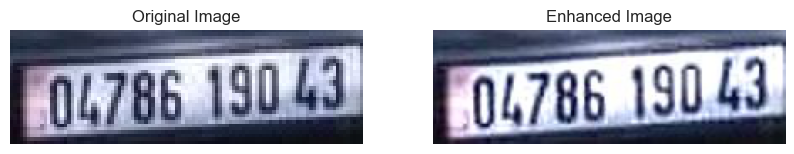

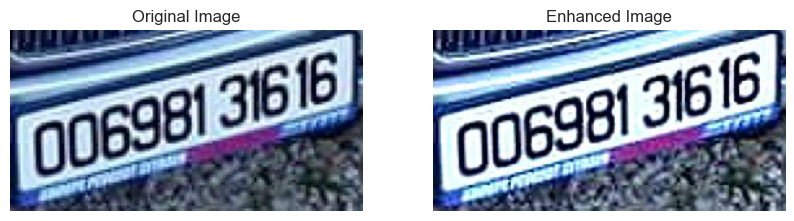

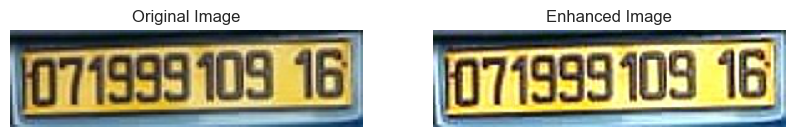

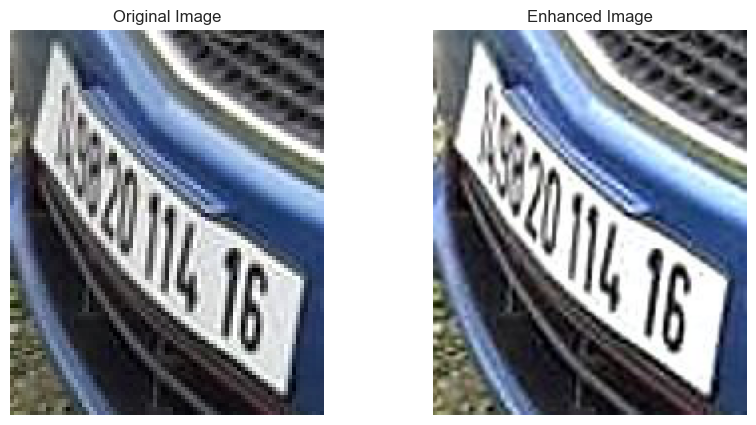

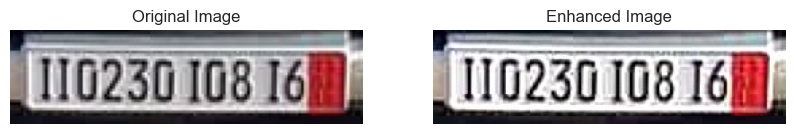

In [311]:
# Function to enhance image quality
def enhance_image_quality(image_path, output_folder):
    with Image.open(image_path) as img:
        # Resize the image to a higher resolution
        new_size = (img.width * 2, img.height * 2) 
        resized_img = img.resize(new_size, resample=Image.BICUBIC)

        # Apply sharpening filter
        sharpened_img = resized_img.filter(ImageFilter.SHARPEN)

        # Adjust contrast
        contrast_img = sharpened_img.point(lambda x: x * 1.2) 

        # Save the enhanced image with the same name in the output folder
        output_path = os.path.join(output_folder, os.path.basename(image_path))
        contrast_img.save(output_path)

        # Return the paths of the original and enhanced images
        return image_path, output_path

# Set threshold values for image quality metrics
threshold_resolution = 225 
threshold_sharpness = 18   
threshold_contrast = 0.01

# Folder to save enhanced images
enhanced_folder = "enhanced_images"
os.makedirs(enhanced_folder, exist_ok=True)

# Function to display images side by side
def display_images_side_by_side(original_path, enhanced_path):
    plt.figure(figsize=(10, 5))
    
    # Original Image
    plt.subplot(1, 2, 1)
    original_img = mpimg.imread(original_path)
    plt.imshow(original_img)
    plt.title('Original Image')
    plt.axis('off')
    
    # Enhanced Image
    plt.subplot(1, 2, 2)
    enhanced_img = mpimg.imread(enhanced_path)
    plt.imshow(enhanced_img)
    plt.title('Enhanced Image')
    plt.axis('off')
    
    plt.show()

# Filter images with low quality based on threshold values
low_quality_images = df[
    (df['resolution'] < threshold_resolution) |
    (df['sharpness'] < threshold_sharpness) |
    (df['contrast'] < threshold_contrast)
]

# Display information about low-quality images
if not low_quality_images.empty:
    print("Enhancing and Displaying Low Quality Images:")
    print(low_quality_images[['cropped_plate_name', 'resolution', 'sharpness', 'contrast', 'noise', 'blur']])

    # Enhance and display low-quality images in the 'enhanced_images' folder
    for _, row in low_quality_images.iterrows():
        input_path = os.path.join(images_folder, row['cropped_plate_path'])
        original_path, enhanced_path = enhance_image_quality(input_path, enhanced_folder)
        
        # Display the original and enhanced images side by side
        display_images_side_by_side(original_path, enhanced_path)
else:
    print("No low-quality images found.")

###  Handling Blurry Images

#### Check for blurry images:

Blurry Images:
                                     cropped_plate_name          blur
203                          47.jpg_cropped_plate_2.jpg  15129.915580
214                      47rrrr.jpg_cropped_plate_1.jpg  22511.768081
597   57568393_2124650770983936_2375843236607426560_...  12900.743988
698   58375516_2269694053291714_8890029935565996032_...  17736.249093
1454  59022870_1189335064580766_4796140729053216768_...  13684.309882
1476  59093791_135792064170964_8195409908485586944_n...  13211.918525
1660  59301560_350247582506268_8593736582949765120_n...  13445.350818
1958  59468500_446158832821380_8525194720291323904_n...  24262.491259
2025  59529597_2290834354307327_2206891661408075776_...  15176.265875
2129  59626221_526468644854393_1176641127218937856_n...  15512.066557


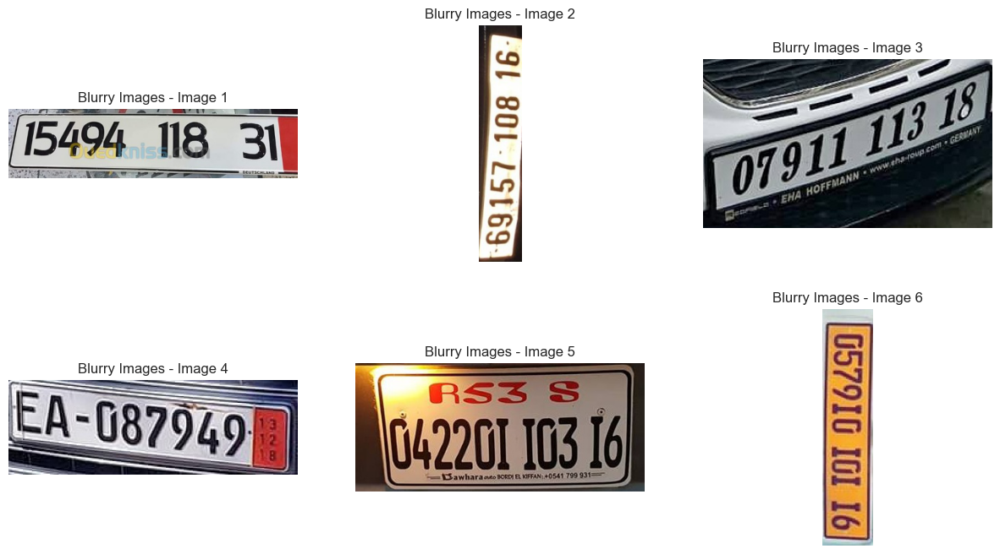

In [339]:
# Function to calculate the variance of Laplacian
def calculate_blur(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

# Set threshold for blur
threshold_blur_variance = 12500
blurry_folder = "blurry_images"
os.makedirs(blurry_folder, exist_ok=True)

# Function to display images
def display_images(image_paths, title):
    plt.figure(figsize=(15, 8))
    for i, image_path in enumerate(image_paths, 1):
        plt.subplot(2, 3, i)
        img = mpimg.imread(image_path)
        plt.imshow(img)
        plt.title(f"{title} - Image {i}")
        plt.axis('off')
    plt.show()

# Filter images with low quality based on blur
blurry_images = df[df['blur'].apply(lambda x: x > threshold_blur_variance)]

# Display information about blurry images
if not blurry_images.empty:
    print("Blurry Images:")
    print(blurry_images[['cropped_plate_name', 'blur']])

    # Get paths of blurry images
    blurry_image_paths = blurry_images['cropped_plate_path'].tolist()[:6]  # Displaying up to 6 images

    # Display blurry images
    display_images([os.path.join(images_folder, image_path) for image_path in blurry_image_paths], "Blurry Images")

    # Copy blurry images to 'blurry_images' folder
    for image_path in blurry_image_paths:
        shutil.copy(os.path.join(images_folder, image_path), os.path.join(blurry_folder, os.path.basename(image_path)))
else:
    print("No blurry images found.")

#### Dealing with blurry images:

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\47.jpg_cropped_plate_2.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\47.jpg_cropped_plate_2.jpg


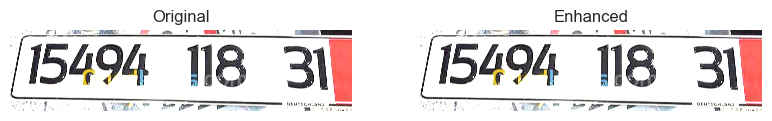

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\47rrrr.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\47rrrr.jpg_cropped_plate_1.jpg


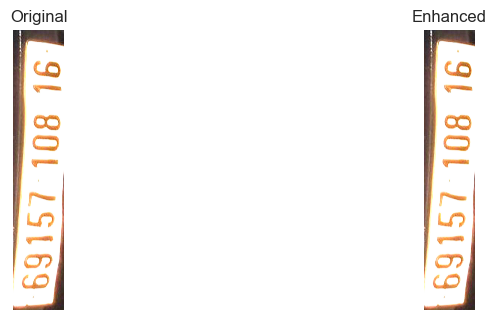

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\57568393_2124650770983936_2375843236607426560_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\57568393_2124650770983936_2375843236607426560_n.jpg_cropped_plate_1.jpg


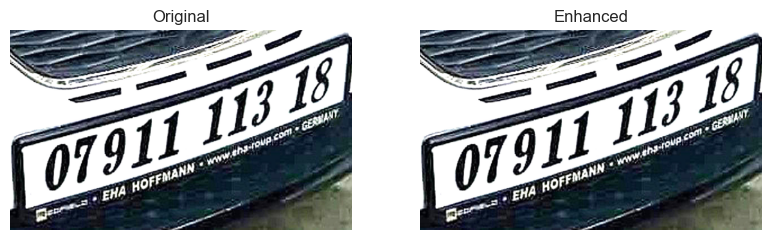

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\58375516_2269694053291714_8890029935565996032_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\58375516_2269694053291714_8890029935565996032_n.jpg_cropped_plate_1.jpg


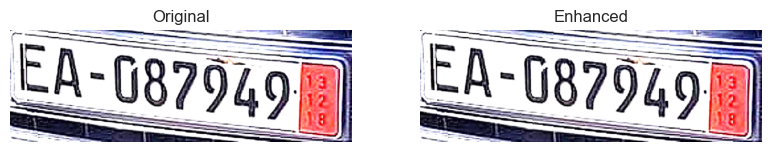

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59022870_1189335064580766_4796140729053216768_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59022870_1189335064580766_4796140729053216768_n.jpg_cropped_plate_1.jpg


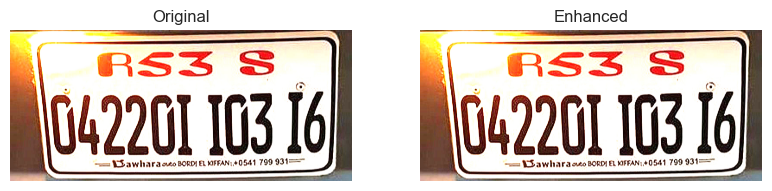

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59093791_135792064170964_8195409908485586944_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59093791_135792064170964_8195409908485586944_n.jpg_cropped_plate_1.jpg


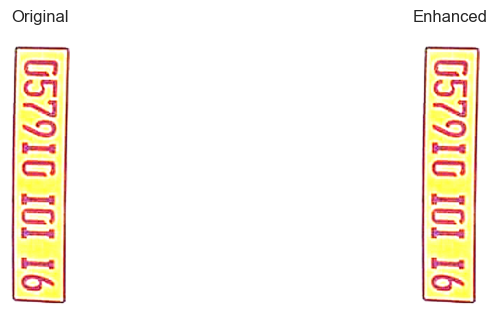

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59301560_350247582506268_8593736582949765120_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59301560_350247582506268_8593736582949765120_n.jpg_cropped_plate_1.jpg


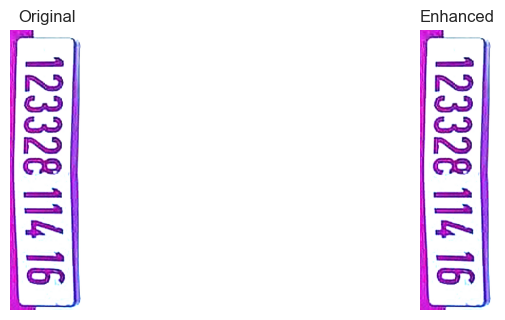

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59468500_446158832821380_8525194720291323904_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59468500_446158832821380_8525194720291323904_n.jpg_cropped_plate_1.jpg


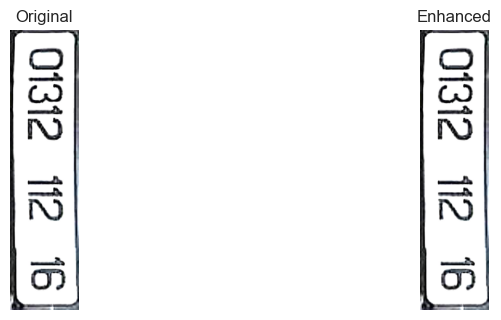

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59529597_2290834354307327_2206891661408075776_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59529597_2290834354307327_2206891661408075776_n.jpg_cropped_plate_1.jpg


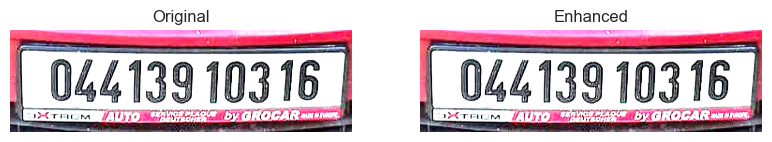

Original Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59626221_526468644854393_1176641127218937856_n.jpg_cropped_plate_1.jpg
Enhanced Image Path: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59626221_526468644854393_1176641127218937856_n.jpg_cropped_plate_1.jpg


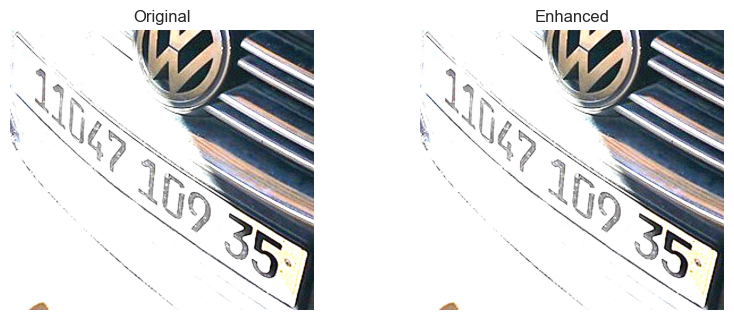

In [351]:
# Function to calculate the variance of Laplacian
def calculate_blur(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

# Set threshold for blur
threshold_blur_variance = 12500

# Function to enhance image quality
def enhance_image_quality(image_path, output_path):
    # Open the image
    with Image.open(image_path) as img:
        # Resize the image to a higher resolution
        new_size = (img.width * 2, img.height * 2)  # Example: Increase resolution by doubling dimensions
        resized_img = img.resize(new_size, resample=Image.BICUBIC)

        # Apply sharpening filter
        sharpened_img = resized_img.filter(ImageFilter.SHARPEN)

        # Adjust contrast
        contrast_img = sharpened_img.point(lambda x: x * 1.2)  # Example: Increase contrast by 20%

        # Save the enhanced image with the same name as the original one
        contrast_img.save(output_path)

# Filter images with low quality based on blur
blurry_images = df[df['blur'].apply(lambda x: x > threshold_blur_variance)]


# Enhance and save original images in the same folder with the same name
for index, row in blurry_images.iterrows():
    image_path = os.path.join(images_folder, row['cropped_plate_path'])
    enhanced_image_path = os.path.join(images_folder, f"{os.path.basename(image_path)}")

    # Enhance image quality
    enhance_image_quality(image_path, enhanced_image_path)

    # Print paths for debugging
    print("Original Image Path:", image_path)
    print("Enhanced Image Path:", enhanced_image_path)

    # Replace backslashes with forward slashes in enhanced_image_path
    enhanced_image_path = enhanced_image_path.replace("\\", "/")

    # Display original and enhanced images
    display_images([image_path, enhanced_image_path], ["Original", "Enhanced"])

### Handling Noisy images 

#### Check for noisy images:

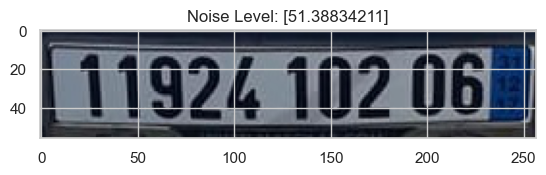

Noisy image saved: noisy_images\58440125_132175271263741_769600801629798400_n.jpg_cropped_plate_1.jpg


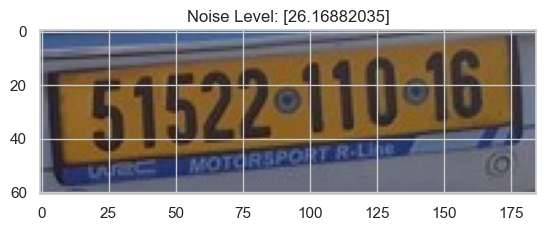

Noisy image saved: noisy_images\59285444_504046003463977_4342300206423867392_n.jpg_cropped_plate_1.jpg


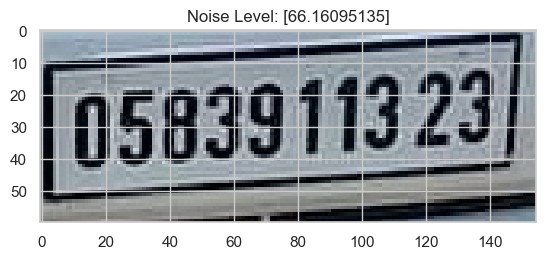

Noisy image saved: noisy_images\54436735_153725392299345_8661339170620309504_n.jpg_cropped_plate_1.jpg


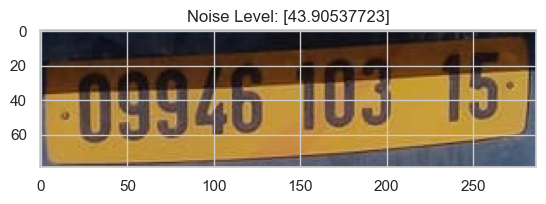

Noisy image saved: noisy_images\53435107_590783051347081_3736495777992671232_n.jpg_cropped_plate_1.jpg


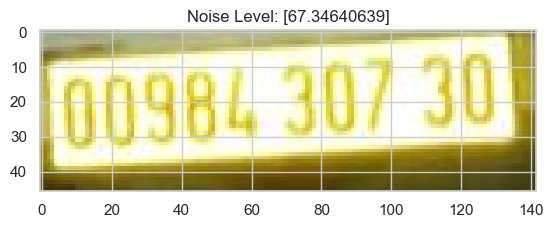

Noisy image saved: noisy_images\59320184_859135131098920_8649512106292412416_n.jpg_cropped_plate_1.jpg


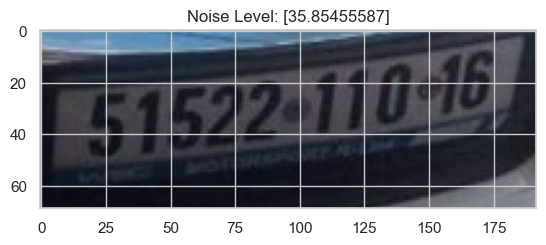

Noisy image saved: noisy_images\58917078_504045246797386_8245926459122647040_n.jpg_cropped_plate_1.jpg


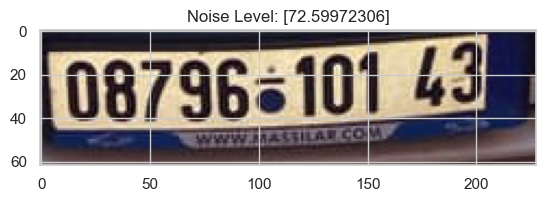

Noisy image saved: noisy_images\58543513_2028007327503933_8400285797034491904_n.jpg_cropped_plate_1.jpg


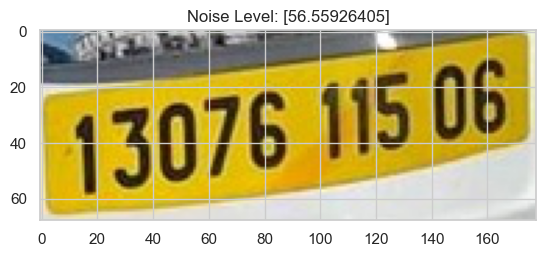

Noisy image saved: noisy_images\59376050_2254984904741317_7214982566888079360_n.jpg_cropped_plate_1.jpg


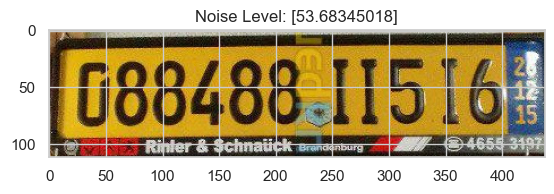

Noisy image saved: noisy_images\9.jpg_cropped_plate_3.jpg


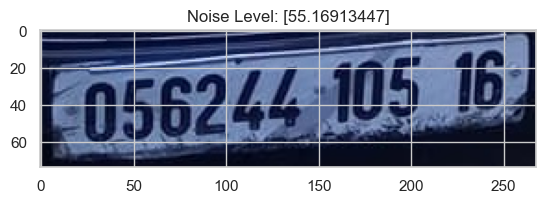

Noisy image saved: noisy_images\59609856_2235161320127219_5232243358872633344_n.jpg_cropped_plate_1.jpg


In [355]:
# Define a noise threshold
noise_threshold = 2.124534

# Function to calculate noise level in an image
def calculate_noise(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    noise_level = cv2.meanStdDev(gray_image)[1][0]
    return noise_level

# Sample 10 images for noise inspection
sample_images = random.sample(df['cropped_plate_path'].tolist(), 10)

# Create a folder to save noisy images
noisy_folder = "noisy_images"
os.makedirs(noisy_folder, exist_ok=True)

# Display images, calculate noise levels, and save noisy ones
for image_path in sample_images:
    original_image = plt.imread(os.path.join(images_folder, image_path))
    noise_level = calculate_noise(original_image)

    # Display image and noise level
    plt.imshow(original_image)
    plt.title(f"Noise Level: {noise_level}")
    plt.show()

    # Save the noisy image with the same name if noise level exceeds the threshold
    if noise_level > noise_threshold:
        noisy_image_path = os.path.join(noisy_folder, os.path.basename(image_path))
        plt.imsave(noisy_image_path, original_image)
        print(f"Noisy image saved: {noisy_image_path}")

#### Dealing with noisy images:

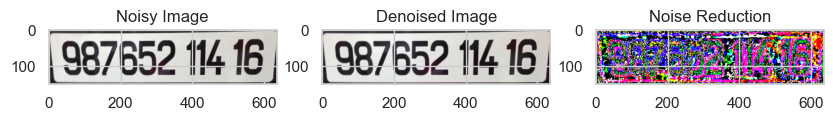

Denoised image saved: denoised_images\0.jpg_cropped_plate_1.jpg


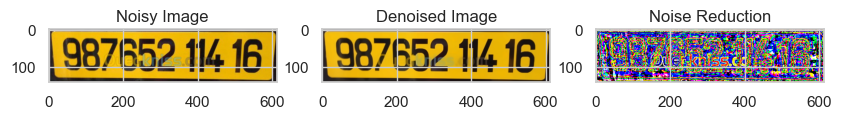

Denoised image saved: denoised_images\0.jpg_cropped_plate_2.jpg


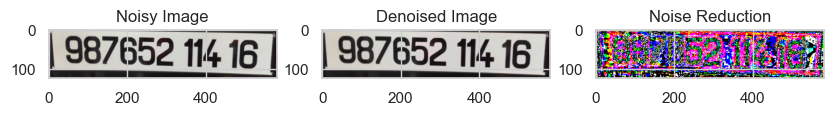

Denoised image saved: denoised_images\0.jpg_cropped_plate_3.jpg


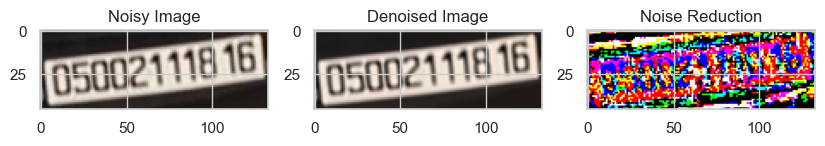

Denoised image saved: denoised_images\0220.jpg_cropped_plate_1.jpg


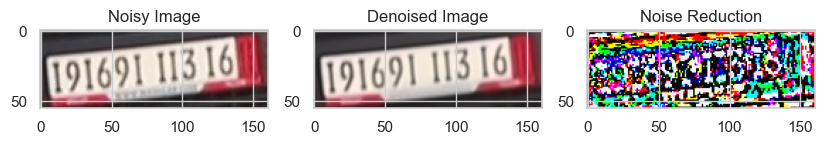

Denoised image saved: denoised_images\0297.jpg_cropped_plate_1.jpg


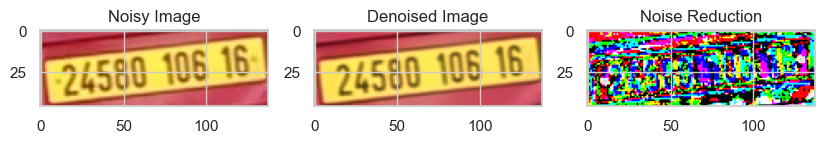

Denoised image saved: denoised_images\0511.jpg_cropped_plate_1.jpg


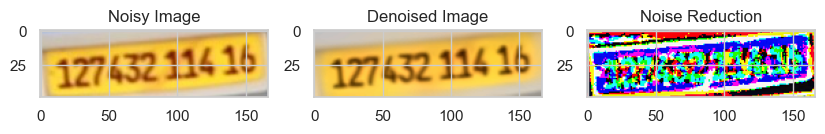

Denoised image saved: denoised_images\0560.jpg_cropped_plate_1.jpg


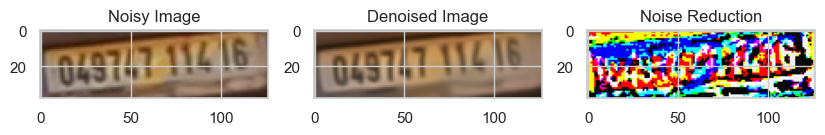

Denoised image saved: denoised_images\0807.jpg_cropped_plate_1.jpg


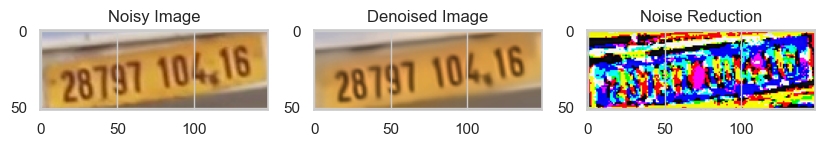

Denoised image saved: denoised_images\0981.jpg_cropped_plate_1.jpg


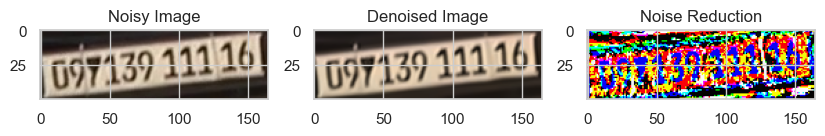

Denoised image saved: denoised_images\0981.jpg_cropped_plate_2.jpg


In [358]:
# Function to denoise an image using non-local means denoising
def denoise_image(image):
    return cv2.fastNlMeansDenoisingColored(image, None, 10, 10, 7, 21)

# Create a folder to save denoised images
denoised_folder = "denoised_images"
os.makedirs(denoised_folder, exist_ok=True)

# Display and denoise up to 10 noisy images from the "noisy_images" folder
for index, row in noisy_images.iterrows():
    if index >= 10:
        break  # Exit the loop after processing 10 images

    noisy_image_path = os.path.join(noisy_folder, row['cropped_plate_path'])
    noisy_image = plt.imread(noisy_image_path)

    # Denoise the noisy image
    denoised_image = denoise_image(noisy_image)

    # Create a new figure for each image
    plt.figure(figsize=(10, 5))

    # Display original noisy image, denoised image, and noise reduction
    plt.subplot(1, 3, 1)
    plt.imshow(noisy_image)
    plt.title("Noisy Image")

    plt.subplot(1, 3, 2)
    plt.imshow(denoised_image)
    plt.title("Denoised Image")

    plt.subplot(1, 3, 3)
    plt.imshow(noisy_image - denoised_image)
    plt.title("Noise Reduction")

    plt.show()

    # Save the denoised image with the same name as the original noisy image
    denoised_image_path = os.path.join(denoised_folder, os.path.basename(noisy_image_path))
    plt.imsave(denoised_image_path, denoised_image)
    print(f"Denoised image saved: {denoised_image_path}")

##### Gaussian Blur:

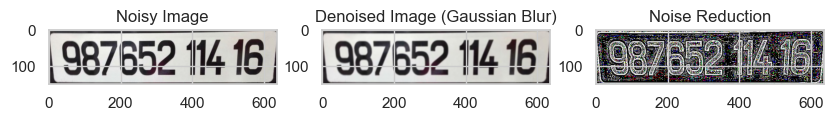

Denoised image with Gaussian blur saved: denoised_images_gaussian\0.jpg_cropped_plate_1.jpg


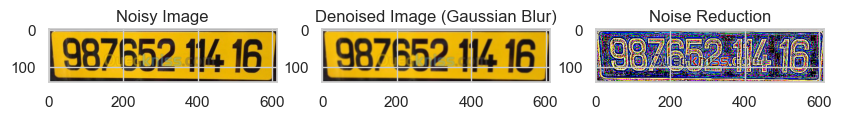

Denoised image with Gaussian blur saved: denoised_images_gaussian\0.jpg_cropped_plate_2.jpg


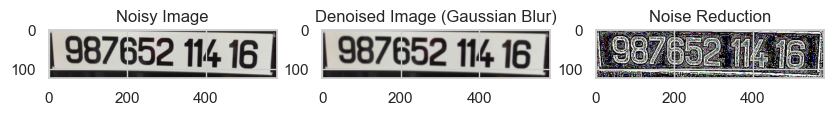

Denoised image with Gaussian blur saved: denoised_images_gaussian\0.jpg_cropped_plate_3.jpg


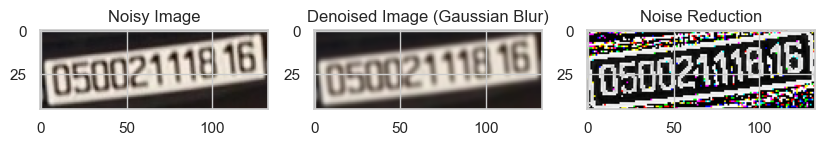

Denoised image with Gaussian blur saved: denoised_images_gaussian\0220.jpg_cropped_plate_1.jpg


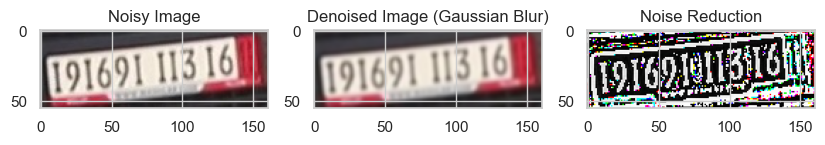

Denoised image with Gaussian blur saved: denoised_images_gaussian\0297.jpg_cropped_plate_1.jpg


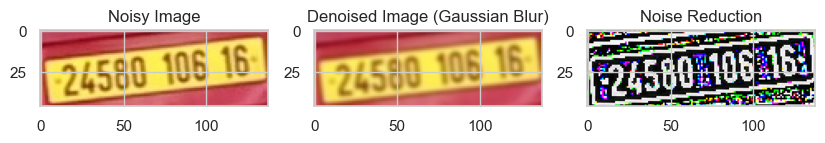

Denoised image with Gaussian blur saved: denoised_images_gaussian\0511.jpg_cropped_plate_1.jpg


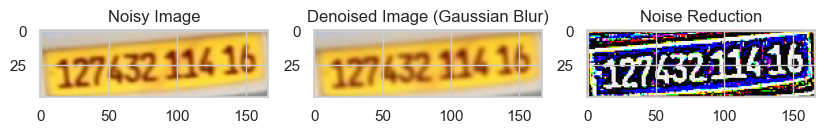

Denoised image with Gaussian blur saved: denoised_images_gaussian\0560.jpg_cropped_plate_1.jpg


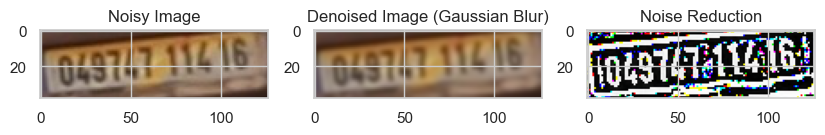

Denoised image with Gaussian blur saved: denoised_images_gaussian\0807.jpg_cropped_plate_1.jpg


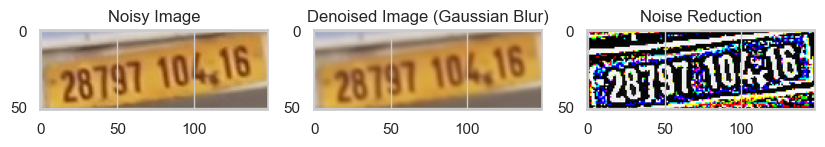

Denoised image with Gaussian blur saved: denoised_images_gaussian\0981.jpg_cropped_plate_1.jpg


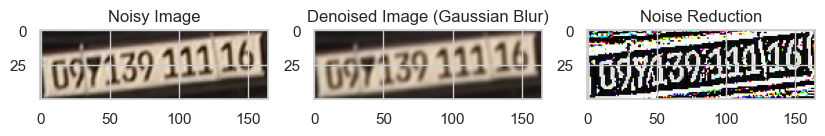

Denoised image with Gaussian blur saved: denoised_images_gaussian\0981.jpg_cropped_plate_2.jpg


In [359]:
# Function to apply Gaussian Blur for denoising
def denoise_image_gaussian(image, kernel_size=(5, 5), sigma_x=0):
    return cv2.GaussianBlur(image, kernel_size, sigma_x)

# Create a folder to save denoised images with Gaussian blur
denoised_gaussian_folder = "denoised_images_gaussian"
os.makedirs(denoised_gaussian_folder, exist_ok=True)

# Display and denoise up to 10 noisy images with Gaussian blur from the "noisy_images" folder
for index, row in noisy_images.iterrows():
    if index >= 10:
        break  # Exit the loop after processing 10 images

    noisy_image_path = os.path.join(noisy_folder, row['cropped_plate_path'])
    noisy_image = plt.imread(noisy_image_path)

    # Denoise the noisy image with Gaussian blur
    denoised_image_gaussian = denoise_image_gaussian(noisy_image, kernel_size=(5, 5), sigma_x=0)

    # Create a new figure for each image
    plt.figure(figsize=(10, 5))

    # Display original noisy image, denoised image with Gaussian blur, and noise reduction
    plt.subplot(1, 3, 1)
    plt.imshow(noisy_image)
    plt.title("Noisy Image")

    plt.subplot(1, 3, 2)
    plt.imshow(denoised_image_gaussian)
    plt.title("Denoised Image (Gaussian Blur)")

    plt.subplot(1, 3, 3)
    plt.imshow(noisy_image - denoised_image_gaussian)
    plt.title("Noise Reduction")

    plt.show()

    # Save the denoised image with Gaussian blur with the same name as the original noisy image
    denoised_gaussian_image_path = os.path.join(denoised_gaussian_folder, os.path.basename(noisy_image_path))
    plt.imsave(denoised_gaussian_image_path, denoised_image_gaussian)
    print(f"Denoised image with Gaussian blur saved: {denoised_gaussian_image_path}")

##### Thresholding:

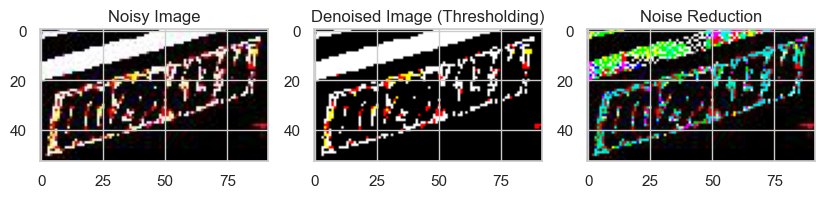

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\391.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\391.jpg_cropped_plate_1.jpg


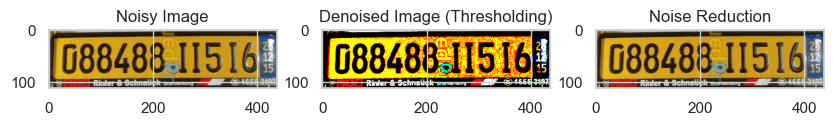

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\9.jpg_cropped_plate_3.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\9.jpg_cropped_plate_3.jpg


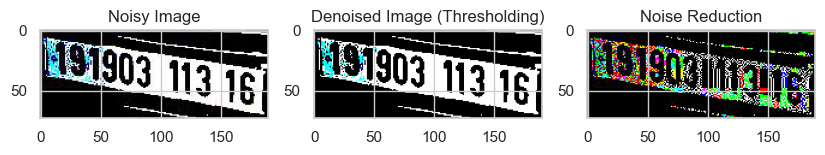

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\181.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\181.jpg_cropped_plate_1.jpg


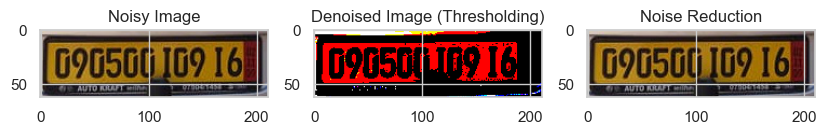

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\59687123_1119631821555334_8235236057889636352_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59687123_1119631821555334_8235236057889636352_n.jpg_cropped_plate_1.jpg


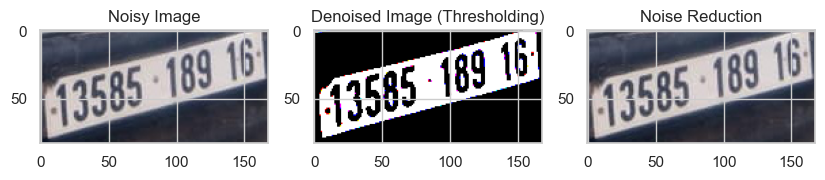

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\59144693_2245900405664094_7784864503035854848_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59144693_2245900405664094_7784864503035854848_n.jpg_cropped_plate_1.jpg


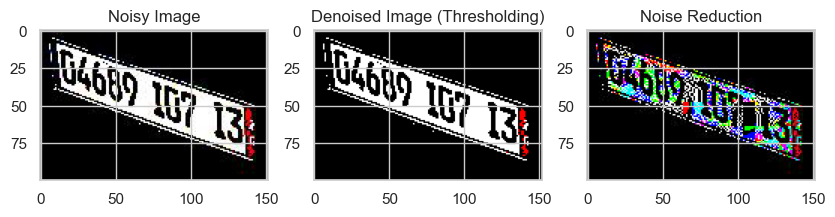

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\48908427_2213028049024097_6629180217766182912_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\48908427_2213028049024097_6629180217766182912_n.jpg_cropped_plate_1.jpg


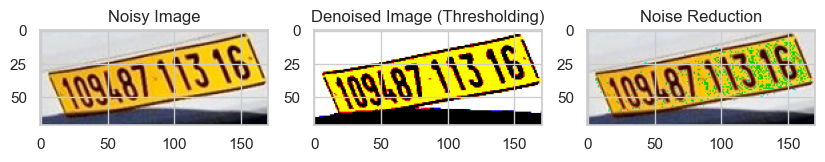

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\59429116_2186928918090498_4281131432518090752_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\59429116_2186928918090498_4281131432518090752_n.jpg_cropped_plate_1.jpg


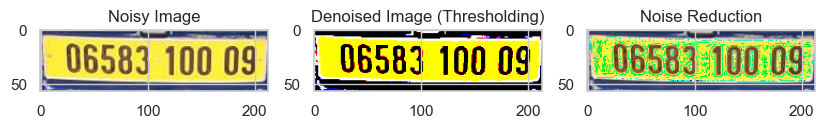

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\58986725_674564069613579_2987542572076892160_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\58986725_674564069613579_2987542572076892160_n.jpg_cropped_plate_1.jpg


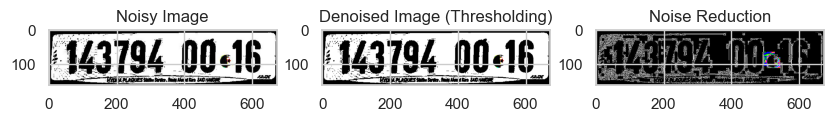

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\444444446.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\444444446.jpg_cropped_plate_1.jpg


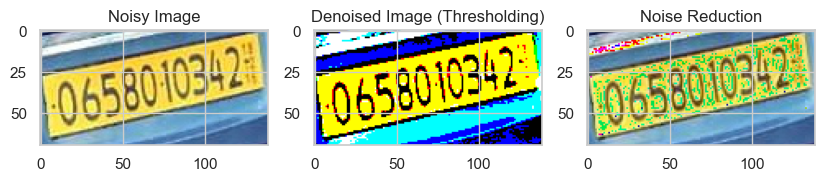

Denoised image with thresholding saved in the distinct folder: denoised_images_threshold\58430254_1122926327879146_1058281990433800192_n.jpg_cropped_plate_1.jpg
Denoised image with thresholding saved in the original folder: C:/Users/User/Downloads/License_Plates_of_Algeria_Dataset-master/License_Plates_of_Algeria_Dataset-master/Detector/cropped_car_plates\58430254_1122926327879146_1058281990433800192_n.jpg_cropped_plate_1.jpg


In [364]:
# Function to apply thresholding for denoising
def denoise_image_threshold(image, threshold_value=200, max_value=255, threshold_type=cv2.THRESH_BINARY):
    _, denoised_image = cv2.threshold(image, threshold_value, max_value, threshold_type)
    return denoised_image

# Create a folder to save denoised images with thresholding
denoised_threshold_folder = "denoised_images_threshold"
os.makedirs(denoised_threshold_folder, exist_ok=True)

# Display and denoise all noisy images with thresholding from the "noisy_images" folder
denoised_images_verification = noisy_images.sample(10)  # Randomly select 10 images for verification

for index, row in denoised_images_verification.iterrows():
    noisy_image_path = os.path.join(noisy_folder, row['cropped_plate_path'])
    noisy_image = plt.imread(noisy_image_path)

    # Denoise the noisy image with thresholding
    denoised_image_threshold = denoise_image_threshold(noisy_image, threshold_value=150, max_value=255, threshold_type=cv2.THRESH_BINARY)

    # Create a new figure for each image
    plt.figure(figsize=(10, 5))

    # Display original noisy image, denoised image with thresholding, and noise reduction
    plt.subplot(1, 3, 1)
    plt.imshow(noisy_image)
    plt.title("Noisy Image")

    plt.subplot(1, 3, 2)
    plt.imshow(denoised_image_threshold, cmap='gray')
    plt.title("Denoised Image (Thresholding)")

    plt.subplot(1, 3, 3)
    plt.imshow(noisy_image - denoised_image_threshold)
    plt.title("Noise Reduction")

    plt.show()

    # Save the denoised image with thresholding in the distinct folder
    denoised_threshold_image_path = os.path.join(denoised_threshold_folder, os.path.basename(noisy_image_path))
    plt.imsave(denoised_threshold_image_path, denoised_image_threshold, cmap='gray')
    print(f"Denoised image with thresholding saved in the distinct folder: {denoised_threshold_image_path}")

    # Save the denoised image with thresholding in the original folder under the same name
    original_denoised_image_path = os.path.join(original_folder, os.path.basename(noisy_image_path))
    plt.imsave(original_denoised_image_path, denoised_image_threshold, cmap='gray')
    print(f"Denoised image with thresholding saved in the original folder: {original_denoised_image_path}")

### Handling dark images

In [383]:
# Function to calculate image brightness
def calculate_brightness(image):
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    luminance = lab[:,:,0]
    brightness = cv2.mean(luminance)[0]
    return brightness

# Set threshold for darkness
threshold_brightness = 31.25

# Function to check for dark images and move them to a new folder
def move_and_delete_dark_images(folder_path, output_folder, num_images=10):
    dark_images = []
    for filename in os.listdir(folder_path):
        if filename.endswith(('.jpg', '.jpeg', '.png')):  
            image_path = os.path.join(folder_path, filename)
            img = cv2.imread(image_path)
            brightness = calculate_brightness(img)
            if brightness < threshold_brightness:
                dark_images.append({'image_path': image_path, 'brightness': brightness})

    # Move 10 random dark images to the output folder
    selected_dark_images = random.sample(dark_images, min(num_images, len(dark_images)))
    for dark_image in selected_dark_images:
        img = cv2.imread(dark_image['image_path'])
        
        # Get the base filename
        base_filename = os.path.basename(dark_image['image_path'])
        
        # Create the output path in the new folder
        output_path = os.path.join(output_folder, base_filename)
        
        # Move the dark image to the new folder
        shutil.move(dark_image['image_path'], output_path)

        print(f"Moved dark image to: {output_path}")

        # Delete the dark image from the original folder
        os.remove(dark_image['image_path'])
        print(f"Deleted dark image from: {dark_image['image_path']}")

    # Print the total number of dark images
    total_dark_images = len(dark_images)
    print(f"Total Dark Images: {total_dark_images}")

# Specify the path to the images folder
images_folder_path = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\cropped_car_plates"

# Specify the output folder for dark images
output_folder_path = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\darked_cropped_car_plates"

# Create the output folder if it doesn't exist
os.makedirs(output_folder_path, exist_ok=True)

# Move and delete dark images, and print the total count
move_and_delete_dark_images(images_folder_path, output_folder_path)

Moved dark image to: C:\Users\User\Downloads\License_Plates_of_Algeria_Dataset-master\License_Plates_of_Algeria_Dataset-master\Detector\darked_cropped_car_plates\52828023_403506580411300_7472791178581114880_n.jpg_cropped_plate_1.jpg


FileNotFoundError: [WinError 2] The system cannot find the file specified: 'C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\cropped_car_plates\\52828023_403506580411300_7472791178581114880_n.jpg_cropped_plate_1.jpg'

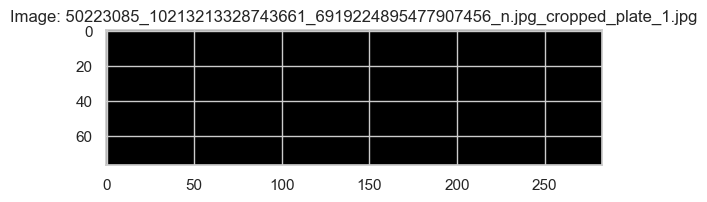

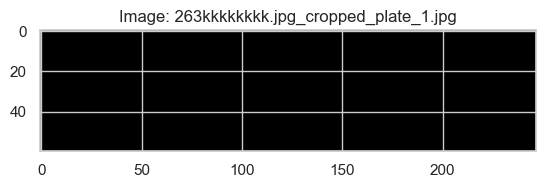

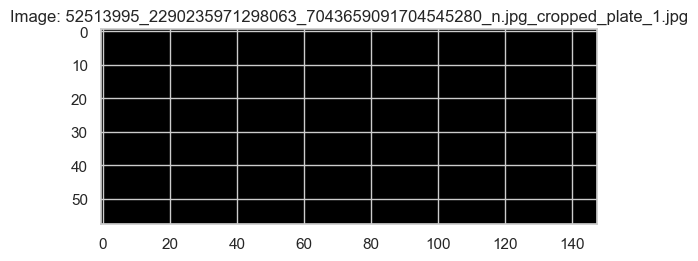

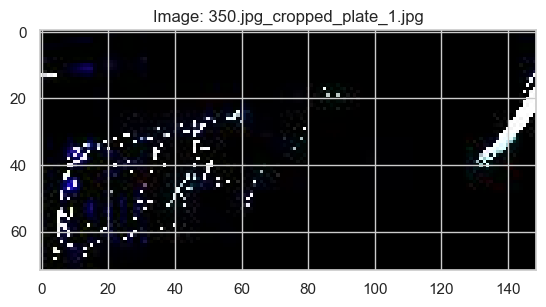

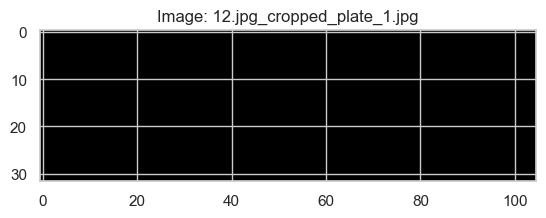

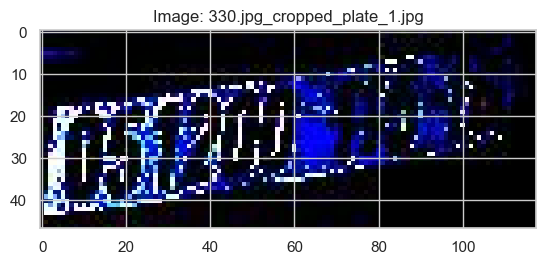

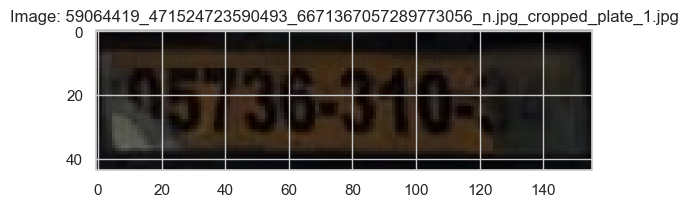

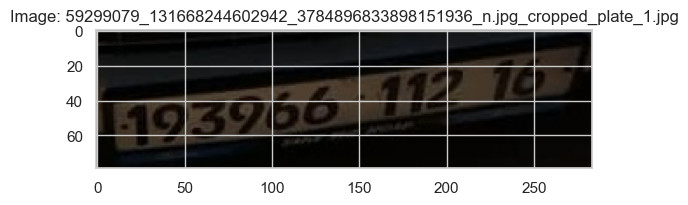

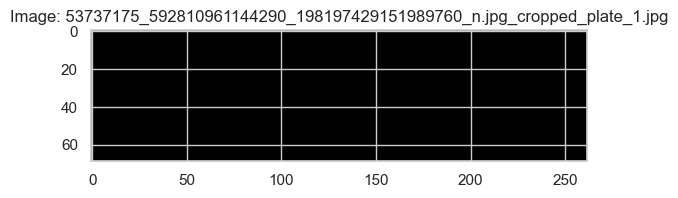

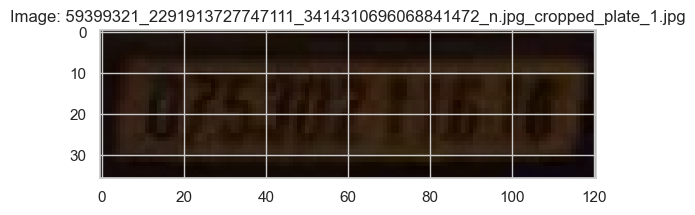

In [382]:
# Function to display dark images for verification
def display_dark_images_verification(folder_path, num_images=10):
    dark_images = random.sample(os.listdir(folder_path), min(num_images, len(os.listdir(folder_path))))
    for dark_image in dark_images:
        img = cv2.imread(os.path.join(folder_path, dark_image))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Image: {dark_image}")
        plt.show()

# Display 10 dark images for verification
display_dark_images_verification(output_folder_path, num_images=10)

Now we pass for more preprocessing techniques:

### Resizing images

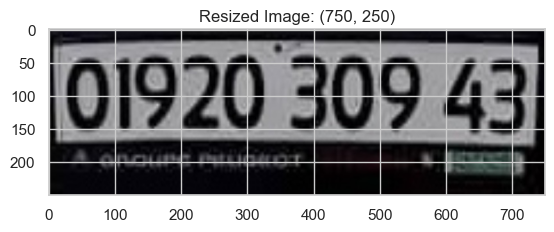

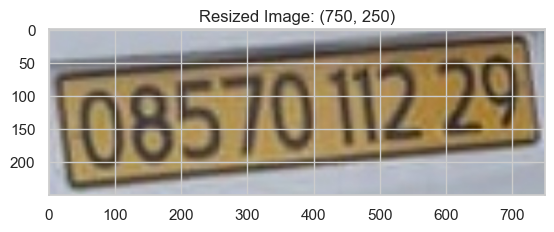

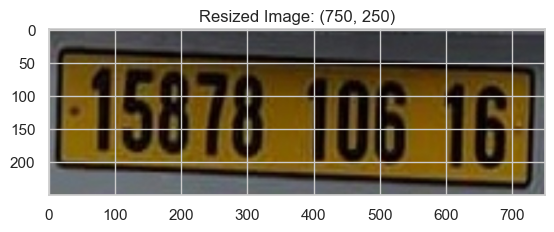

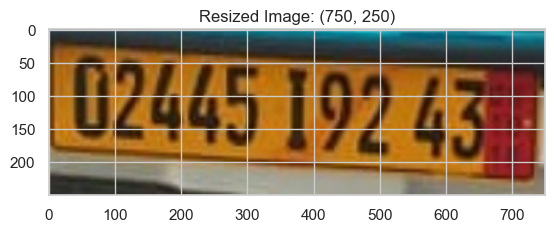

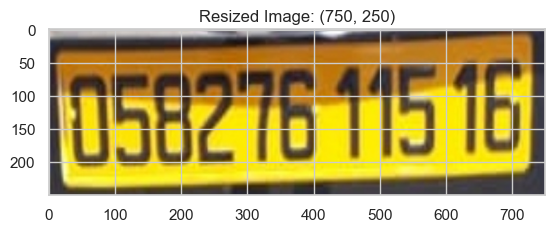

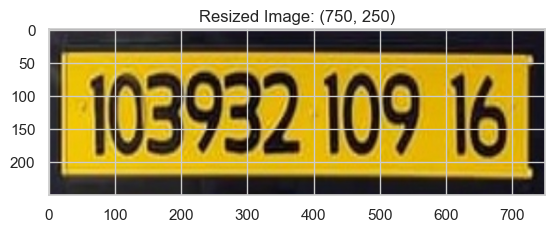

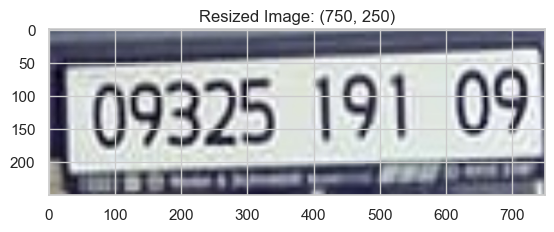

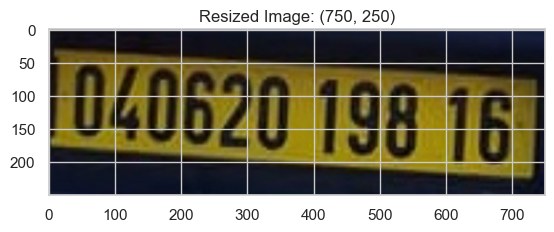

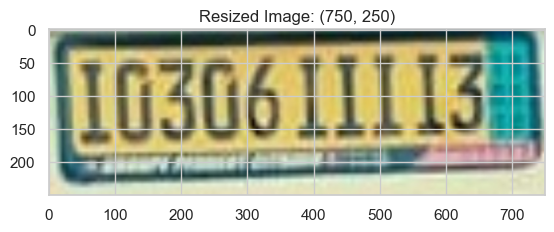

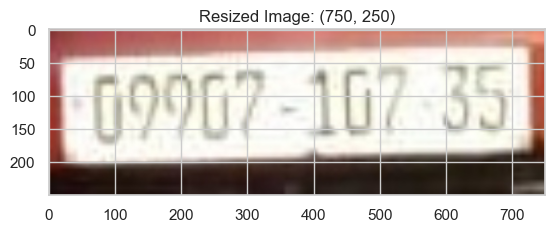

In [395]:
# Function to resize all images and save them in a new folder
def resize_all_images(input_folder, output_folder, target_size=(750, 250)):
    os.makedirs(output_folder, exist_ok=True)

    # Get a list of image filenames
    image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    for filename in image_filenames:
        image_path = os.path.join(input_folder, filename)
        img = cv2.imread(image_path)
        
        # Resize the image
        resized_img = cv2.resize(img, target_size)

        # Save the resized image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, resized_img)

    # Display 10 resized images for verification
    sample_images = random.sample(image_filenames, min(10, len(image_filenames)))
    for filename in sample_images:
        image_path = os.path.join(output_folder, filename)
        resized_img = cv2.imread(image_path)

        # Display the resized image
        plt.imshow(cv2.cvtColor(resized_img, cv2.COLOR_BGR2RGB))
        plt.title(f"Resized Image: {target_size}")
        plt.show()

# Specify the path to the original images folder
original_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\cropped_car_plates"

# Specify the output folder for resized images
resized_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\resized_cropped_car_plates"

# Resize all images and display 10 for verification
resize_all_images(original_images_folder, resized_images_folder, target_size=(750, 250))

### GrayScale images

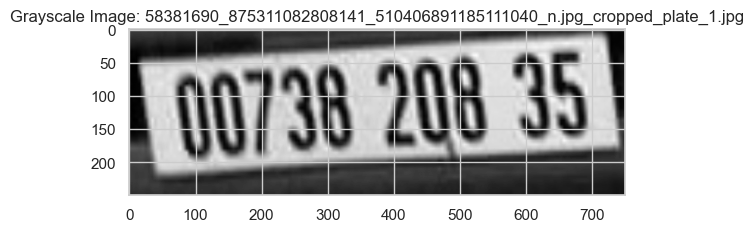

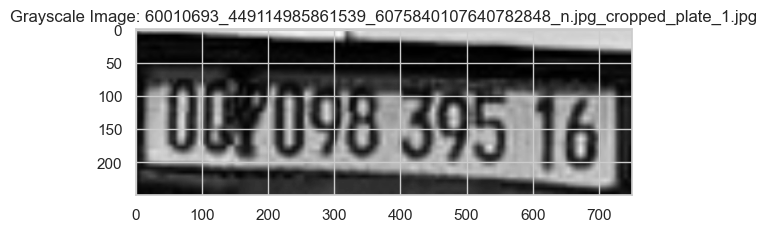

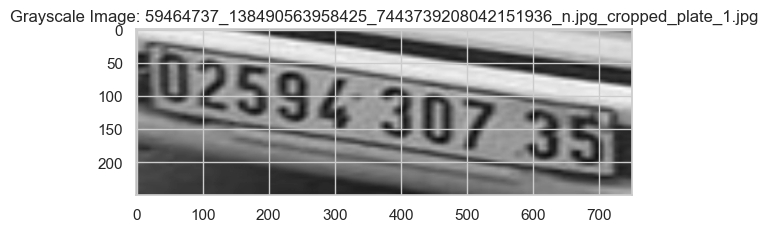

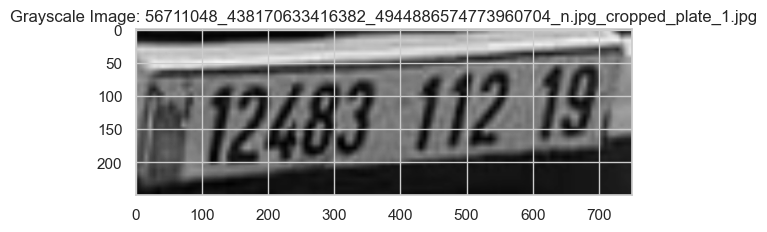

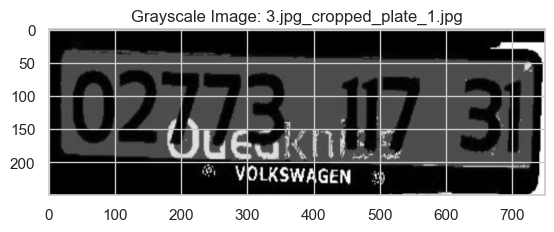

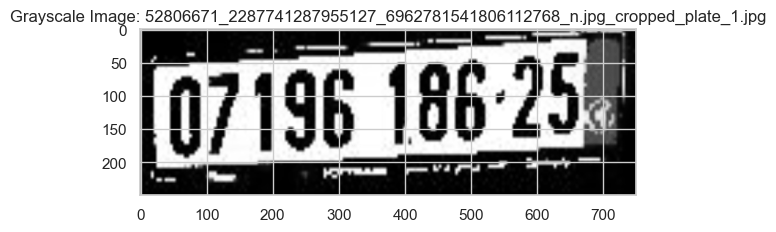

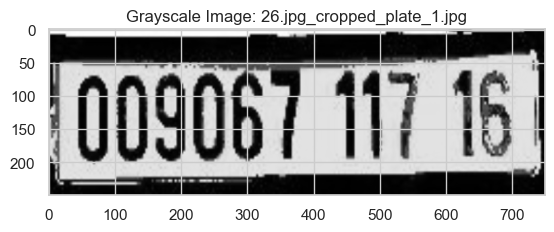

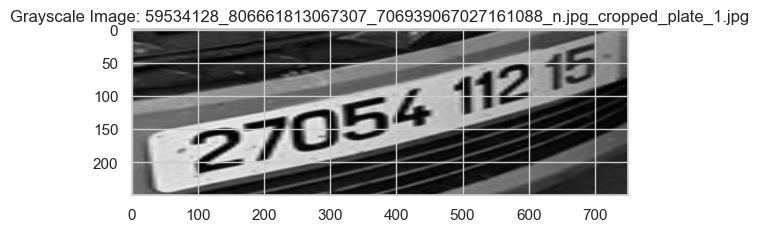

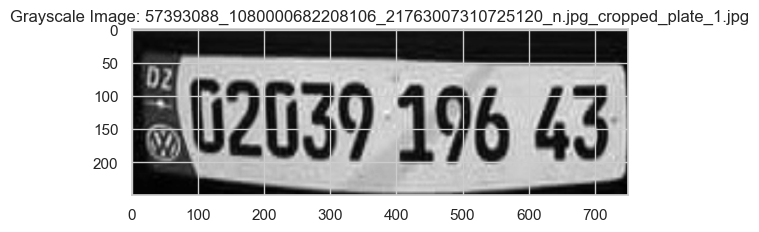

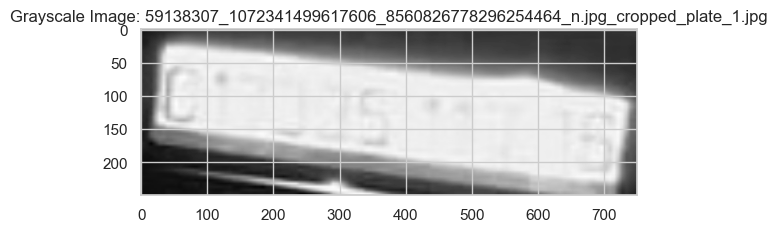

In [396]:
# Function to convert resized images to grayscale and save them in a new folder
def convert_resized_to_gray(input_folder, output_folder, num_samples=10):
    os.makedirs(output_folder, exist_ok=True)

    # Get a list of resized image filenames
    resized_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of resized images
    sample_images = random.sample(resized_image_filenames, min(num_samples, len(resized_image_filenames)))

    for filename in sample_images:
        resized_image_path = os.path.join(input_folder, filename)
        resized_img = cv2.imread(resized_image_path)

        # Convert the resized image to grayscale
        gray_img = cv2.cvtColor(resized_img, cv2.COLOR_BGR2GRAY)

        # Save the grayscale image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, gray_img)

        # Display the grayscale image
        plt.imshow(gray_img, cmap='gray')
        plt.title(f"Grayscale Image: {filename}")
        plt.show()

# Specify the path to the resized images folder
resized_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\resized_cropped_car_plates"

# Specify the output folder for grayscale images
gray_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\gray_resized_cropped_car_plates"

# Convert to grayscale and display 10 for verification
convert_resized_to_gray(resized_images_folder, gray_images_folder, num_samples=10)


### Binary images

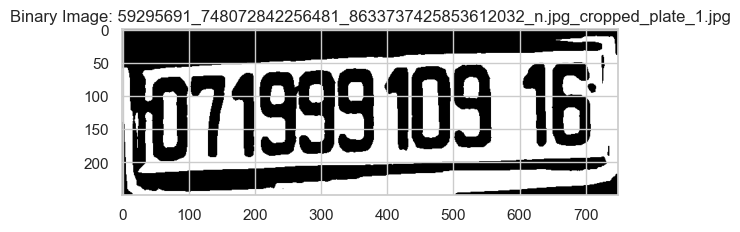

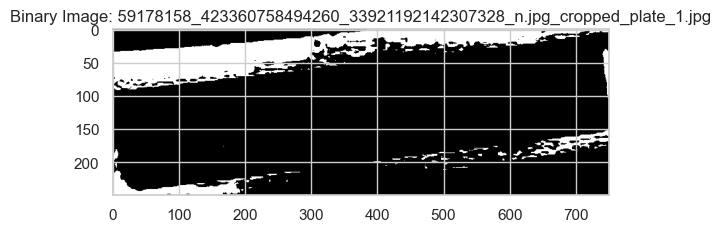

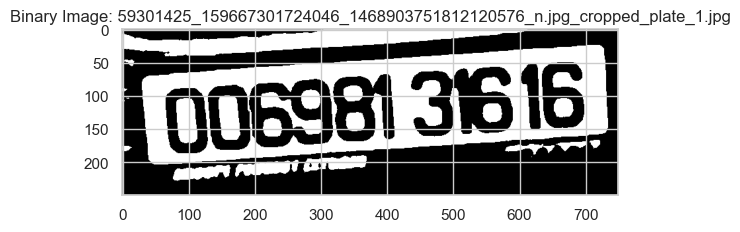

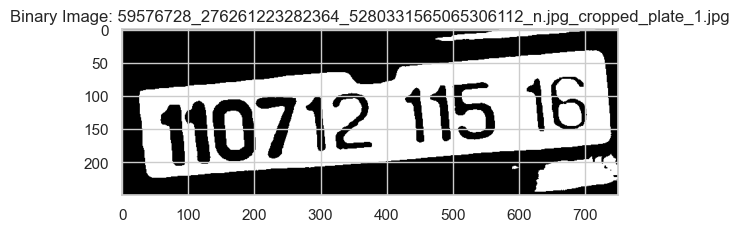

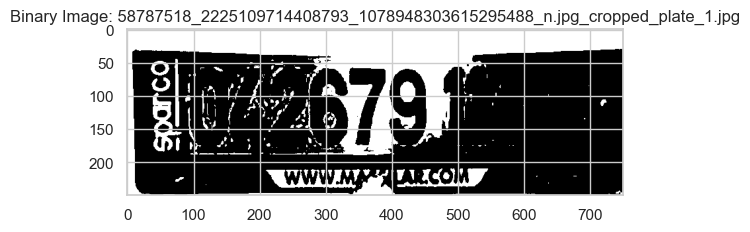

In [403]:
# Function to convert grayscale images to binary and save them in a new folder
def convert_gray_to_binary(input_folder, output_folder, threshold=127, num_samples=10):
    os.makedirs(output_folder, exist_ok=True)

    # Get a list of grayscale image filenames
    gray_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of grayscale images
    sample_images = random.sample(gray_image_filenames, min(num_samples, len(gray_image_filenames)))

    for filename in sample_images:
        gray_image_path = os.path.join(input_folder, filename)
        gray_img = cv2.imread(gray_image_path, cv2.IMREAD_GRAYSCALE)

        # Apply binary thresholding
        _, binary_img = cv2.threshold(gray_img, threshold, 255, cv2.THRESH_BINARY)

        # Save the binary image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, binary_img)

        # Display the binary image
        plt.imshow(binary_img, cmap='gray')
        plt.title(f"Binary Image: {filename}")
        plt.show()

# Specify the path to the grayscale images folder
gray_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\gray_resized_cropped_car_plates"

# Specify the output folder for binary images
binary_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\binary_gray_resized_cropped_car_plates"

# Convert to binary and display 5 for verification
convert_gray_to_binary(gray_images_folder, binary_images_folder, threshold=127, num_samples=5)

### Edge detection

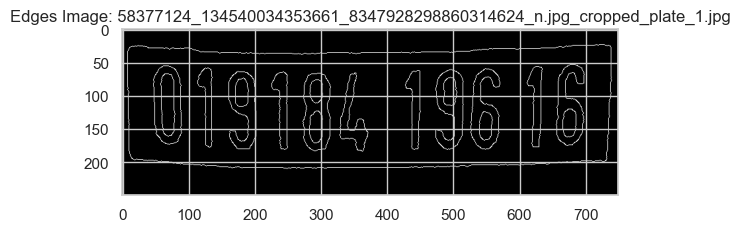

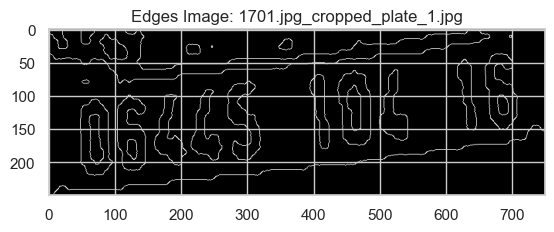

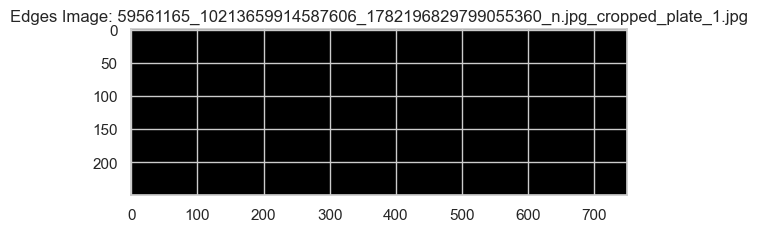

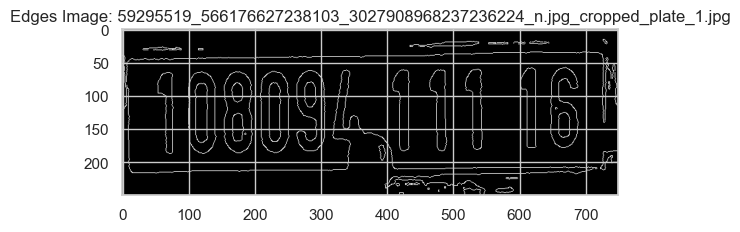

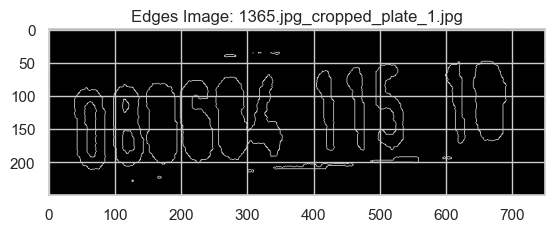

In [404]:
# Function to perform edge detection on binary images and save them in a new folder
def edge_detection_on_binary(input_folder, output_folder, num_samples=5):
    os.makedirs(output_folder, exist_ok=True)

    # Get a list of binary image filenames
    binary_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of binary images
    sample_images = random.sample(binary_image_filenames, min(num_samples, len(binary_image_filenames)))

    for filename in sample_images:
        binary_image_path = os.path.join(input_folder, filename)
        binary_img = cv2.imread(binary_image_path, cv2.IMREAD_GRAYSCALE)

        # Perform edge detection using Canny
        edges_img = cv2.Canny(binary_img, 100, 200)

        # Save the edges image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, edges_img)

        # Display the edges image
        plt.imshow(edges_img, cmap='gray')
        plt.title(f"Edges Image: {filename}")
        plt.show()

# Specify the path to the binary images folder
binary_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\binary_gray_resized_cropped_car_plates"

# Specify the output folder for edges images
edges_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\edges_binary_gray_resized_cropped_car_plates"

# Perform edge detection on binary images and display 5 for verification
edge_detection_on_binary(binary_images_folder, edges_images_folder, num_samples=5)

### Segmentation

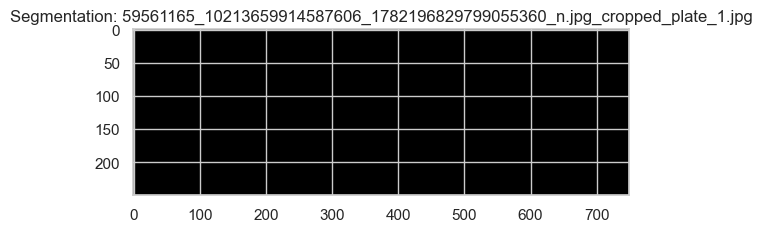

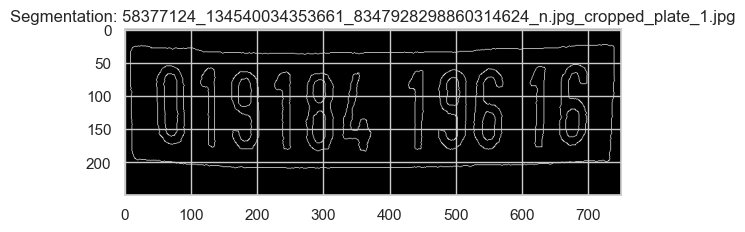

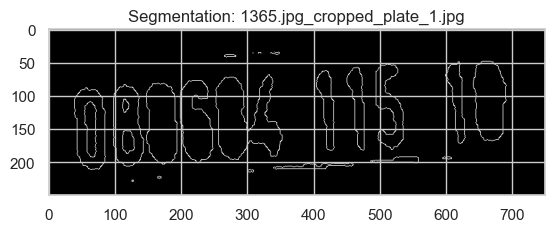

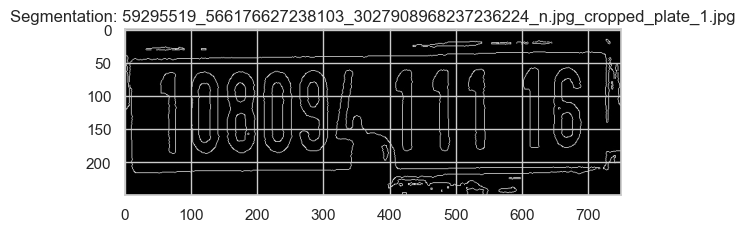

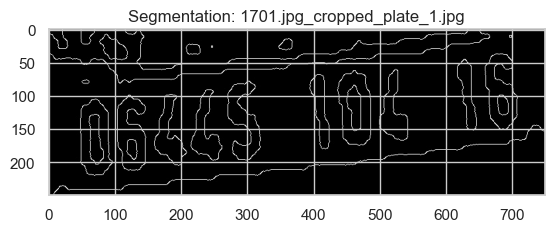

In [418]:
# Function to perform segmentation on edge-detected images and save segmented images
def segmentation_on_edges_images(input_folder, output_folder, num_samples=5):
    os.makedirs(output_folder, exist_ok=True)

    # Get a list of edge-detected image filenames
    edges_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of edge-detected images
    sample_images = random.sample(edges_image_filenames, min(num_samples, len(edges_image_filenames)))

    for filename in sample_images:
        edges_image_path = os.path.join(input_folder, filename)
        edges_img = cv2.imread(edges_image_path, cv2.IMREAD_GRAYSCALE)

        # Find contours in the image
        contours, _ = cv2.findContours(edges_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Create a mask for the segmented image
        mask = np.zeros_like(edges_img)

        # Draw contours on the mask
        cv2.drawContours(mask, contours, -1, (255), thickness=cv2.FILLED)

        # Apply the mask to the original image
        segmented_img = cv2.bitwise_and(edges_img, edges_img, mask=mask)

        # Save the segmented image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, segmented_img)

        # Display the segmented image
        plt.imshow(segmented_img, cmap='gray')
        plt.title(f"Segmentation: {filename}")
        plt.show()

# Specify the path to the edge-detected images folder
edges_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\edges_binary_gray_resized_cropped_car_plates"

# Specify the output folder for segmented images
segmented_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\segmented_edges_binary_gray_resized_cropped_car_plates"

# Perform segmentation on edge-detected images and display 5 for verification
segmentation_on_edges_images(edges_images_folder, segmented_images_folder, num_samples=5)

## Feature Engineering and Selection 

## Preprocessing Pipeline

## Data Normalization and Transformation

## Data Integration and Reduction

## Data Augmentation

## ML

Filename: 58781452_443834873029254_6066982025355591680_n.jpg_cropped_plate_1.jpg, Recognized Text: 07442 383 10


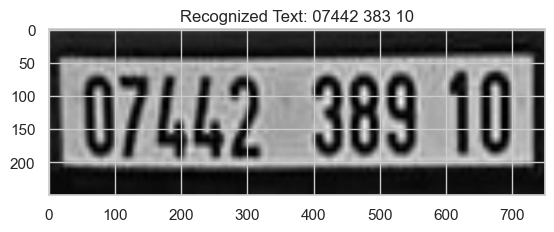

Filename: 58755200_1182504168577096_8128575286737371136_n.jpg_cropped_plate_1.jpg, Recognized Text: [-WW-059-Shi


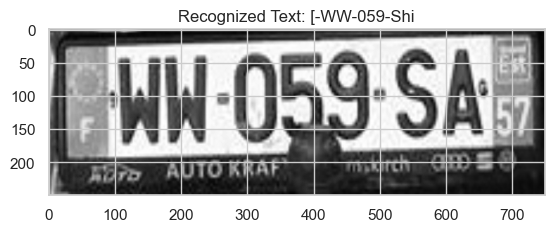

Filename: 58616623_2388772478078764_4650054911197708288_n.jpg_cropped_plate_1.jpg, Recognized Text: 2v061 111 16


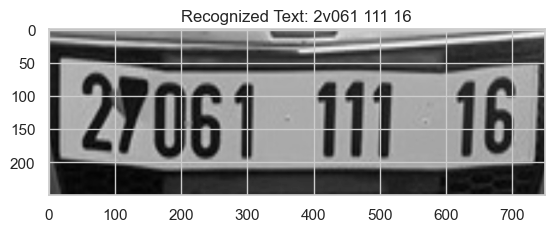

Filename: 59129575_1187543508092290_406643908697653248_n.jpg_cropped_plate_1.jpg, Recognized Text: 6959 192 19.


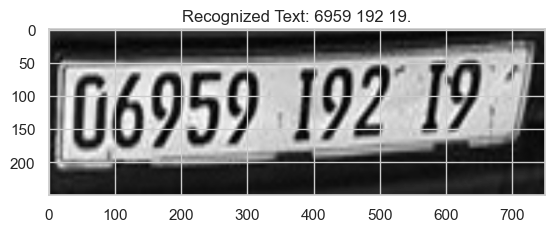

Filename: 59087090_675998189527738_6754277264885547008_n.jpg_cropped_plate_1.jpg, Recognized Text: (0069 108 16


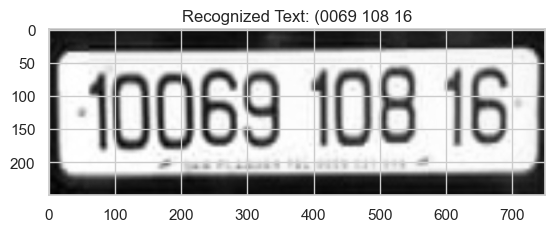

Filename: 59546602_2297807686947173_6494576913372151808_n.jpg_cropped_plate_1.jpg, Recognized Text: 185200112 16],


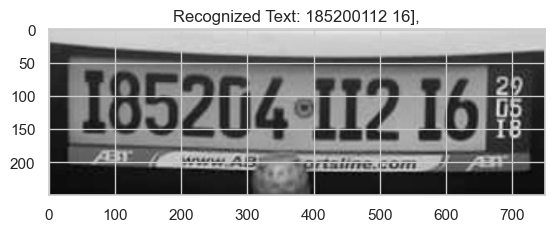

Filename: 444444446.jpg_cropped_plate_1.jpg, Recognized Text: 143794 00616.


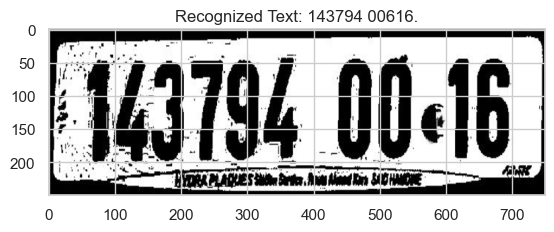

Filename: 58rrrr.jpg_cropped_plate_1.jpg, Recognized Text: wise


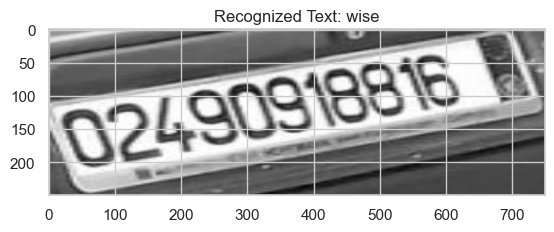

Filename: 153.jpg_cropped_plate_1.jpg, Recognized Text: VISA ati


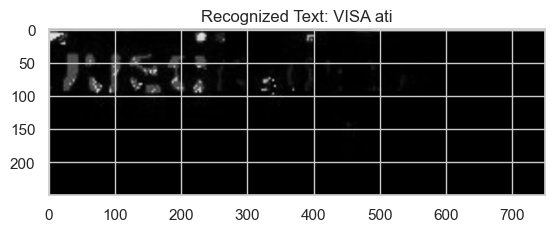

Filename: 59244096_865078223840899_7148326894952251392_n.jpg_cropped_plate_1.jpg, Recognized Text: 08570 11229


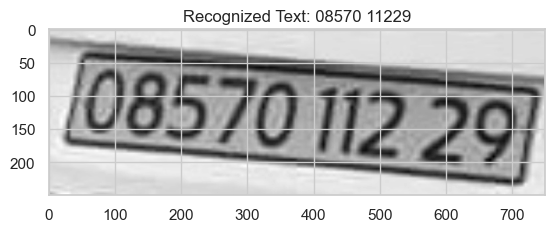

In [416]:
# Specify the path to the folder
resized_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\resized_cropped_car_plates"

# Function to apply Tesseract OCR on resized car plates
def apply_ocr_on_resized_images(input_folder, num_images=10):
    # Get a list of resized image filenames
    resized_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of resized images
    selected_images = random.sample(resized_image_filenames, min(num_images, len(resized_image_filenames)))

    for filename in selected_images:
        resized_image_path = os.path.join(input_folder, filename)
        resized_img = cv2.imread(resized_image_path, cv2.IMREAD_GRAYSCALE)

        # Use pytesseract to perform OCR on the resized image
        text = pytesseract.image_to_string(resized_img, config='--psm 10', output_type=Output.STRING)

        # Print the recognized text
        print(f"Filename: {filename}, Recognized Text: {text.strip()}")

        # Display the resized image with recognized text
        plt.imshow(resized_img, cmap='gray')
        plt.title(f"Recognized Text: {text.strip()}")
        plt.show()

# Apply Tesseract OCR on randomly selected resized car plates and display the results
apply_ocr_on_resized_images(resized_images_folder, num_images=10)

Filename: 60010693_449114985861539_6075840107640782848_n.jpg_cropped_plate_1.jpg, Recognized Text: TORUS 305 16


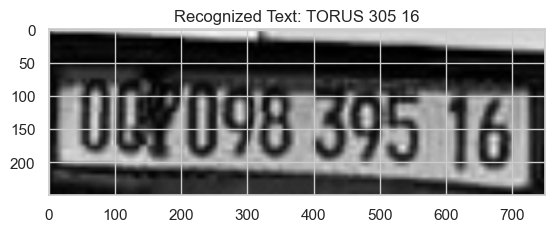

Filename: 57393088_1080000682208106_21763007310725120_n.jpg_cropped_plate_1.jpg, Recognized Text: F 02039 196 43


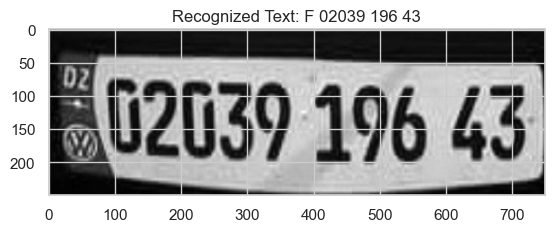

Filename: 59534128_806661813067307_706939067027161088_n.jpg_cropped_plate_1.jpg, Recognized Text: ae


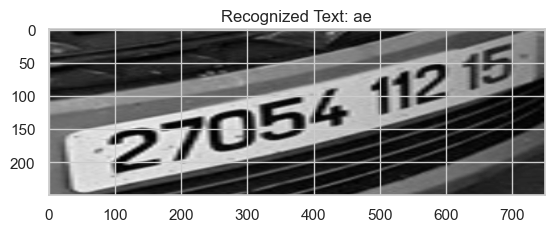

Filename: 1701.jpg_cropped_plate_1.jpg, Recognized Text: ‘pgues 10418,


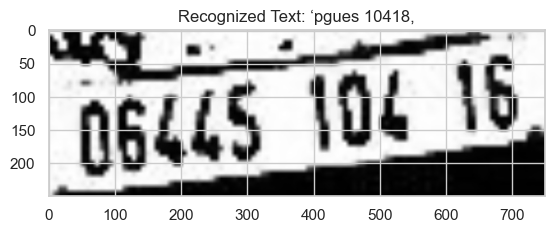

Filename: 56711048_438170633416382_4944886574773960704_n.jpg_cropped_plate_1.jpg, Recognized Text: p26 112 13,


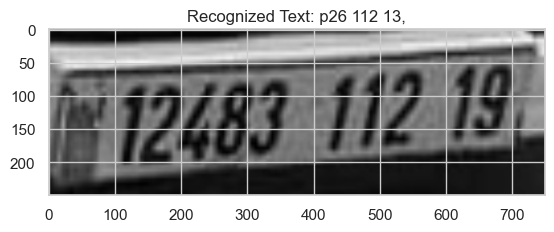

Filename: 59729548_125305681989088_4138788725905686528_n.jpg_cropped_plate_1.jpg, Recognized Text: 098562 110 16


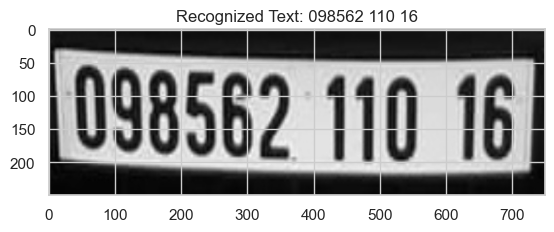

Filename: 59435576_603722076798598_8008070955521802240_n.jpg_cropped_plate_1.jpg, Recognized Text: [071885 117 16


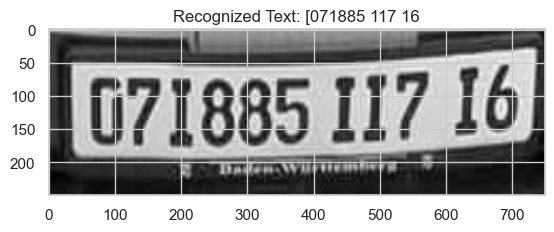

Filename: 59295691_748072842256481_8633737425853612032_n.jpg_cropped_plate_1.jpg, Recognized Text: 1071999109 16


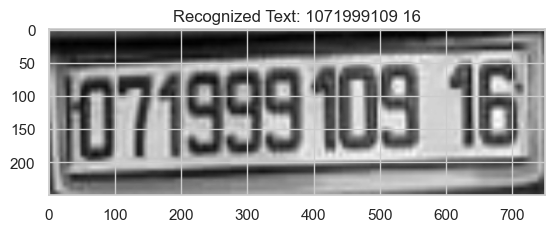

Filename: Photo4.jpg_cropped_plate_1.jpg, Recognized Text: 128960 103 23


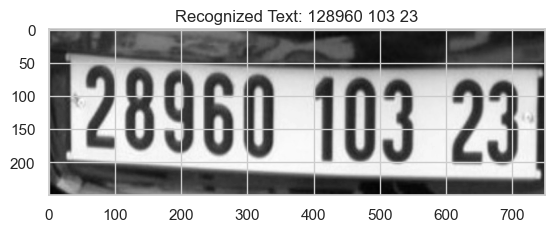

Filename: 1365.jpg_cropped_plate_1.jpg, Recognized Text: pees 115 10


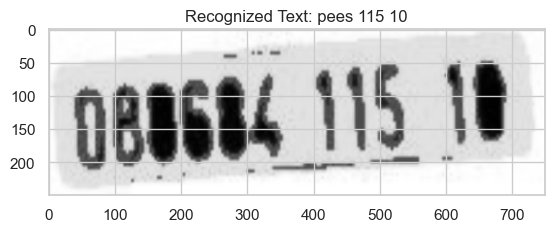

In [415]:
# Specify the path to the folder
gray_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\gray_resized_cropped_car_plates"

# Function to apply Tesseract OCR on grayscale car plates
def apply_ocr_on_gray_images(input_folder, num_images=10):
    # Get a list of grayscale image filenames
    gray_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of grayscale images
    selected_images = random.sample(gray_image_filenames, min(num_images, len(gray_image_filenames)))

    for filename in selected_images:
        gray_image_path = os.path.join(input_folder, filename)
        gray_img = cv2.imread(gray_image_path, cv2.IMREAD_GRAYSCALE)

        # Use pytesseract to perform OCR on the grayscale image
        text = pytesseract.image_to_string(gray_img, config='--psm 10', output_type=Output.STRING)

        # Print the recognized text
        print(f"Filename: {filename}, Recognized Text: {text.strip()}")

        # Display the grayscale image with recognized text
        plt.imshow(gray_img, cmap='gray')
        plt.title(f"Recognized Text: {text.strip()}")
        plt.show()

# Apply Tesseract OCR on randomly selected grayscale car plates and display the results
apply_ocr_on_gray_images(gray_images_folder, num_images=10)

Filename: 58444886_2151969071551338_3229551579635908608_n.jpg_cropped_plate_1.jpg, Recognized Text: aa


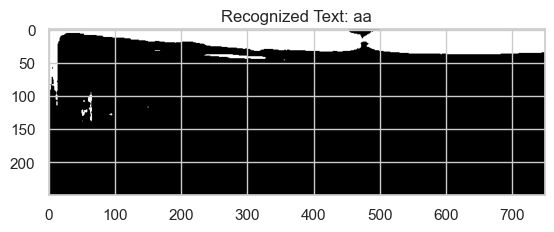

Filename: 1365.jpg_cropped_plate_1.jpg, Recognized Text: ggeces 115 1


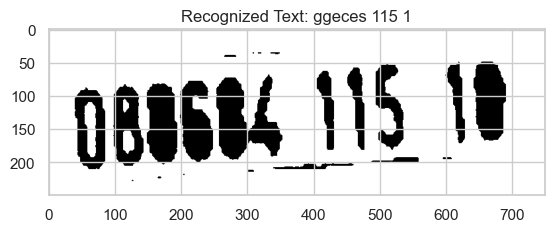

Filename: 58933290_287061095560497_4614166465120043008_n.jpg_cropped_plate_1.jpg, Recognized Text: Y-06562-196 08.)


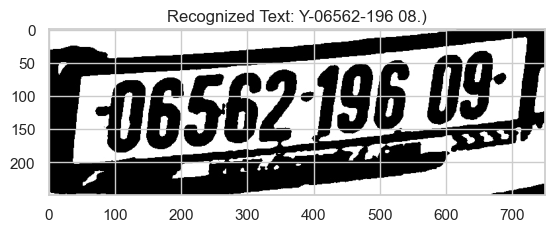

Filename: 58543196_130446048123602_1282149739034312704_n.jpg_cropped_plate_1.jpg, Recognized Text: Pogizt _ 18.16


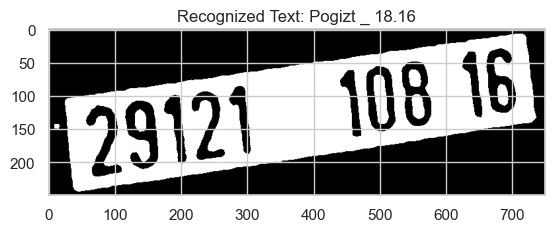

Filename: 58381690_875311082808141_510406891185111040_n.jpg_cropped_plate_1.jpg, Recognized Text: 00738 208 35


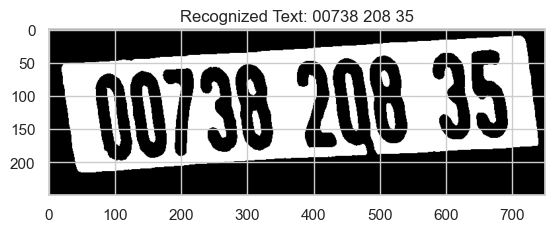

Filename: 58787518_2225109714408793_1078948303615295488_n.jpg_cropped_plate_1.jpg, Recognized Text: Eaaze7o am


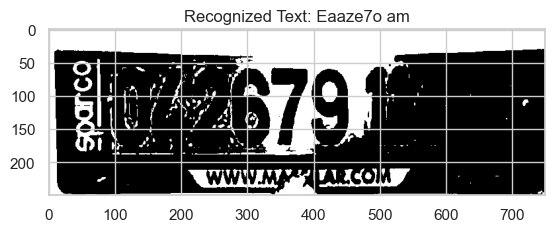

Filename: 59138307_1072341499617606_8560826778296254464_n.jpg_cropped_plate_1.jpg, Recognized Text: .


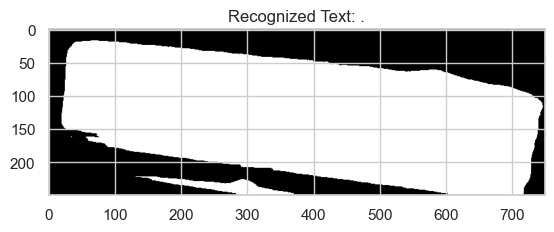

Filename: 57358071_414904692635835_337600144750936064_n.jpg_cropped_plate_1.jpg, Recognized Text: 07381 113 188


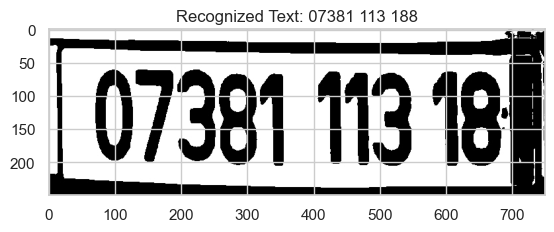

Filename: 59301425_159667301724046_1468903751812120576_n.jpg_cropped_plate_1.jpg, Recognized Text: | 006961 31616


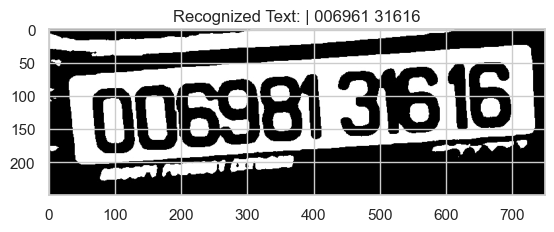

Filename: 59295519_566176627238103_3027908968237236224_n.jpg_cropped_plate_1.jpg, Recognized Text: 108094111 16"


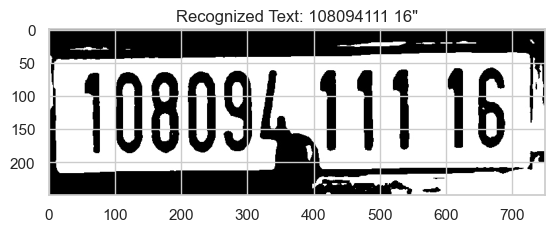

In [414]:
# Specify the path to the folder
binary_images_folder = "C:\\Users\\User\\Downloads\\License_Plates_of_Algeria_Dataset-master\\License_Plates_of_Algeria_Dataset-master\\Detector\\binary_gray_resized_cropped_car_plates"

# Function to apply Tesseract OCR on binary car plates
def apply_ocr_on_binary_images(input_folder, num_images=10):
    # Get a list of binary image filenames
    binary_image_filenames = [filename for filename in os.listdir(input_folder) if filename.endswith(('.jpg', '.jpeg', '.png'))]

    # Randomly select a subset of binary images
    selected_images = random.sample(binary_image_filenames, min(num_images, len(binary_image_filenames)))

    for filename in selected_images:
        binary_image_path = os.path.join(input_folder, filename)
        binary_img = cv2.imread(binary_image_path, cv2.IMREAD_GRAYSCALE)

        # Use pytesseract to perform OCR on the binary image
        text = pytesseract.image_to_string(binary_img, config='--psm 10', output_type=Output.STRING)

        # Print the recognized text
        print(f"Filename: {filename}, Recognized Text: {text.strip()}")

        # Display the binary image with recognized text
        plt.imshow(binary_img, cmap='gray')
        plt.title(f"Recognized Text: {text.strip()}")
        plt.show()

# Apply Tesseract OCR on randomly selected binary car plates and display the results
apply_ocr_on_binary_images(binary_images_folder, num_images=10)

## DL

## Conclusion 

## References